In [1]:
#MixtureProblem code
#Arshad Chowdhury
#Make it compatible for this pc and ubuntu
# This V4 version work for both Ubuntu and Windows, just uncomment the path. Will later make it work for CoLab
# This V5 version adds noise to data and helps process it. Also pltos the results to compare how predictions go
# This v6 version clears a lot of extra code from V5 and adds benchmark test mixtures
# This v7 version adds functions to run benchmark testsharry1 from V5 and adds benchmark test mixtures
# This v8 version fixes plot dpis and makes them consistent, Runs MSE vs MAE comparison cases and fixes noise profile
# This v9 version added model loading capability

# The v10 version combines GP and perceptrons. Removes a lot of unnecessary parts of the code and keeps only the bench_noise_add
# This v11 has synthetic mixtures

#V12 

#(Keep GP in the code but focus back on perceptron)

# add absorbance threshold = 0.001 for training mixtures and see performance with and without noise
#V13.

#Add pure component variational spectra for learning
#Add SNR=15 noisy spectra into training

In [2]:
%matplotlib inline  
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
from matplotlib.ticker import MaxNLocator
import numpy as np
from numpy import asarray
import pandas as pd

import seaborn as sns  #heat map
import glob # batch processing of images

import tensorflow as tf
import matplotlib as mpl
import matplotlib.font_manager as fm
# Collect all the font names available to matplotlib
font_names = [f.name for f in fm.fontManager.ttflist]
# print(font_names)

from scipy import signal


from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import DotProduct, WhiteKernel
from sklearn.gaussian_process.kernels import RBF

#Sklearn model saving and loading
from joblib import dump, load

# Framework Parameters

discard_rows=22
n_compounds=12
n_mixture_component_max = 12
Components = np.array([[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11,12]])
print('Components : ',Components)
print('Components shape : ',Components.shape)

# Is it running on linux?
linux = 1

Components :  [[ 0  1  2  3  4  5  6  7  8  9 10 11 12]]
Components shape :  (1, 13)


In [3]:
if linux == 1:
    #View files
    print("Linux")

    path = r'THz Mixture Basis/One Torr' 
    
    # Ubuntu


    filename = path + '/C2H5OH_JPL_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    df_C2H5OH=dfy


    # filename = path + '\CH3CHO_JPL_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'


    filename = path + '/CH3CHO_JPL_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'


    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    df_CH3CHO=dfy

    # filename = path + '\CH3CL_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    filename = path + '/CH3CL_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    df_CH3Cl=dfy

    # filename = path + '\CH3CN_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    filename = path + '/CH3CN_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    df_CH3CN=dfy

    # filename = path + '\CH3OH_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    filename = path + '/CH3OH_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    df_CH3OH=dfy

    # filename = path + '\H2CO_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    filename = path + '/H2CO_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    df_H2CO=dfy

    # filename = path + 'H2S_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    filename = path + '/H2S_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    df_H2S=dfy

    # filename = path + '\HCN_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    filename = path + '/HCN_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    df_HCN=dfy

    # filename = path + '\HCOOH_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    filename = path + '/HCOOH_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    df_HCOOH=dfy

    # filename = path + '\HNO3_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    filename = path + '/HNO3_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    df_HNO3=dfy

    # filename = path + '\OCS_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    filename = path + '/OCS_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    df_OCS=dfy

    # filename = path + '\SO2_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    filename = path + '/SO2_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    df_SO2=dfy

    
else:
        
    #View files

    path = r'F:\ML Code Training Data\THz Mixture Basis\One Torr' 

    # basis spectra

    filename = path + '\C2H5OH_JPL_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    # path = r'THz Mixture Basis/One Torr' 

    # filename = path + '/C2H5OH_JPL_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    df_C2H5OH=dfy


    filename = path + '\CH3CHO_JPL_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'


    # filename = path + 'CH3CHO_JPL_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'


    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    df_CH3CHO=dfy

    filename = path + '\CH3CL_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    # filename = path + 'CH3CL_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    df_CH3Cl=dfy

    filename = path + '\CH3CN_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    # filename = path + 'CH3CN_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    df_CH3CN=dfy

    filename = path + '\CH3OH_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    # filename = path + 'CH3OH_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    df_CH3OH=dfy

    filename = path + '\H2CO_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    # filename = path + 'H2CO_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    df_H2CO=dfy

    filename = path + '\H2S_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    # filename = path + 'H2S_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    df_H2S=dfy

    filename = path + '\HCN_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    # filename = path + 'HCN_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    df_HCN=dfy

    filename = path + '\HCOOH_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    # filename = path + 'HCOOH_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    df_HCOOH=dfy

    filename = path + '\HNO3_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    # filename = path + 'HNO3_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    df_HNO3=dfy

    filename = path + '\OCS_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    # filename = path + 'OCS_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    df_OCS=dfy

    filename = path + '\SO2_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    # filename = path + 'SO2_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    df_SO2=dfy
    
    print("Not linux")

    

all_files = glob.glob(path + "/*.csv")

li = []

print(path)

print('\n')
print(all_files)






Linux
THz Mixture Basis/One Torr


['THz Mixture Basis/One Torr/C2H5OH_JPL_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv', 'THz Mixture Basis/One Torr/CH3CL_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv', 'THz Mixture Basis/One Torr/CH3CHO_JPL_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv', 'THz Mixture Basis/One Torr/OCS_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv', 'THz Mixture Basis/One Torr/CH3CN_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv', 'THz Mixture Basis/One Torr/H2CO_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv', 'THz Mixture Basis/One Torr/SO2_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv', 'THz Mixture Basis/One Torr/HCOOH_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv', 'THz Mixture Basis/One Torr/CH3OH_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv', 'THz Mixture Basis/One Torr/HNO3_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv', 'THz Mixture Basis/One Torr/HCN_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv', 'THz Mixture Basis/One Torr

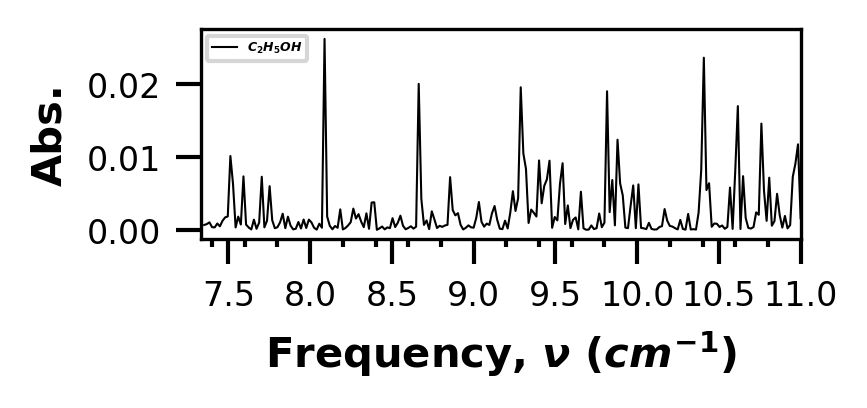

In [4]:
#plotting bases

fig = plt.figure(figsize=(2,0.7),dpi=300)
ax_C2H5OH = fig.add_axes([0, 0, 1, 1])

# ax_CO2 = fig.add_axes([0, 0.6, 1, 0.4])

plt.rc('font', weight='bold')
ax_C2H5OH.plot(dfx, df_C2H5OH, linewidth=0.5, color='black', label='$C_2H_5OH$')
ax_C2H5OH.legend(loc=2, prop={'size': 3})

# ax.plot(wavenumbers, X[25]/max(X[25]), linewidth=2, color=colors(1), label='Sample 2')
# Set the axis limits
ax_C2H5OH.set_xlim(7.33, 11)
# ax_C2H5OH.set_ylim(0, 1.0)

ax_C2H5OH.xaxis.set_tick_params(which='major', size=6, width=1, direction='out',labelsize=8)
ax_C2H5OH.xaxis.set_tick_params(which='minor', size=2, width=1, direction='out',labelsize=8)
# ax.tick_params(direction='out', length=6, width=2, colors='r',
#                grid_color='r', grid_alpha=0.2)

ax_C2H5OH.yaxis.set_tick_params(which='major', size=6, width=1, direction='out',labelsize=8)
ax_C2H5OH.yaxis.set_tick_params(which='minor', size=2, width=1, direction='out',labelsize=8)


ax_C2H5OH.xaxis.set_major_locator(mpl.ticker.MultipleLocator(0.5))
ax_C2H5OH.xaxis.set_minor_locator(mpl.ticker.MultipleLocator(0.2))
# ax_C2H5OH.yaxis.set_major_locator(mpl.ticker.MultipleLocator(0.01))
# ax_C2H5OH.yaxis.set_minor_locator(mpl.ticker.MultipleLocator(0.005))

# Add the x and y-axis labels
ax_C2H5OH.set_ylabel(r'Abs.', labelpad=4, fontsize='medium', fontweight='bold')
ax_C2H5OH.set_xlabel(r'Frequency, $\nu$ ($cm^{-1}$)', labelpad=4, fontsize='medium', fontweight='bold')
# ax_H2O.set_xlabel(r'Frequency, $\nu$ ($cm^{-1}$)', labelpad=4, fontsize='medium', fontweight='bold')

plt.show()
#fig.savefig('MasterNormalized\H2O.jpg', bbox_inches='tight')


In [5]:
# Number of features

n_features = len(dfx)

print('Number of features : ', n_features)

Number of features :  229


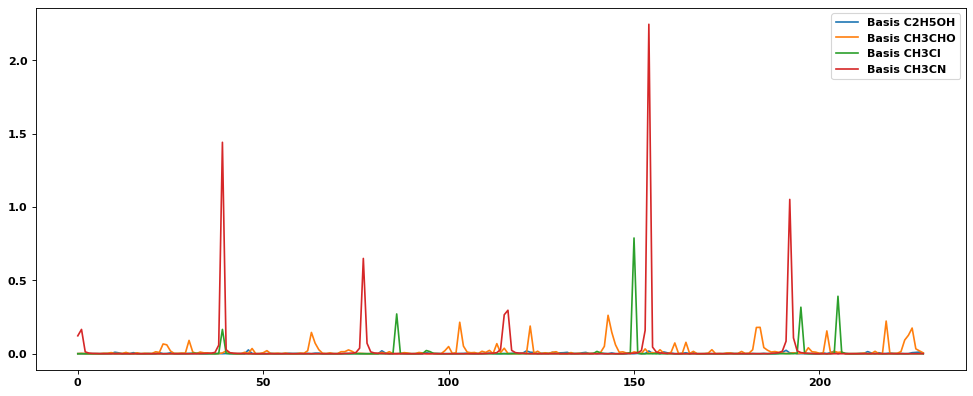

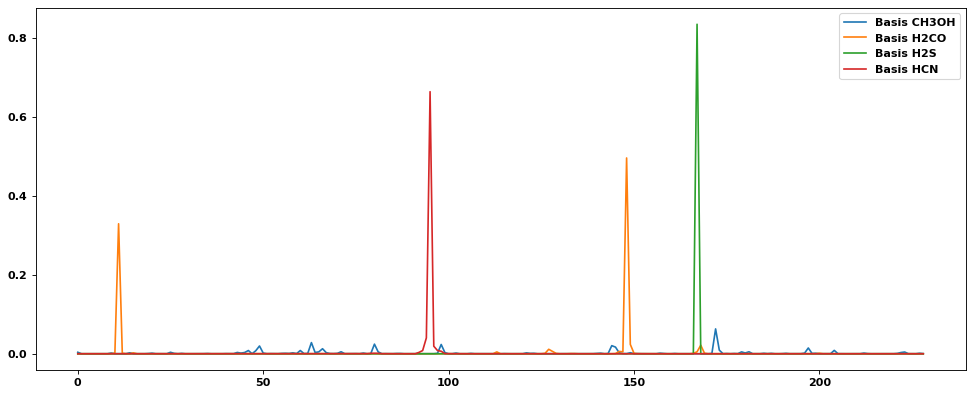

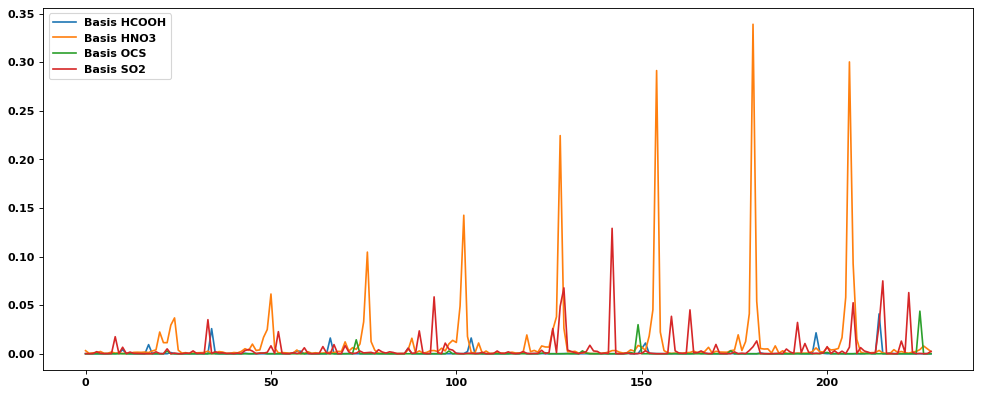

In [6]:


# Visualize basis spectra
figure(num=None, figsize=(15, 6), dpi=80, facecolor='w', edgecolor='k')

plt.plot(df_C2H5OH,label="Basis C2H5OH");
plt.plot(df_CH3CHO,label="Basis CH3CHO");
plt.plot(df_CH3Cl,label="Basis CH3Cl");
plt.plot(df_CH3CN,label="Basis CH3CN");
plt.legend();

figure(num=None, figsize=(15, 6), dpi=80, facecolor='w', edgecolor='k')
plt.plot(df_CH3OH,label="Basis CH3OH");
plt.plot(df_H2CO,label="Basis H2CO");
plt.plot(df_H2S,label="Basis H2S");
plt.plot(df_HCN,label="Basis HCN");
plt.legend();

figure(num=None, figsize=(15, 6), dpi=80, facecolor='w', edgecolor='k')
plt.plot(df_HCOOH,label="Basis HCOOH");
plt.plot(df_HNO3,label="Basis HNO3");
plt.plot(df_OCS,label="Basis OCS");
plt.plot(df_SO2,label="Basis SO2");
plt.legend();

In [7]:
Basis = np.array([[df_C2H5OH], 
                  [df_CH3CHO],
                  [df_CH3Cl],
                  [df_CH3CN],
                  [df_CH3OH],
                  [df_H2CO],
                  [df_H2S],
                  [df_HCN],
                  [df_HCOOH],
                  [df_HNO3],
                  [df_OCS],
                  [df_SO2]                  
                 ])

labels = [' ', '', 'Diluent' ,r'$C_2H_5OH$', r'$CH_3CHO$', r'$CH_3Cl$', r'$CH_3CN$', r'$CH_3OH$', r'$H_2CO$', r'$H_2S$', r'$HCN$', r'$HCOOH$', r'$HNO_3$', r'$OCS$', r'$SO_2$']

In [8]:
print('labels : ', labels)
print('Basis shape:',Basis.shape)
Basis=Basis.reshape(n_compounds, len(dfx))
print('After reshape, Basis shape:',Basis.shape)

labels :  [' ', '', 'Diluent', '$C_2H_5OH$', '$CH_3CHO$', '$CH_3Cl$', '$CH_3CN$', '$CH_3OH$', '$H_2CO$', '$H_2S$', '$HCN$', '$HCOOH$', '$HNO_3$', '$OCS$', '$SO_2$']
Basis shape: (12, 1, 229)
After reshape, Basis shape: (12, 229)


In [10]:
# Start Formalizing Design

In [9]:
# add 50 each of pure component mixtures

#C2H5OH

n_mixture_pure = 1000




targets_c1 = np.empty((n_mixture_pure,n_mixture_component_max),dtype=object)
dilution_c1 = np.empty((n_mixture_pure),dtype=object)

targets_c2 = np.empty((n_mixture_pure,n_mixture_component_max),dtype=object)
dilution_c2 = np.empty((n_mixture_pure),dtype=object)

targets_c3 = np.empty((n_mixture_pure,n_mixture_component_max),dtype=object)
dilution_c3 = np.empty((n_mixture_pure),dtype=object)

targets_c4 = np.empty((n_mixture_pure,n_mixture_component_max),dtype=object)
dilution_c4 = np.empty((n_mixture_pure),dtype=object)

targets_c5 = np.empty((n_mixture_pure,n_mixture_component_max),dtype=object)
dilution_c5 = np.empty((n_mixture_pure),dtype=object)

targets_c6 = np.empty((n_mixture_pure,n_mixture_component_max),dtype=object)
dilution_c6 = np.empty((n_mixture_pure),dtype=object)

targets_c7 = np.empty((n_mixture_pure,n_mixture_component_max),dtype=object)
dilution_c7 = np.empty((n_mixture_pure),dtype=object)

targets_c8 = np.empty((n_mixture_pure,n_mixture_component_max),dtype=object)
dilution_c8 = np.empty((n_mixture_pure),dtype=object)

targets_c9 = np.empty((n_mixture_pure,n_mixture_component_max),dtype=object)
dilution_c9 = np.empty((n_mixture_pure),dtype=object)

targets_c10 = np.empty((n_mixture_pure,n_mixture_component_max),dtype=object)
dilution_c10 = np.empty((n_mixture_pure),dtype=object)

targets_c11 = np.empty((n_mixture_pure,n_mixture_component_max),dtype=object)
dilution_c11 = np.empty((n_mixture_pure),dtype=object)

targets_c12 = np.empty((n_mixture_pure,n_mixture_component_max),dtype=object)
dilution_c12 = np.empty((n_mixture_pure),dtype=object)

mixtures_c1 = np.empty((n_mixture_pure,1, n_features),dtype=object)
mixtures_c2 = np.empty((n_mixture_pure,1, n_features),dtype=object)
mixtures_c3 = np.empty((n_mixture_pure,1, n_features),dtype=object)
mixtures_c4 = np.empty((n_mixture_pure,1, n_features),dtype=object)

mixtures_c5 = np.empty((n_mixture_pure,1, n_features),dtype=object)
mixtures_c6 = np.empty((n_mixture_pure,1, n_features),dtype=object)
mixtures_c7 = np.empty((n_mixture_pure,1, n_features),dtype=object)
mixtures_c8 = np.empty((n_mixture_pure,1, n_features),dtype=object)

mixtures_c9 = np.empty((n_mixture_pure,1, n_features),dtype=object)
mixtures_c10 = np.empty((n_mixture_pure,1, n_features),dtype=object)
mixtures_c11 = np.empty((n_mixture_pure,1, n_features),dtype=object)
mixtures_c12 = np.empty((n_mixture_pure,1, n_features),dtype=object)


c1=[1,0,0,0,0,0,0,0,0,0,0,0]
c2=[0,1,0,0,0,0,0,0,0,0,0,0]
c3=[0,0,1,0,0,0,0,0,0,0,0,0]
c4=[0,0,0,1,0,0,0,0,0,0,0,0]

c5=[0,0,0,0,1,0,0,0,0,0,0,0]
c6=[0,0,0,0,0,1,0,0,0,0,0,0]
c7=[0,0,0,0,0,0,1,0,0,0,0,0]
c8=[0,0,0,0,0,0,0,1,0,0,0,0]

c9=[0,0,0,0,0,0,0,0,1,0,0,0]
c10=[0,0,0,0,0,0,0,0,0,1,0,0]
c11=[0,0,0,0,0,0,0,0,0,0,1,0]
c12=[0,0,0,0,0,0,0,0,0,0,0,1]

for j in range(n_mixture_pure):
    dilution_c1[j]=np.random.random(1)
    
    targets_c1[j] = (1-dilution_c1[j])*c1
    targets_c1[j]=targets_c1[j].astype(np.float)
    mixtures_c1[j] = np.dot(Basis.T,targets_c1[j])

    
    dilution_c2[j]=np.random.random(1)
    
    targets_c2[j] = (1-dilution_c2[j])*c2
    targets_c2[j]=targets_c2[j].astype(np.float)
    mixtures_c2[j] = np.dot(Basis.T,targets_c2[j])
    
    dilution_c3[j]=np.random.random(1)
    
    targets_c3[j] = (1-dilution_c3[j])*c3
    targets_c3[j]=targets_c3[j].astype(np.float)
    mixtures_c3[j] = np.dot(Basis.T,targets_c3[j])
    
    dilution_c4[j]=np.random.random(1)
    
    targets_c4[j] = (1-dilution_c4[j])*c4
    targets_c4[j]=targets_c4[j].astype(np.float)
    mixtures_c4[j] = np.dot(Basis.T,targets_c4[j])
    
    dilution_c5[j]=np.random.random(1)
    
    targets_c5[j] = (1-dilution_c5[j])*c5
    targets_c5[j]=targets_c5[j].astype(np.float)
    mixtures_c5[j] = np.dot(Basis.T,targets_c5[j])
    
    dilution_c6[j]=np.random.random(1)
    
    targets_c6[j] = (1-dilution_c6[j])*c6
    targets_c6[j]=targets_c6[j].astype(np.float)
    mixtures_c6[j] = np.dot(Basis.T,targets_c6[j])
    
    dilution_c7[j]=np.random.random(1)
    
    targets_c7[j] = (1-dilution_c7[j])*c7
    targets_c7[j]=targets_c7[j].astype(np.float)
    mixtures_c7[j] = np.dot(Basis.T,targets_c7[j])
    
    dilution_c8[j]=np.random.random(1)
    
    targets_c8[j] = (1-dilution_c8[j])*c8
    targets_c8[j]=targets_c8[j].astype(np.float)
    mixtures_c8[j] = np.dot(Basis.T,targets_c8[j])
    
    dilution_c9[j]=np.random.random(1)
    
    targets_c9[j] = (1-dilution_c9[j])*c9
    targets_c9[j]=targets_c9[j].astype(np.float)
    mixtures_c9[j] = np.dot(Basis.T,targets_c9[j])
    
    dilution_c10[j]=np.random.random(1)
    
    targets_c10[j] = (1-dilution_c10[j])*c10
    targets_c10[j]=targets_c10[j].astype(np.float)
    mixtures_c10[j] = np.dot(Basis.T,targets_c10[j])
    
    dilution_c11[j]=np.random.random(1)
    
    targets_c11[j] = (1-dilution_c11[j])*c11
    targets_c11[j]=targets_c11[j].astype(np.float)
    mixtures_c11[j] = np.dot(Basis.T,targets_c11[j])
    
    dilution_c12[j]=np.random.random(1)
    
    targets_c12[j] = (1-dilution_c12[j])*c12
    targets_c12[j]=targets_c12[j].astype(np.float)
    mixtures_c12[j] = np.dot(Basis.T,targets_c12[j])


# plt.plot(dfx,mixtures_c1.reshape(n_mixture_pure,n_features)[0])
print(mixtures_c1.shape)

(1000, 1, 229)


In [10]:
#Add all pure mixtures together

targets_pure=np.concatenate((targets_c1,targets_c2,targets_c3,targets_c4,
                              targets_c5,targets_c6,targets_c7,targets_c8,
                              targets_c9,targets_c10,targets_c11,targets_c12),axis=0)

mixtures_pure=np.concatenate((mixtures_c1,mixtures_c2,mixtures_c3,mixtures_c4,
                              mixtures_c5,mixtures_c6,mixtures_c7,mixtures_c8,
                              mixtures_c9,mixtures_c10,mixtures_c11,mixtures_c12),axis=0)

targets_pure=targets_pure.astype(np.float)
mixtures_pure=mixtures_pure.astype(np.float)

print('targets_pure data type: ', targets_pure.dtype)
print('mixtures_pure data type: ', mixtures_pure.dtype)


print('targets_pure.shape :',targets_pure.shape)
print('mixtures_pure.shape :',mixtures_pure.shape)

targets_pure data type:  float64
mixtures_pure data type:  float64
targets_pure.shape : (12000, 12)
mixtures_pure.shape : (12000, 1, 229)


In [11]:
# Number of artificial randomized mixtures
# This should equal to predetermined array size and loop counter

# Have to set a random number seed here

import datetime
t_start = datetime.datetime.now()

n_mixtures = 3988000

# Absorbance threshold (measurements must be above this)



targets = np.empty((n_mixtures,n_mixture_component_max),dtype=object)
dilution = np.empty((n_mixtures),dtype=object)
for i in range(n_mixtures):
#      a[x]=np.array([x, x+1])
        c_rand=np.random.random(12)
        c_rand /=c_rand.sum()
        dilution[i]=np.random.random(1)
#         print('Dilution : ', dilution[i])
        
        targets[i] = c_rand*(1-dilution[i])
        targets[i]=targets[i].astype(np.float)
#         print('Sum of mixture components : ', targets[i].sum())



t_end = datetime.datetime.now()
delta = t_end - t_start
Time_OVR=delta.total_seconds() * 1000

print('Time elaspsed: ', Time_OVR) # milliseconds
print('Number of artificial mixtures : ', n_mixtures)
print('Targets data type: ', targets.dtype)
print('Targets shape: ', targets.shape)

Time elaspsed:  48744.472
Number of artificial mixtures :  3988000
Targets data type:  object
Targets shape:  (3988000, 12)


In [12]:
import datetime
t_start = datetime.datetime.now()

mixtures = np.empty((n_mixtures,1, n_features),dtype=object)

for i in range(n_mixtures):
    mixtures[i] = np.dot(Basis.T,targets[i])
    mixtures[i]=mixtures[i].astype(np.float)

    
t_end = datetime.datetime.now()
delta = t_end - t_start
Time_OVR=delta.total_seconds() * 1000

print('Time elaspsed: ', Time_OVR) # milliseconds

# Use predetermined mixtures to understand the model better
#Print the random number seed
print(np.random.get_state()[1][0])

print('mixtures data type: ', mixtures.dtype)
print('mixtures shape: ', mixtures.shape)

Time elaspsed:  424283.56
3365621273
mixtures data type:  object
mixtures shape:  (3988000, 1, 229)


In [13]:
# Check if the dot product is working correctly
# plt.plot(np.dot(Basis.T,targets[0]) )

In [14]:
#Combine pure compounds and artificial mixtures together

#If do not want pure spectra then do not run this cell

n_mixtures = (n_mixtures + n_mixture_pure*n_mixture_component_max)
print('Total number of linear simulated mixtures : ',n_mixtures)

targets=np.concatenate((targets_pure, targets),axis=0)

mixtures=np.concatenate((mixtures_pure, mixtures),axis=0)


print('\nCombined (pure compounds and simulated mixtures)\n')
print('targets data type: ', targets.dtype)
print('mixtures_pure data type: ', mixtures.dtype)
print('targets data shape: ', targets.shape)
print('mixtures_pure data shape: ', mixtures.shape)


Total number of linear simulated mixtures :  4000000

Combined (pure compounds and simulated mixtures)

targets data type:  object
mixtures_pure data type:  object
targets data shape:  (4000000, 12)
mixtures_pure data shape:  (4000000, 1, 229)


In [15]:
#save the data in binary numpy file before removing indices
#Get Current date and time to store the data
from datetime import date, datetime

today = date.today()
now = datetime.now()

print("now =", now)
# dd/mm/YY H:M:S
dt_string = now.strftime("%d-%m-%Y_time_%H-%M-%S")
print("date and time =", dt_string)	


from tempfile import TemporaryFile

if linux==1:
    data_identifier = 'RandomTrainingMixtures' + '/' + 'N_mix = ' + str(n_mixtures) + '_' + dt_string + '_FullSet_'
else:
    data_identifier = 'RandomTrainingMixtures' + '\\' + 'N_mix = ' + str(n_mixtures) + '_' + dt_string + '_FullSet_'


np.save(data_identifier + 'Mixture_Net_data_mixtures', mixtures)
np.save(data_identifier + 'Mixture_Net_data_targets', targets)

now = 2021-08-06 16:09:56.036896
date and time = 06-08-2021_time_16-09-56


In [16]:
# Check mixture threshold and eliminate
# mixtures[0]
# print the max absorbance values for all the mixtures below threshold and their indices
Abs_threshold = 0.001 
Remove_indices = []
for _ in range(n_mixtures):
    if np.amax(mixtures[_]) < Abs_threshold:
        
#         print('Index : ',_)
        Remove_indices=np.append(Remove_indices, _)
        #save indices in array
#         print(' Max Abs:',np.amax(mixtures[_]))
        
# print(Remove_indices)
print('Total indices removed : ',Remove_indices.shape)
Remove_indices=Remove_indices.astype(int)

Total indices removed :  (22061,)


In [17]:
# filtering_threshold = [100,10, 1, 0.1,0.01,0.001,0.001,0.0001]
# store_indices=[]
# frequency_bins=[]
# Mixture_peaks = []
# for element in filtering_threshold:
#     store_indices=[]
# #     print(element)
#     for _ in range(n_mixtures):
#         Mixture_peaks =np.append(Mixture_peaks, np.amax(mixtures[_]))
#         if np.amax(mixtures[_]) < element: 
#             store_indices=np.append(store_indices, _)
# #     print(store_indices.shape)
#     frequency_bins=np.append(frequency_bins,store_indices.shape[0])
    
# print(frequency_bins)
# # plt.plot(filtering_threshold,frequency_bins)

In [18]:
# Mixture_peaks.shape
# plt.hist(Mixture_peaks, density=False, bins=10, label="Data")

In [19]:
#remove those mixtures and their corresponding concentrations from dataset
mixtures=np.delete(mixtures, Remove_indices, 0)
targets=np.delete(targets, Remove_indices, 0)

print('mixtures data type: ', mixtures.dtype)
print('mixtures shape: ', mixtures.shape)

print('targets data type: ', targets.dtype)
print('targets shape: ', targets.shape)

mixtures data type:  object
mixtures shape:  (3977939, 1, 229)
targets data type:  object
targets shape:  (3977939, 12)


In [20]:
#save the data in binary numpy file
#Get Current date and time to store the data
from datetime import date, datetime

today = date.today()
# now = datetime.now() # use same timestamp as before

print("now =", now)
# dd/mm/YY H:M:S
# dt_string = now.strftime("%d-%m-%Y_time_%H-%M-%S")
print("date and time =", dt_string)	


from tempfile import TemporaryFile

if linux==1:
    data_identifier = 'RandomTrainingMixtures' + '/' + 'N_mix = ' + str(n_mixtures -Remove_indices.shape[0]) + '_' + dt_string + '_'
else:
    data_identifier = 'RandomTrainingMixtures' + '\\' + 'N_mix = ' + str(n_mixtures - Remove_indices.shape[0]) + '_' + dt_string + '_'


np.save(data_identifier + 'Mixture_Net_data_mixtures', mixtures)
np.save(data_identifier + 'Mixture_Net_data_targets', targets)

now = 2021-08-06 16:09:56.036896
date and time = 06-08-2021_time_16-09-56


In [21]:
# mixtures[0:].shape

# plt.plot(mixtures[0:])

In [22]:
n_mixtures = n_mixtures - Remove_indices.shape[0]

In [111]:
targets = np.load('N_mix = 1000_03-08-2021_time_18-55-55_FullSet_Mixture_Net_data_targets.npy',allow_pickle=True)
targets.shape
mixtures = np.load('N_mix = 1000_03-08-2021_time_18-55-55_FullSet_Mixture_Net_data_mixtures.npy',allow_pickle=True)
mixtures.shape
n_mixtures=1000


In [23]:

X=mixtures.reshape(n_mixtures,n_features)
X.shape

(3977939, 229)

In [24]:
# Visualize mixtures with ipython widget

from ipywidgets import interactive
import matplotlib.pyplot as plt
import numpy as np

def f_spectra(spectra_no):
    plt.figure(figsize=(8, 3))
    #x = np.linspace(-10, 10, num=100)
    plt.plot(X[spectra_no]); #reshape needed so you have 367 datapoints.
    plt.xlabel('Wavenumber')
    plt.ylabel('Absorbance ')
    plt.locator_params(nbins=11) #number of ticks
    #plt.ylim(-0.1, 1.2)
    plt.grid(True)
    plt.show()

interactive_plot = interactive(f_spectra, spectra_no=(0, n_mixtures-1))
output = interactive_plot.children[-1]
output.layout.height = '300px'
interactive_plot

interactive(children=(IntSlider(value=1988969, description='spectra_no', max=3977938), Output(layout=Layout(he…

In [25]:
# Access individual mixtures in the dataset
# plt.plot(X[1])

In [26]:
# mixtures[0].T.shape

In [27]:
y=targets

In [28]:
print('X shape:', X.shape)
print('y shape:', y.shape)

print('X dtype:', X.dtype)
print('y dtype:', y.dtype)

X=X.astype(np.float)
y=y.astype(np.float)

print('After data type conversion')
print('X dtype:', X.dtype)
print('y dtype:', y.dtype)

X shape: (3977939, 229)
y shape: (3977939, 12)
X dtype: object
y dtype: object
After data type conversion
X dtype: float64
y dtype: float64


In [117]:
#Convert X and y to tensors

# X = tf.convert_to_tensor(X, dtype='float64', name=None)
# y = tf.convert_to_tensor(y, dtype='float64', name=None)

# X = tf.convert_to_tensor(X, dtype='float32', name=None)
# y = tf.convert_to_tensor(y, dtype='float32', name=None)

In [29]:
print('X shape:', X.shape)
print('y shape:', y.shape)

print('X dtype:', X.dtype)
print('y dtype:', y.dtype)

X shape: (3977939, 229)
y shape: (3977939, 12)
X dtype: float64
y dtype: float64


In [119]:
# load dataset beforehand

import datetime
t_start = datetime.datetime.now()

from numpy import mean
from numpy import std
# from sklearn.datasets import make_regression
from sklearn.model_selection import RepeatedKFold
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

# get the dataset
# def get_dataset():
#     X, y = make_regression(n_samples=1000, n_features=10, n_informative=5, n_targets=3, random_state=2)
#     return X, y

# get the model
def get_model(n_inputs, n_outputs):
    neurons=100
    model = Sequential()
    
    model.add(Dense(neurons, input_dim=n_inputs, kernel_initializer='he_uniform', activation='tanh'))
    model.add(Dense(neurons, input_dim=n_inputs, kernel_initializer='he_uniform', activation='tanh'))
    model.add(Dense(neurons, input_dim=n_inputs, kernel_initializer='he_uniform', activation='tanh'))
    model.add(Dense(neurons, input_dim=n_inputs, kernel_initializer='he_uniform', activation='tanh'))

  
    
    model.add(Dense(n_outputs))
    model.compile(loss='mae', optimizer='adam')
    return model

# evaluate a model using repeated k-fold cross-validation
def evaluate_model(X, y):
    results = list()
    n_inputs, n_outputs = X.shape[1], y.shape[1]
    # define evaluation procedure
    cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
    # enumerate folds
    for train_ix, test_ix in cv.split(X):
        # prepare data
        X_train, X_test = X[train_ix], X[test_ix]
        y_train, y_test = y[train_ix], y[test_ix]
        # define model
        model = get_model(n_inputs, n_outputs)
        # fit model
        model.fit(X_train, y_train, verbose=0, epochs=100)
        # evaluate model on test set
        mae = model.evaluate(X_test, y_test, verbose=0)
        # store result
#         print('>%.3f' % mae)
        results.append(mae)
    return results



# evaluate model
results = evaluate_model(X, y)
# summarize performance
print('MAE: %.7f (%.7f)' % (mean(results), std(results)))

t_end = datetime.datetime.now()
delta = t_end - t_start
Time_OVR=delta.total_seconds() * 1000

print('Time elaspsed: ', Time_OVR) # milliseconds

MAE: 0.0021796 (0.0004407)
Time elaspsed:  200496.42


In [20]:
print('X shape:', X.shape)
print('y shape:', y.shape)

X shape: (100, 229)
y shape: (100, 12)


In [34]:
# Add 70-30 train-test split

# Not necessary

# Use repeated k-fold to find the right number of neurons

In [35]:
casename='Mixture_Net' + data_identifier


In [36]:
# # Repeated K-fold for Gaussian process

# import datetime
# t_start = datetime.datetime.now()

# from numpy import mean
# from numpy import std
# # from sklearn.datasets import make_regression
# from sklearn.model_selection import RepeatedKFold





# # evaluate a model using repeated k-fold cross-validation
# def evaluate_model(X, y):
#     results = list()
#     n_inputs, n_outputs = X.shape[1], y.shape[1]
#     # define evaluation procedure
#     cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=1)
#     # enumerate folds
#     for train_ix, test_ix in cv.split(X):
#         # prepare data
#         X_train, X_test = X[train_ix], X[test_ix]
#         y_train, y_test = y[train_ix], y[test_ix]
#         # define model
# #         kernel = DotProduct() + WhiteKernel()
#         kernel = 1.0 * RBF(1.0)
#         model = GaussianProcessRegressor(kernel=kernel,
#         random_state=0).fit(X, y)

#         # fit model
#         model.fit(X_train, y_train)
#         # evaluate model on test set
#         mas = model.score(X_test, y_test)
#         # store result
# #         print('>%.3f' % mas)
#         results.append(mas)
#     return results



# # evaluate model
# results = evaluate_model(X, y)
# # summarize performance
# print('Mean average score: %.5f (%.5f)' % (mean(results), std(results)))

# t_end = datetime.datetime.now()
# delta = t_end - t_start
# Time_OVR=delta.total_seconds() * 1000

# print('Time elaspsed: ', Time_OVR) # milliseconds

In [37]:
# # Gaussian process regress kriging
# import datetime
# t_start = datetime.datetime.now()

# kernel = DotProduct() + WhiteKernel()
# kernel = 1.0 * RBF(1.0)
# model = GaussianProcessRegressor(kernel=kernel,
#         random_state=0).fit(X, y)
# model.score(X, y)

# model.predict(X[:2,:], return_std=True)

# t_end = datetime.datetime.now()
# delta = t_end - t_start
# Time_OVR=delta.total_seconds() * 1000

# print('Time elaspsed: ', Time_OVR) # milliseconds

# from joblib import dump, load

# dump(model,'Mixture_GP_RBF_N_mix=1000.joblib')

In [38]:
# model = load('Mixture_GP_V1_N_mix=1000.joblib') 

In [31]:
import datetime
t_start = datetime.datetime.now()

#  multi-output regression
from numpy import asarray
from sklearn.datasets import make_regression
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

# get the dataset
# def get_dataset():
#     X, y = make_regression(n_samples=1000, n_features=10, n_informative=5, n_targets=3, random_state=2)
#     return X, y

# get the model
def get_model(n_inputs, n_outputs):
    neurons=100
    model = Sequential()
    model.add(Dense(neurons, input_dim=n_inputs, kernel_initializer='he_uniform', activation='tanh'))
    model.add(Dense(neurons, input_dim=n_inputs, kernel_initializer='he_uniform', activation='tanh'))
    model.add(Dense(neurons, input_dim=n_inputs, kernel_initializer='he_uniform', activation='tanh'))
    model.add(Dense(neurons, input_dim=n_inputs, kernel_initializer='he_uniform', activation='tanh'))
    
#     model.add(Dense(10, input_dim=n_inputs, kernel_initializer='he_uniform', activation='relu'))
    model.add(Dense(n_outputs, kernel_initializer='he_uniform'))
    model.compile(loss='mae', optimizer='adam')
    return model

# load dataset
# X, y = get_dataset()
n_inputs, n_outputs = X.shape[1], y.shape[1]
# get model
model = get_model(n_inputs, n_outputs)
# fit the model on all data
model.fit(X, y, verbose=0, epochs=100)
# make a prediction for new data
# row = [-0.99859353,2.19284309,-0.42632569,-0.21043258,-1.13655612,-0.55671602,-0.63169045,-0.87625098,-0.99445578,-0.3677487]
row=X[0]
newX = asarray([row])
yhat = model.predict(newX)
print('Predicted: %s' % yhat)

mae = model.evaluate(X, y, verbose=0)
print('MAE: >%.7f' % mae)

t_end = datetime.datetime.now()
delta = t_end - t_start
Time_OVR=delta.total_seconds() * 1000

print('Time elaspsed: ', Time_OVR) # milliseconds

Predicted: [[ 7.5650913e-01  8.4206834e-04  1.8124729e-03  2.7832426e-03
   5.2884966e-04  2.6649460e-03  1.6425736e-03  2.8939396e-03
   1.3531819e-03  2.0413883e-03 -3.1074136e-04  1.3135262e-03]]
MAE: >0.0005012
Time elaspsed:  26052172.014


In [32]:
model.save('Mixture_net_V13'+'N_mix = ' + str(n_mixtures) + '_' + dt_string + '_')


INFO:tensorflow:Assets written to: Mixture_net_V13N_mix = 3977939_06-08-2021_time_16-09-56_/assets


In [86]:
# run only if you want to load pretrained model
# new_model = tf.keras.models.load_model('Mixture_net_V8_0948AM_07272021_N_mix=1000000')
# new_model = tf.keras.models.load_model('Mixture_net_V8_1503PM_07272021_N_mix=2000000')
new_model = tf.keras.models.load_model('Mixture_net_V8_1111AM_07282021_N_mix=4000000')


model=new_model

model.summary()

row=X[0]
newX = asarray([row])
yhat = model.predict(newX)
print('Predicted: %s' % yhat)

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_2 (Dense)              (None, 100)               23000     
_________________________________________________________________
dense_3 (Dense)              (None, 12)                1212      
Total params: 24,212
Trainable params: 24,212
Non-trainable params: 0
_________________________________________________________________
Predicted: [[0.04561992 0.02040125 0.0241023  0.03497004 0.0458307  0.04436965
  0.01797416 0.04629261 0.02610832 0.0345329  0.00556083 0.02571546]]


In [39]:
newX.shape

(1, 229)

In [40]:

print(y[0])
print(yhat[0]-y[0])

[0.01582654 0.02726985 0.01731247 0.02032504 0.02323156 0.01800987
 0.0164503  0.00956697 0.01259418 0.0020608  0.02165145 0.01202614]
[-9.39153520e-05  5.53841165e-05  6.89325464e-07  2.38801531e-04
 -1.46260475e-04  8.96111121e-05  1.27507840e-04  9.67834934e-05
 -5.04590447e-04 -8.55304070e-05  4.67374488e-04 -3.27497776e-04]


In [41]:
# Create noisy data

# author - Mathuranathan Viswanathan (gaussianwaves.com
# This code is part of the book Digital Modulations using Python

from numpy import sum,isrealobj,sqrt
from numpy.random import standard_normal

def awgn(s,SNRdB,L=1):
    """
    AWGN channel
    Add AWGN noise to input signal. The function adds AWGN noise vector to signal 's' to generate a resulting signal vector 'r' of specified SNR in dB. It also
    returns the noise vector 'n' that is added to the signal 's' and the power spectral density N0 of noise added
    Parameters:
        s : input/transmitted signal vector
        SNRdB : desired signal to noise ratio (expressed in dB) for the received signal
        L : oversampling factor (applicable for waveform simulation) default L = 1.
    Returns:
        r : received signal vector (r=s+n)
"""
    gamma = 10**(SNRdB/10) #SNR to linear scale
    if s.ndim==1:# if s is single dimensional vector
        P=L*sum(abs(s)**2)/len(s) #Actual power in the vector
    else: # multi-dimensional signals like MFSK
        P=L*sum(sum(abs(s)**2))/len(s) # if s is a matrix [MxN]
    N0=P/gamma # Find the noise spectral density
    if isrealobj(s):# check if input is real/complex object type
        n = sqrt(N0/2)*standard_normal(s.shape) # computed noise
    else:
        n = sqrt(N0/2)*(standard_normal(s.shape)+1j*standard_normal(s.shape))
    r = s + n # received signal
    return r

In [42]:
#
Validation_X = 0.1*X
wavenumbers = dfx

# Adding noise using target SNR

# Get the signals

# Set a target SNR
target_snr_db = 20

for _ in range(n_mixtures):
    x_volts=X[_]
#     print(_)


    x_watts = x_volts ** 2

    x_db = 10 * np.log10(x_watts)



    # Calculate signal power and convert to dB 
    sig_avg_watts = np.mean(x_watts)
    sig_avg_db = 10 * np.log10(sig_avg_watts)
    # Calculate noise according to [2] then convert to watts
    noise_avg_db = sig_avg_db - target_snr_db
    noise_avg_watts = 10 ** (noise_avg_db / 10)
    # Generate an sample of white noise
    mean_noise = 0
    noise_volts = np.random.normal(mean_noise, np.sqrt(noise_avg_watts), len(x_watts))
#     print('Signal peak :',np.amax(x_volts))
#     print('noise peak :',np.amax(noise_volts))
    noise_volts = np.amax(x_volts)*noise_volts/(target_snr_db*np.amax(noise_volts))
    
#     print('After scaling Signal peak :',np.amax(x_volts))
#     print('After scaling noise peak :',np.amax(noise_volts))
#     Adjust/scale the noise
    
    # Noise up the original signal
    y_volts = (x_volts + noise_volts)

    Validation_X[_] = y_volts
#     noisy = awgn(x_volts,target_snr_db,L=1)
#     Validation_X[_] = noisy



#Visualize the validation spectra


#Temporary.shape
dfy.shape
# idx
#plt.plot(Temporary[160].reshape(367));


from ipywidgets import interactive
import matplotlib.pyplot as plt
import numpy as np

def f_spectra(spectra_no):
    plt.figure(figsize=(16, 3))
    #x = np.linspace(-10, 10, num=100)
    plt.plot(wavenumbers,Validation_X[spectra_no]); #reshape needed so you have 229 datapoints.
    plt.xlabel('Wavenumber')
    plt.ylabel('Absorbance ')
    plt.locator_params(nbins=11) #number of ticks
    #plt.ylim(-0.1, 1.2)
    plt.grid(True)
    plt.show()

interactive_plot = interactive(f_spectra, spectra_no=(0, n_mixtures-1))
output = interactive_plot.children[-1]
output.layout.height = '300px'
interactive_plot



interactive(children=(IntSlider(value=49723, description='spectra_no', max=99447), Output(layout=Layout(height…

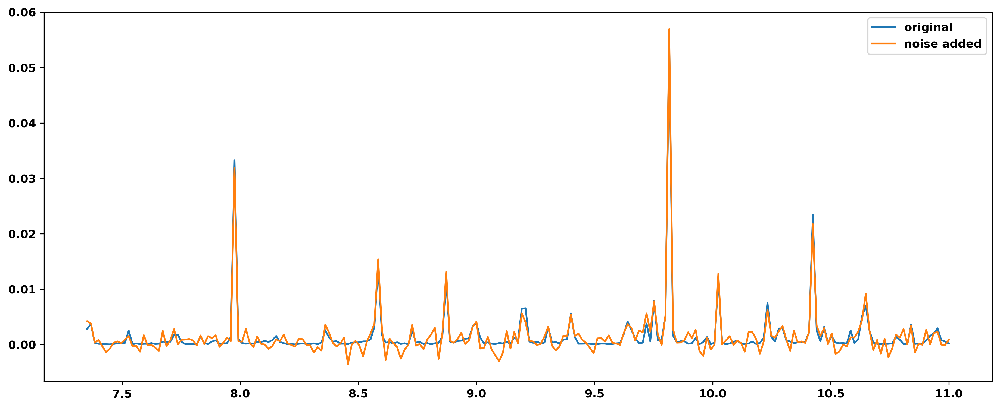

In [43]:
#Compare original X and noise added X.
# fig = plt.figure(figsize=(1.2,0.5),dpi=100)
# ax_comparison = fig.add_axes([0, 0, 1, 1])
figure(num=None, figsize=(15, 6), dpi=300, facecolor='w', edgecolor='k')
plt.plot(wavenumbers,X[1],label='original')
plt.plot(wavenumbers,Validation_X[1], label='noise added')
plt.legend()

In [44]:
val_yhat = model.predict(Validation_X)
yhat = model.predict(X)


In [45]:
# Choose sample from the pool of spectra
sample_no=33


print('\n')
print('val_yhat shape : ', val_yhat.shape)
print('\n')
print(f'val_yhat[{sample_no}] :',val_yhat[sample_no])
print('\n')
print(f'yhat[{sample_no}] :', yhat[sample_no])
print('\n')
print(f'val_yhat[{sample_no}].sum() :',val_yhat[sample_no].sum())
print('\n')
print(f'yhat[{sample_no}].sum() :',yhat[sample_no].sum())



val_yhat shape :  (99448, 12)


val_yhat[33] : [ 0.07443962  0.01340467  0.09138202  0.0645436  -0.08730763  0.0986254
  0.05744798  0.03072675  0.02131198  0.04691849  0.10233842  0.00591943]


yhat[33] : [0.04859815 0.0094681  0.09410742 0.06571797 0.00473263 0.09078179
 0.06544162 0.03576688 0.05545732 0.03996151 0.05583791 0.01022645]


val_yhat[33].sum() : 0.5197507


yhat[33].sum() : 0.5760977


In [46]:
Modifide_Concentration_Actual=np.append(dilution[sample_no],y[sample_no])

print('Modifide_Concentration_Actual : \n',Modifide_Concentration_Actual)

Modifide_Concentration_Predicted=np.append((1-yhat[sample_no].sum()),yhat[sample_no])
print('Modifide_Concentration_Predicted : \n',Modifide_Concentration_Predicted)

Modifide_Concentration_Predicted_validation=np.append((1-val_yhat[sample_no].sum()),val_yhat[sample_no])

print('Modifide_Concentration_Predicted_validation : \n',Modifide_Concentration_Predicted_validation)

Modifide_Concentration_Actual : 
 [0.42548093 0.04830859 0.00927152 0.09425402 0.06621578 0.00477384
 0.0903299  0.06575118 0.03420527 0.05481026 0.04015303 0.05629153
 0.01015416]
Modifide_Concentration_Predicted : 
 [0.42390227 0.04859815 0.0094681  0.09410742 0.06571797 0.00473263
 0.09078179 0.06544162 0.03576688 0.05545732 0.03996151 0.05583791
 0.01022645]
Modifide_Concentration_Predicted_validation : 
 [ 0.48024929  0.07443962  0.01340467  0.09138202  0.0645436  -0.08730763
  0.0986254   0.05744798  0.03072675  0.02131198  0.04691849  0.10233842
  0.00591943]


In [47]:
# fig = plt.figure(figsize=(1.2,0.5),dpi=600)
# ax_comparison = fig.add_axes([0, 0, 1, 1])

# plt.rc('font', weight='bold')

# # ax_comparison.scatter(Components.reshape(12), yhat.reshape(12), s = 5,facecolor = 'none', color ='firebrick',label="Predicted")
# # ax_comparison.scatter(Components.reshape(12), y[0].reshape(12), s = 5, marker = 's', facecolor = 'none', alpha=1, color ='darkblue', label="Actual")

# ax_comparison.scatter(Components.reshape(13), Modifide_Concentration_Predicted_validation.reshape(13) , s = 4, marker = 's', facecolor = 'none', alpha=1, color ='darkred', linewidths=0.4,  label="Noisy data")
# ax_comparison.scatter(Components.reshape(13), Modifide_Concentration_Predicted.reshape(13), s = 4,facecolor = 'none', color ='darkgoldenrod', linewidths=0.4 ,label="Predicted")
# ax_comparison.scatter(Components.reshape(13), Modifide_Concentration_Actual.reshape(13) , s = 4, marker = 's', facecolor = 'none', alpha=1, color ='darkgreen', linewidths=0.4,  label="Actual")



# ax_comparison.legend(loc=1, prop={'size': 3})

# ax_comparison.set_xlim(-1, 13)

# ax_comparison.set_xticklabels(np.delete(labels,0));
# plt.xticks(rotation=90);
# ax_comparison.xaxis.set_major_locator(MaxNLocator(14)) 

# ax_comparison.xaxis.set_tick_params(which='major', size=2, width=1, direction='out',labelsize=2)
# # ax_comparison.xaxis.set_tick_params(which='minor', size=2, width=1, direction='out',labelsize=2)


# ax_comparison.yaxis.set_tick_params(which='major', size=2, width=1, direction='out',labelsize=2)
# ax_comparison.yaxis.set_tick_params(which='minor', size=2, width=1, direction='out',labelsize=2)

# # Add the x and y-axis labels
# ax_comparison.set_xlabel(r'Components', labelpad=1, fontsize = '4',  fontweight='bold')
# ax_comparison.set_ylabel(r'Mole Fractions', labelpad=1,fontsize = '4',  fontweight='bold')
# # ax_H2O.set_xlabel(r'Frequency, $\nu$ ($cm^{-1}$)', labelpad=4, fontsize='medium', fontweight='bold')

# plt.show()
# figurename= casename + '_val_pred_act_SNR=20.jpg'
# # fig.savefig(figurename, bbox_inches='tight',dpi=600)
# print(yhat[sample_no].reshape(12).sum())

# ############################################

# fig = plt.figure(figsize=(1.2,0.5),dpi=600)
# ax_comparison = fig.add_axes([0, 0, 1, 1])

# plt.rc('font', weight='bold')
# h= 0.9 #height in barh plot
# # ax_comparison.barh(Components.reshape(12), yhat.reshape(12), height=h, alpha = 1, color ='darkgoldenrod',label="Predicted")
# # ax_comparison.barh(Components.reshape(12), -y[0].reshape(12) , height=h, alpha = 1, color ='darkgreen', label="Actual")

# ax_comparison.barh(Components.reshape(13), Modifide_Concentration_Predicted_validation.reshape(13), height=h, alpha = 1, color ='darkred',label="Validation")
# ax_comparison.barh(Components.reshape(13), -Modifide_Concentration_Actual.reshape(13) , height=h, alpha = 1, color ='darkgreen', label="Actual")


# ax_comparison.legend(loc=1, prop={'size':2})

# ax_comparison.set_ylim(-1, 13)

# ax_comparison.xaxis.set_tick_params(which='major', size=2, width=0.5, direction='out',labelsize=2)
# ax_comparison.xaxis.set_tick_params(which='minor', size=2, width=0.5, direction='out',labelsize=2)

# ax_comparison.set_yticklabels(labels);
# # ax_comparison.set_xticks(rotation=0);

# ax_comparison.yaxis.set_tick_params(which='major', size=3, width=0.5, direction='out',labelsize=2)
# # ax_comparison.yaxis.set_tick_params(which='minor', size=2, width=1, direction='out',labelsize=2)

# ax_comparison.yaxis.set_major_locator(mpl.ticker.MultipleLocator(1))
# # ax_comparison.yaxis.set_minor_locator(mpl.ticker.MultipleLocator(0.005))

# # Add the x and y-axis labels
# ax_comparison.set_ylabel(r'Components', labelpad=0.5, fontsize = '3',  fontweight='bold')
# ax_comparison.set_xlabel(r'Mole Fractions', labelpad=0.5,fontsize = '3',  fontweight='bold')
# # ax_H2O.set_xlabel(r'Frequency, $\nu$ ($cm^{-1}$)', labelpad=4, fontsize='medium', fontweight='bold')


# # ticks_loc = ax_comparison.get_yticks().tolist()
# # ax_comparison.set_yticks(ax_comparison.get_yticks().tolist())
# # ax_comparison.set_yticklabels([labels])

# plt.show()

# figurename= casename + '_val_pred_act_bars_1_SNR=20.jpg'
# # fig.savefig(figurename, bbox_inches='tight',dpi=600)

# ########################################################

# fig = plt.figure(figsize=(1.2,0.5),dpi=600)
# ax_comparison = fig.add_axes([0, 0, 1, 1])

# plt.rc('font', weight='bold')
# h= 0.9 #height in barh plot
# # ax_comparison.barh(Components.reshape(12), yhat.reshape(12), height=h, alpha = 1, color ='darkgoldenrod',label="Predicted")
# # ax_comparison.barh(Components.reshape(12), -y[0].reshape(12) , height=h, alpha = 1, color ='darkgreen', label="Actual")

# ax_comparison.barh(Components.reshape(13), Modifide_Concentration_Predicted.reshape(13), height=h, alpha = 1, color ='darkgoldenrod',label="Predicted")
# ax_comparison.barh(Components.reshape(13), -Modifide_Concentration_Actual.reshape(13) , height=h, alpha = 1, color ='darkgreen', label="Actual")


# ax_comparison.legend(loc=1, prop={'size':2})

# ax_comparison.set_ylim(-1, 13)

# ax_comparison.xaxis.set_tick_params(which='major', size=2, width=0.5, direction='out',labelsize=2)
# ax_comparison.xaxis.set_tick_params(which='minor', size=2, width=0.5, direction='out',labelsize=2)

# ax_comparison.set_yticklabels(labels);
# # ax_comparison.set_xticks(rotation=0);

# ax_comparison.yaxis.set_tick_params(which='major', size=3, width=0.5, direction='out',labelsize=2)
# # ax_comparison.yaxis.set_tick_params(which='minor', size=2, width=1, direction='out',labelsize=2)

# ax_comparison.yaxis.set_major_locator(mpl.ticker.MultipleLocator(1))
# # ax_comparison.yaxis.set_minor_locator(mpl.ticker.MultipleLocator(0.005))

# # Add the x and y-axis labels
# ax_comparison.set_ylabel(r'Components', labelpad=0.5, fontsize = '3',  fontweight='bold')
# ax_comparison.set_xlabel(r'Mole Fractions', labelpad=0.5,fontsize = '3',  fontweight='bold')
# # ax_H2O.set_xlabel(r'Frequency, $\nu$ ($cm^{-1}$)', labelpad=4, fontsize='medium', fontweight='bold')


# # ticks_loc = ax_comparison.get_yticks().tolist()
# # ax_comparison.set_yticks(ax_comparison.get_yticks().tolist())
# # ax_comparison.set_yticklabels([labels])

# plt.show()

# figurename= casename + '_val_pred_act_bars_2_SNR=20.jpg'
# # fig.savefig(figurename, bbox_inches='tight',dpi=600)

# print(yhat[sample_no].reshape(12).sum())


In [48]:
# Benchmark testing function

Basis = np.array([[df_C2H5OH], 
                  [df_CH3CHO],
                  [df_CH3Cl],
                  [df_CH3CN],
                  [df_CH3OH],
                  [df_H2CO],
                  [df_H2S],
                  [df_HCN],
                  [df_HCOOH],
                  [df_HNO3],
                  [df_OCS],
                  [df_SO2]                  
                 ])



def bench_noise_add(test_c2,test_c2_dilution,filename_bench, Basis, dfx,SNR, linux):
    folder_name = 'results'
    fig = plt.figure(figsize=(8,2),dpi=600)
    ax_comparison = fig.add_axes([0, 0, 1, 1])
    

    test_mixture2=np.dot(Basis.T,test_c2)
    
    target_snr_db = SNR

    
    x_volts=test_mixture2
    print('x_volts.shape',x_volts.shape)
    x_volts=x_volts.reshape(len(dfx))
    print('x_volts.shape',x_volts.shape)
    
#     print(_)


    x_watts = x_volts ** 2

    x_db = 10 * np.log10(x_watts)



    # Calculate signal power and convert to dB 
    sig_avg_watts = np.mean(x_watts)
    sig_avg_db = 10 * np.log10(sig_avg_watts)
    # Calculate noise according to [2] then convert to watts
    noise_avg_db = sig_avg_db - target_snr_db
    noise_avg_watts = 10 ** (noise_avg_db / 10)
    # Generate an sample of white noise
    mean_noise = 0
    noise_volts = np.random.normal(mean_noise, np.sqrt(noise_avg_watts), len(x_watts))
    print('noise_volts.shape',noise_volts.shape)
    # Noise up the original signal
    noise_volts = np.amax(x_volts)*noise_volts/(target_snr_db*np.amax(noise_volts))
    print('noise_volts.shape',noise_volts.shape)
    y_volts = x_volts + noise_volts
    print('y_volts.shape',y_volts.shape)

    val_mixture2 = y_volts
    
    print('val_mixture2.shape',val_mixture2.shape)


    predicted_c2 = model.predict(test_mixture2.reshape(1, n_features))
    predicted_c2_val = model.predict(val_mixture2.reshape(1, n_features))
    
    predicted_mixture2=np.dot(Basis.T,predicted_c2.reshape(12))
    predicted_mixture2_val=np.dot(Basis.T,predicted_c2_val.reshape(12))
    
    predicted_c2_dilution = 1-predicted_c2.sum()
    predicted_c2_dilution_val = 1-predicted_c2_val.sum()
    



    # figure(num=None, figsize=(8, 2), dpi=600, facecolor='w', edgecolor='k')
    ax_comparison.plot(dfx,test_mixture2,label="actual test mixture, diluent = %.2f" % test_c2_dilution);
    
    ax_comparison.plot(dfx,-predicted_mixture2,label="predicted test mixture, diluent = %.2f" % predicted_c2_dilution);

    ax_comparison.set_ylabel(r'Absorbance', labelpad=1, fontsize = '12',  fontweight='bold')
    ax_comparison.set_xlabel(r'Frequency, $\nu$ ($cm^{-1}$)', labelpad=1,fontsize = '12',  fontweight='bold')
    plt.legend(loc=2, prop={'size': 6})

    print("Test concentrations:",test_c2)
    print("Predicted concentrations:",predicted_c2)
    print("Predicted concentrations sum :",predicted_c2.sum())


    plt.show()
    
    if linux==1:
        figurename= folder_name + '/' + 'N_mix = ' + str(n_mixtures) + '_'  + filename_bench + '_compare.jpg'
    else:
        figurename= folder_name + '\\' + 'N_mix = ' + str(n_mixtures) + '_'  + filename_bench + '_compare.jpg'
    
    fig.savefig(figurename, bbox_inches='tight')
    
    #Same figure for noise added spectra
    
    fig = plt.figure(figsize=(8,2),dpi=600)
    ax_comparison = fig.add_axes([0, 0, 1, 1])
    
    ax_comparison.plot(dfx,val_mixture2,label="noise added mixture, diluent = %.2f" % test_c2_dilution);
    
    ax_comparison.plot(dfx,-predicted_mixture2_val,label="predicted validation mixture, diluent = %.2f" % predicted_c2_dilution_val);

    ax_comparison.set_ylabel(r'Absorbance', labelpad=1, fontsize = '12',  fontweight='bold')
    ax_comparison.set_xlabel(r'Frequency, $\nu$ ($cm^{-1}$)', labelpad=1,fontsize = '12',  fontweight='bold')
    plt.legend(loc=2, prop={'size': 6})

    print("Noise added mixture (validation) concentrations:",test_c2)
    print("Predicted Noise added mixture (validation) concentrations:",predicted_c2_val)
    print("Predicted Noise added mixture (validation) concentrations sum :",predicted_c2_val.sum())


    plt.show()
    
    if linux==1:
        figurename= folder_name + '/' + 'N_mix = ' + str(n_mixtures) + '_'  + filename_bench + '_compare_val.jpg'
    else:
        figurename= folder_name + '\\' + 'N_mix = ' + str(n_mixtures) + '_'  + filename_bench + '_compare_val.jpg'

    fig.savefig(figurename, bbox_inches='tight')
    
    
    
    #Compare figure for actual and noise added spectra
    
    fig = plt.figure(figsize=(8,2),dpi=600)
    ax_comparison = fig.add_axes([0, 0, 1, 1])
    ax_comparison.plot(dfx,test_mixture2,label="actual test mixture, diluent = %.2f" % test_c2_dilution);
    ax_comparison.plot(dfx,-val_mixture2,label="noise added mixture, diluent = %.2f" % test_c2_dilution);
    


    ax_comparison.set_ylabel(r'Absorbance', labelpad=1, fontsize = '12',  fontweight='bold')
    ax_comparison.set_xlabel(r'Frequency, $\nu$ ($cm^{-1}$)', labelpad=1,fontsize = '12',  fontweight='bold')
    plt.legend(loc=2, prop={'size': 6})

    print("Noise added mixture (validation) concentrations:",test_c2)
    print("Predicted Noise added mixture (validation) concentrations:",predicted_c2_val)
    print("Predicted Noise added mixture (validation) concentrations sum :",predicted_c2_val.sum())


    plt.show()
    
    if linux==1:
        figurename= folder_name + '/' + 'N_mix = ' + str(n_mixtures) + '_'  + filename_bench + '_compare_val_v_actual.jpg'
    else:
        figurename= folder_name + '\\' + 'N_mix = ' + str(n_mixtures) + '_'  + filename_bench + '_compare_val_v_actual.jpg'

    fig.savefig(figurename, bbox_inches='tight')
    
    
    #second part of the function
    
    Modifide_Concentration_Actual_test=np.append(test_c2_dilution,test_c2)
    Modifide_Concentration_Predicted_test=np.append(predicted_c2_dilution,predicted_c2)
    Modifide_Concentration_Predicted_val=np.append(predicted_c2_dilution_val,predicted_c2_val)


    fig = plt.figure(figsize=(1.2,0.5),dpi=600)
    ax_comparison = fig.add_axes([0, 0, 1, 1])

    plt.rc('font', weight='bold')

    ax_comparison.scatter(Components.reshape(13), Modifide_Concentration_Predicted_val.reshape(13), s = 4, marker = 'D', facecolor = 'none', color ='red', linewidths=0.4 ,label="Predicted (validation)")
    ax_comparison.scatter(Components.reshape(13), Modifide_Concentration_Predicted_test.reshape(13), s = 4,facecolor = 'none', color ='darkgoldenrod', linewidths=0.4 ,label="Predicted (test)")
    ax_comparison.scatter(Components.reshape(13), Modifide_Concentration_Actual_test.reshape(13) , s = 4, marker = 's', facecolor = 'none', alpha=1, color ='darkgreen', linewidths=0.4,  label="Actual")


    ax_comparison.legend(loc=1, prop={'size': 3})

    ax_comparison.set_xlim(-1, 13)

    ax_comparison.set_xticklabels(np.delete(labels,0));
    plt.xticks(rotation=90);
    ax_comparison.xaxis.set_major_locator(MaxNLocator(14)) 

    ax_comparison.xaxis.set_tick_params(which='major', size=2, width=1, direction='out',labelsize=2)
    # ax_comparison.xaxis.set_tick_params(which='minor', size=2, width=1, direction='out',labelsize=2)


    ax_comparison.yaxis.set_tick_params(which='major', size=2, width=1, direction='out',labelsize=2)
    ax_comparison.yaxis.set_tick_params(which='minor', size=2, width=1, direction='out',labelsize=2)

    # Add the x and y-axis labels
    ax_comparison.set_xlabel(r'Components', labelpad=1, fontsize = '4',  fontweight='bold')
    ax_comparison.set_ylabel(r'Mole Fractions', labelpad=1,fontsize = '4',  fontweight='bold')
    # ax_H2O.set_xlabel(r'Frequency, $\nu$ ($cm^{-1}$)', labelpad=4, fontsize='medium', fontweight='bold')

    plt.show()

    if linux==1:
        figurename= folder_name + '/' + 'N_mix = ' + str(n_mixtures) + '_' + filename_bench + '_Validation' + '_scatter.jpg'
    else:
        figurename= folder_name + '\\' + 'N_mix = ' + str(n_mixtures) + '_' + filename_bench + '_Validation' + '_scatter.jpg'
        

    fig.savefig(figurename, bbox_inches='tight',dpi=600)
    
    
    
    
    
    
    
    ############################################

    fig = plt.figure(figsize=(1.2,0.5),dpi=600)
    ax_comparison = fig.add_axes([0, 0, 1, 1])

    plt.rc('font', weight='bold')
    h= 0.9 #height in barh plot
    # ax_comparison.barh(Components.reshape(12), yhat.reshape(12), height=h, alpha = 1, color ='darkgoldenrod',label="Predicted")
    # ax_comparison.barh(Components.reshape(12), -y[0].reshape(12) , height=h, alpha = 1, color ='darkgreen', label="Actual")

    ax_comparison.barh(Components.reshape(13), Modifide_Concentration_Predicted_val.reshape(n_compounds+1), height=h, alpha = 1, color ='darkred',label="Validation")
    ax_comparison.barh(Components.reshape(13), -Modifide_Concentration_Actual_test.reshape(n_compounds+1) , height=h, alpha = 1, color ='darkgreen', label="Actual")


    ax_comparison.legend(loc=1, prop={'size':2})

    ax_comparison.set_ylim(-1, 13)

    ax_comparison.xaxis.set_tick_params(which='major', size=2, width=0.5, direction='out',labelsize=2)
    ax_comparison.xaxis.set_tick_params(which='minor', size=2, width=0.5, direction='out',labelsize=2)

    ax_comparison.set_yticklabels(labels);
    # ax_comparison.set_xticks(rotation=0);

    ax_comparison.yaxis.set_tick_params(which='major', size=3, width=0.5, direction='out',labelsize=2)
    # ax_comparison.yaxis.set_tick_params(which='minor', size=2, width=1, direction='out',labelsize=2)

    ax_comparison.yaxis.set_major_locator(mpl.ticker.MultipleLocator(1))
    # ax_comparison.yaxis.set_minor_locator(mpl.ticker.MultipleLocator(0.005))

    # Add the x and y-axis labels
    ax_comparison.set_ylabel(r'Components', labelpad=0.5, fontsize = '3',  fontweight='bold')
    ax_comparison.set_xlabel(r'Mole Fractions', labelpad=0.5,fontsize = '3',  fontweight='bold')
    # ax_H2O.set_xlabel(r'Frequency, $\nu$ ($cm^{-1}$)', labelpad=4, fontsize='medium', fontweight='bold')


    # ticks_loc = ax_comparison.get_yticks().tolist()
    # ax_comparison.set_yticks(ax_comparison.get_yticks().tolist())
    # ax_comparison.set_yticklabels([labels])

    plt.show()

    if linux==1:
        figurename= folder_name + '/' + 'N_mix = ' + str(n_mixtures) + '_' + filename_bench + '_Validation' + '_bar1.jpg'
    else:
        figurename= folder_name + '\\' + 'N_mix = ' + str(n_mixtures) + '_' + filename_bench + '_Validation' + '_bar1.jpg'
     
    
    fig.savefig(figurename, bbox_inches='tight',dpi=600)

    ########################################################

    fig = plt.figure(figsize=(1.2,0.5),dpi=600)
    ax_comparison = fig.add_axes([0, 0, 1, 1])

    plt.rc('font', weight='bold')
    h= 0.9 #height in barh plot
    # ax_comparison.barh(Components.reshape(12), yhat.reshape(12), height=h, alpha = 1, color ='darkgoldenrod',label="Predicted")
    # ax_comparison.barh(Components.reshape(12), -y[0].reshape(12) , height=h, alpha = 1, color ='darkgreen', label="Actual")

    ax_comparison.barh(Components.reshape(13), Modifide_Concentration_Predicted_test.reshape(n_compounds+1), height=h, alpha = 1, color ='darkgoldenrod',label="Predicted")
    ax_comparison.barh(Components.reshape(13), -Modifide_Concentration_Actual_test.reshape(n_compounds+1) , height=h, alpha = 1, color ='darkgreen', label="Actual")


    ax_comparison.legend(loc=1, prop={'size':2})

    ax_comparison.set_ylim(-1, 13)

    ax_comparison.xaxis.set_tick_params(which='major', size=2, width=0.5, direction='out',labelsize=2)
    ax_comparison.xaxis.set_tick_params(which='minor', size=2, width=0.5, direction='out',labelsize=2)

    ax_comparison.set_yticklabels(labels);
    # ax_comparison.set_xticks(rotation=0);

    ax_comparison.yaxis.set_tick_params(which='major', size=3, width=0.5, direction='out',labelsize=2)
    # ax_comparison.yaxis.set_tick_params(which='minor', size=2, width=1, direction='out',labelsize=2)

    ax_comparison.yaxis.set_major_locator(mpl.ticker.MultipleLocator(1))
    # ax_comparison.yaxis.set_minor_locator(mpl.ticker.MultipleLocator(0.005))

    # Add the x and y-axis labels
    ax_comparison.set_ylabel(r'Components', labelpad=0.5, fontsize = '3',  fontweight='bold')
    ax_comparison.set_xlabel(r'Mole Fractions', labelpad=0.5,fontsize = '3',  fontweight='bold')
    # ax_H2O.set_xlabel(r'Frequency, $\nu$ ($cm^{-1}$)', labelpad=4, fontsize='medium', fontweight='bold')


    # ticks_loc = ax_comparison.get_yticks().tolist()
    # ax_comparison.set_yticks(ax_comparison.get_yticks().tolist())
    # ax_comparison.set_yticklabels([labels])

    plt.show()
    
    if linux==1:
        figurename= folder_name + '/' + 'N_mix = ' + str(n_mixtures) + '_' + filename_bench + '_Validation' + '_bar2.jpg'
    else:
        figurename= folder_name + '\\' + 'N_mix = ' + str(n_mixtures) + '_' + filename_bench + '_Validation' + '_bar2.jpg'
    


    fig.savefig(figurename, bbox_inches='tight',dpi=600)

#     print(yhat[sample_no].reshape(12).sum())
    
    
    
    # Write stuff to file
#     Textfilename = 'N_mix = ' + str(n_mixtures) + '_' + filename_bench + '_Validation' + '.txt'
    if linux==1:
        Textfilename= folder_name + '/' + 'N_mix = ' + str(n_mixtures) + '_' + filename_bench + '_Validation' + '.txt'
    else:
        Textfilename= folder_name + '\\' 'N_mix = ' + str(n_mixtures) + '_' + filename_bench + '_Validation' + '.txt'
    
    
    
    
    f = open(Textfilename, "w")
    f.write("Mixture Net results\n")
    
    f.write("Test concentrations:\n")
    f.write(str(test_c2))
    f.write("\n")
    f.write("\n Predicted concentrations:\n")
    f.write(str(predicted_c2))
    f.write("\n")
    
    f.write("\n Predicted (noise added validation) concentrations:\n")
    f.write(str(predicted_c2_val))
    f.write("\n")
    
    
    f.write("\n error :\n")
    f.write(str(predicted_c2 - test_c2))
    f.write("\n")
    
    f.write("\n error (validation):\n")
    f.write(str(predicted_c2_val - test_c2))
    f.write("\n")
    
    f.write("\n Predicted concentrations sum :\n")
    f.write(str(predicted_c2.sum()))
    f.write("\n")
    
    f.write("\n Predicted (noise added validation) concentrations sum :\n")
    f.write(str(predicted_c2_val.sum()))
    f.write("\n")
    
    f.write("\n SNR:\n")
    f.write(str(target_snr_db))
    f.write("\n")
    
    
    f.write("\n Actual dilution:\n")
    f.write(str(test_c2_dilution))
    f.write("\n")
    f.write("\n Predicted dilution:\n")
    f.write(str(1-predicted_c2.sum()))
    f.write("\n")
    
    f.write("\n Predicted (noise added validation) dilution:\n")
    f.write(str(1-predicted_c2_val.sum()))
    f.write("\n")
    f.close()
    
    # Save data in pandas dataframe
    



    print('test_mixture2.shape',test_mixture2.shape)
    print('val_mixture2.shape',val_mixture2.shape)
    print('predicted_mixture2_val.shape',predicted_mixture2_val.shape)
    
    result_dataset1 = pd.DataFrame({'test_mixture2': test_mixture2.reshape(n_features),
                       'val_mixture2': val_mixture2.reshape(n_features),
                       'predicted_mixture2': predicted_mixture2.reshape(n_features),
                       'predicted_mixture2_val': predicted_mixture2_val.reshape(n_features)
                      
                       })
    
    result_dataset2 = pd.DataFrame({
                       'test_c2': Modifide_Concentration_Actual_test.reshape(n_compounds+1),                        
                       'predicted_c2': Modifide_Concentration_Predicted_test.reshape(n_compounds+1),                        
                       'predicted_c2_val': Modifide_Concentration_Predicted_val.reshape(n_compounds+1)

                       })


    
    
    print(result_dataset1)
    print(result_dataset2)
    
    if linux==1:
        result_file= folder_name + '/' + filename_bench +  '_results'
    else:
        result_file= folder_name + '\\' + filename_bench + '_results'
    
    

    
    # Write to excel files
    
    with pd.ExcelWriter(result_file+'.xlsx') as writer: 
        result_dataset1.to_excel(writer, sheet_name='Mixtures')
        result_dataset2.to_excel(writer, sheet_name='Concentrations')
        
    result_dataset1.to_csv(result_file+'_mixtures.csv', index=False)
    result_dataset2.to_csv(result_file+'_concentrations.csv', index=False)
    
    return None

In [49]:
n_compounds

12

x_volts.shape (229, 1)
x_volts.shape (229,)
noise_volts.shape (229,)
noise_volts.shape (229,)
y_volts.shape (229,)
val_mixture2.shape (229,)
Test concentrations: [0.34 0.   0.   0.   0.   0.   0.   0.   0.22 0.   0.   0.  ]
Predicted concentrations: [[ 3.3964488e-01 -2.7332548e-04  2.3359188e-04  2.3939647e-04
   9.2185289e-04  2.3615630e-03  1.4865842e-03  8.9116162e-04
   2.1952651e-01 -5.4588448e-04  1.5748292e-03  7.2212331e-04]]
Predicted concentrations sum : 0.5667833


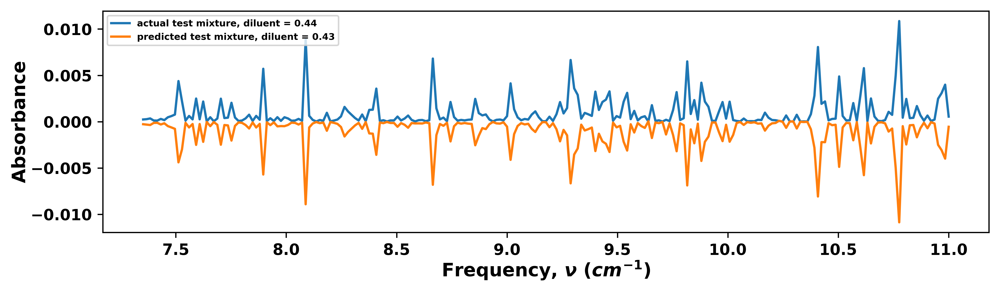

Noise added mixture (validation) concentrations: [0.34 0.   0.   0.   0.   0.   0.   0.   0.22 0.   0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.3392216   0.00036603  0.00066118  0.00034286 -0.00505247  0.00252822
   0.0015066   0.00094427  0.2237494  -0.00083528 -0.00336941  0.00165825]]
Predicted Noise added mixture (validation) concentrations sum : 0.56172127


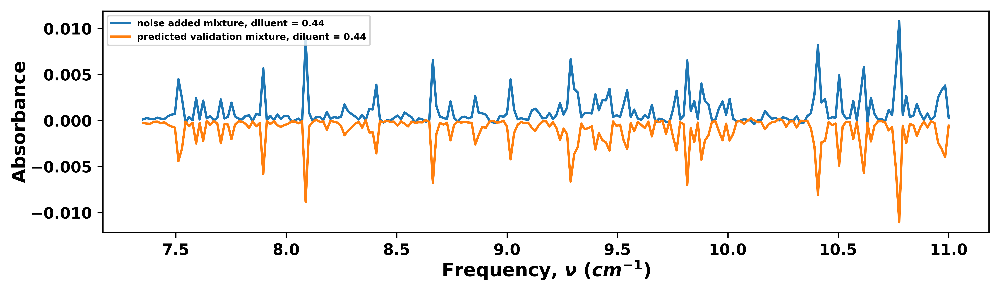

Noise added mixture (validation) concentrations: [0.34 0.   0.   0.   0.   0.   0.   0.   0.22 0.   0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.3392216   0.00036603  0.00066118  0.00034286 -0.00505247  0.00252822
   0.0015066   0.00094427  0.2237494  -0.00083528 -0.00336941  0.00165825]]
Predicted Noise added mixture (validation) concentrations sum : 0.56172127


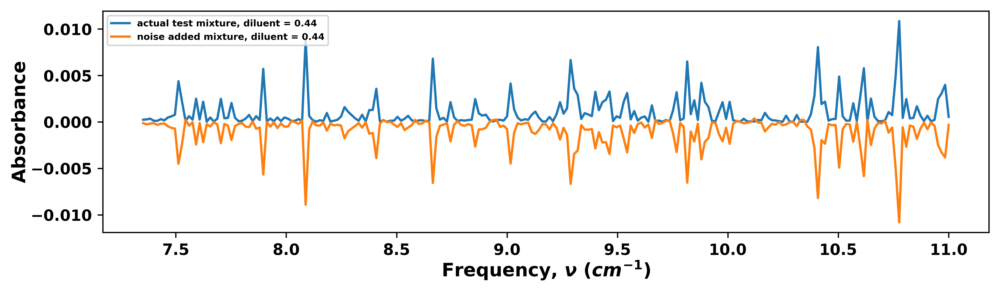

<ipython-input-50-93fef6807b01>:178: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_xticklabels(np.delete(labels,0));


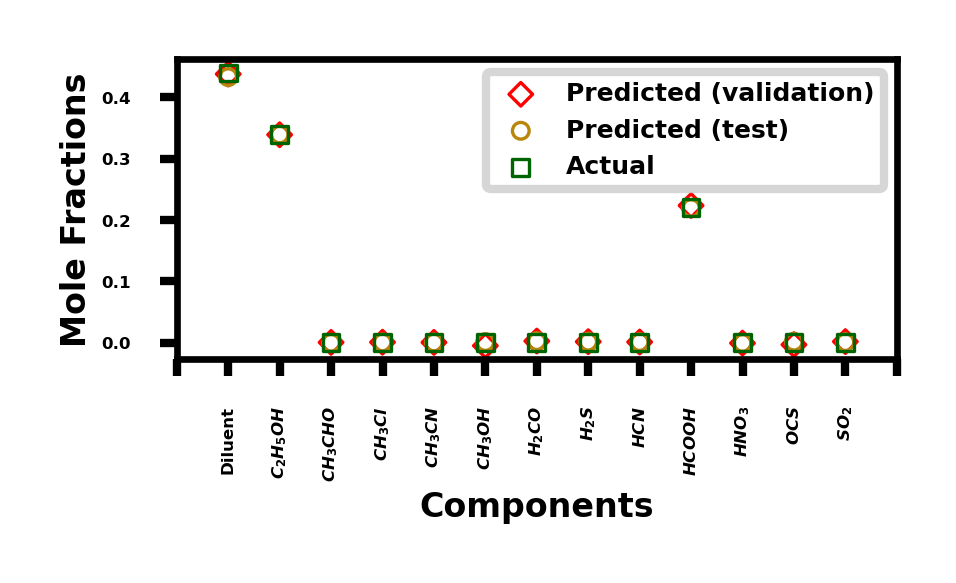

<ipython-input-50-93fef6807b01>:231: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


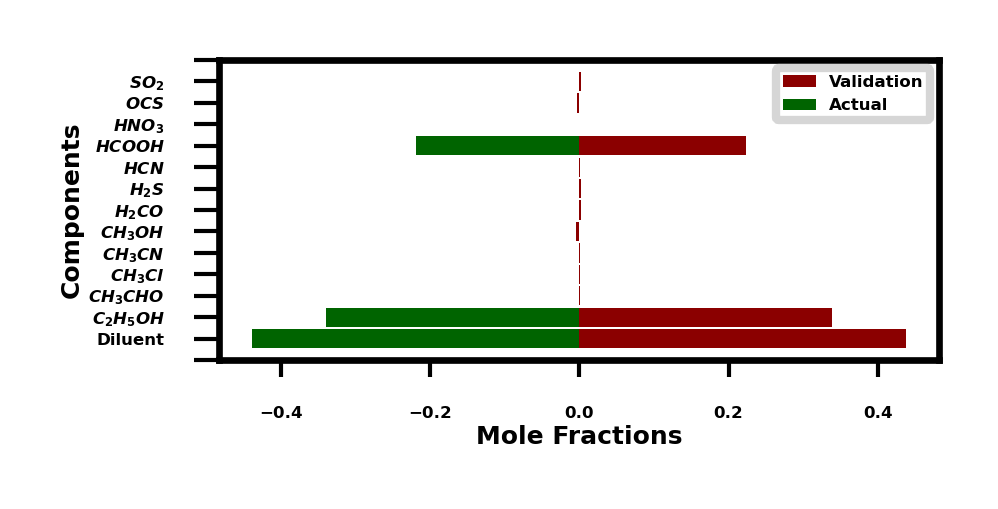

<ipython-input-50-93fef6807b01>:281: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


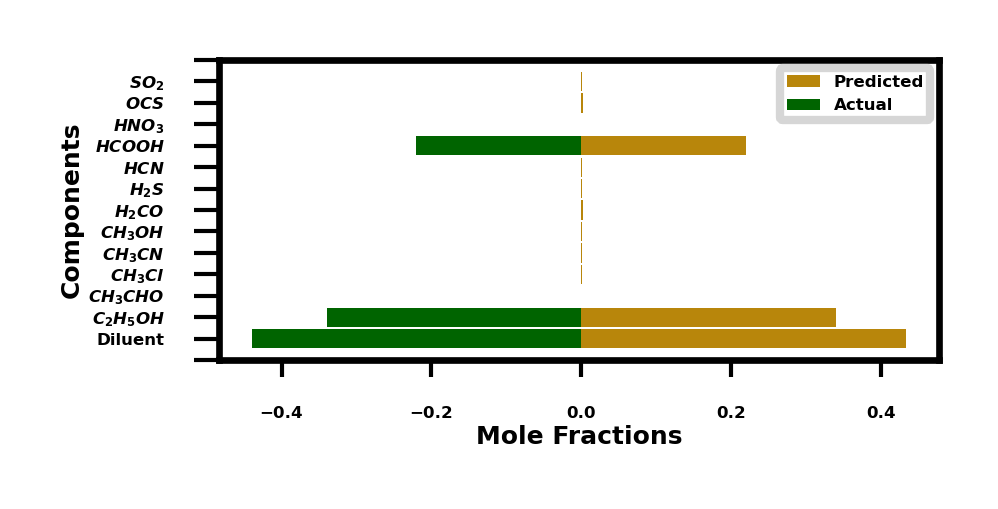

test_mixture2.shape (229, 1)
val_mixture2.shape (229,)
predicted_mixture2_val.shape (229, 1)
     test_mixture2  val_mixture2  predicted_mixture2  predicted_mixture2_val
0         0.000240      0.000132            0.000271                0.000261
1         0.000275      0.000264            0.000313                0.000332
2         0.000354      0.000180            0.000356                0.000357
3         0.000129      0.000131            0.000131                0.000133
4         0.000119      0.000317            0.000118                0.000118
..             ...           ...                 ...                     ...
224       0.000229      0.000427            0.000194                0.000273
225       0.002479      0.002480            0.002495                0.002386
226       0.003091      0.003294            0.003075                0.003090
227       0.003993      0.003809            0.003983                0.003981
228       0.000549      0.000309            0.000548        

In [54]:
bench_noise_add(np.array([0.34,0,0,0,0,0,0,0,0.22,0,0,0]),0.44,"Only_HCOOH_C_2H_5OH", Basis, dfx, 20, linux)

In [1]:
# In next version add synthetic mixtures use Pure experiment spectra as basis to create these mixtures

In [ ]:
#Think gaussian process regression too. b

x_volts.shape (229, 1)
x_volts.shape (229,)
noise_volts.shape (229,)
noise_volts.shape (229,)
y_volts.shape (229,)
val_mixture2.shape (229,)
Test concentrations: [0.33 0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  ]
Predicted concentrations: [[0.24220064 0.02445833 0.01645592 0.00641975 0.01850961 0.02772514
  0.03431793 0.01334887 0.01585307 0.00656244 0.01494801 0.00638243]]
Predicted concentrations sum : 0.42718214


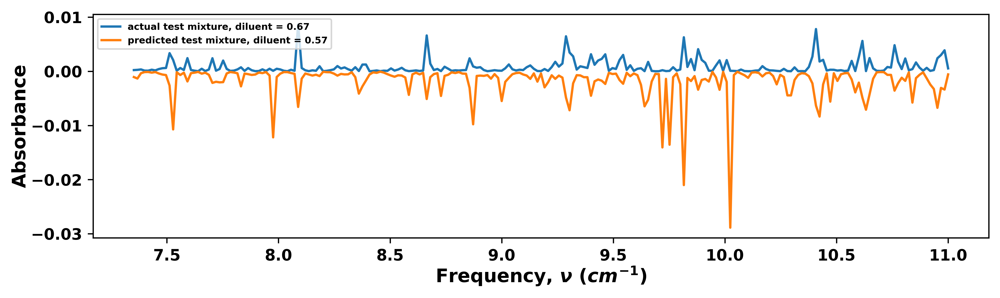

Noise added mixture (validation) concentrations: [0.33 0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[0.2405992  0.02381378 0.01581329 0.00651469 0.02001841 0.02803128
  0.03460185 0.01279069 0.01393335 0.00668649 0.01646617 0.00577723]]
Predicted Noise added mixture (validation) concentrations sum : 0.42504644


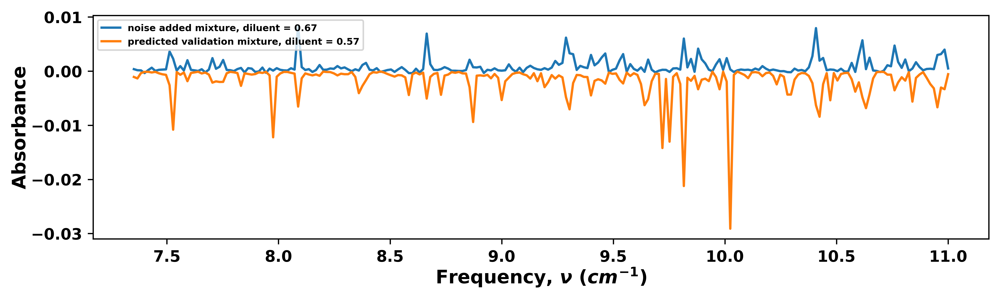

Noise added mixture (validation) concentrations: [0.33 0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[0.2405992  0.02381378 0.01581329 0.00651469 0.02001841 0.02803128
  0.03460185 0.01279069 0.01393335 0.00668649 0.01646617 0.00577723]]
Predicted Noise added mixture (validation) concentrations sum : 0.42504644


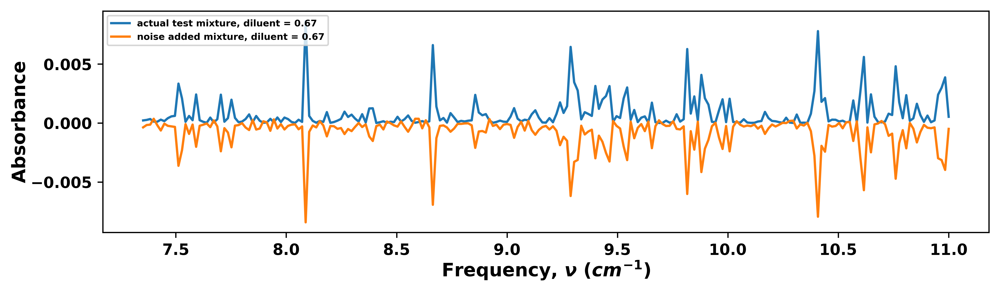

<ipython-input-48-93fef6807b01>:178: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_xticklabels(np.delete(labels,0));


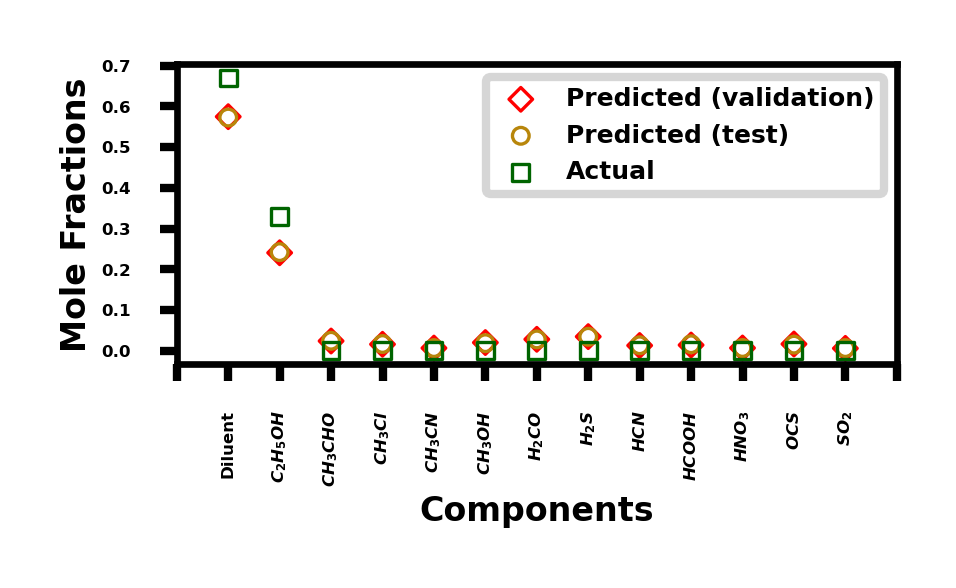

<ipython-input-48-93fef6807b01>:231: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


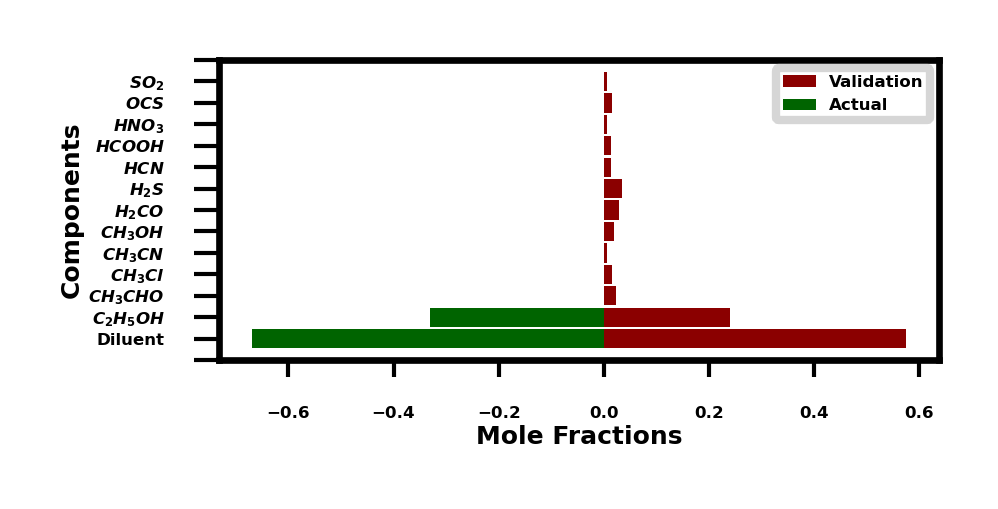

<ipython-input-48-93fef6807b01>:281: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


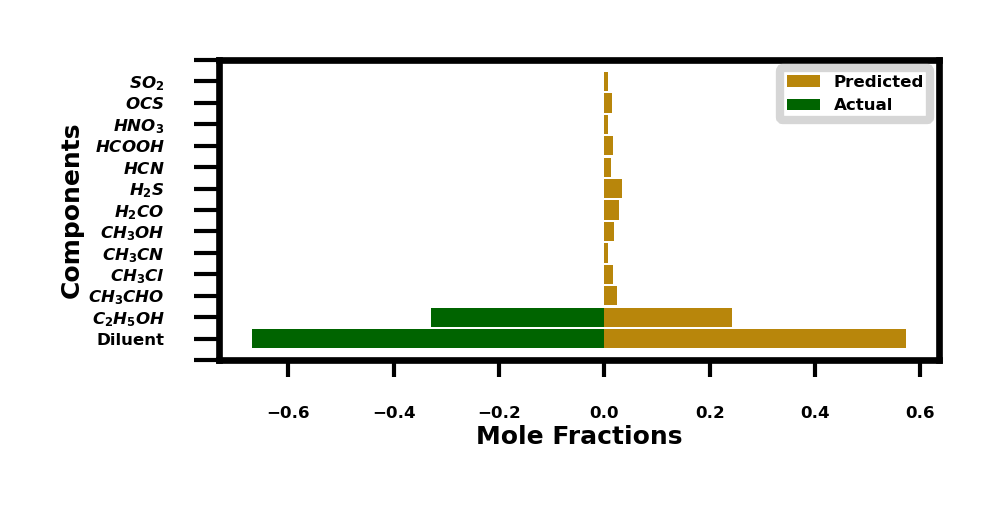

test_mixture2.shape (229, 1)
val_mixture2.shape (229,)
predicted_mixture2_val.shape (229, 1)
     test_mixture2  val_mixture2  predicted_mixture2  predicted_mixture2_val
0         0.000225      0.000364            0.001062                0.001078
1         0.000267      0.000165            0.001335                0.001348
2         0.000343      0.000133            0.000354                0.000353
3         0.000125     -0.000364            0.000146                0.000145
4         0.000115      0.000177            0.000125                0.000124
..             ...           ...                 ...                     ...
224       0.000223      0.000367            0.003263                0.003181
225       0.002405      0.002982            0.006740                0.006683
226       0.002999      0.003139            0.003069                0.003034
227       0.003875      0.003970            0.003372                0.003343
228       0.000533      0.000493            0.000574        

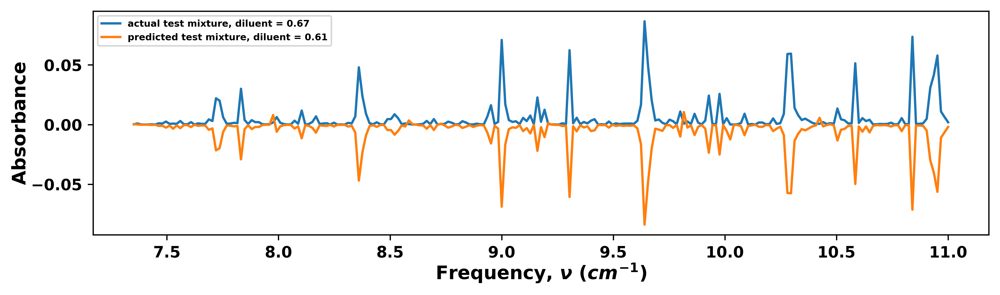

Noise added mixture (validation) concentrations: [0.   0.33 0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.02467026  0.31363097 -0.00153078 -0.00803519 -0.00478126  0.0040552
   0.01695318  0.00398852 -0.02652192  0.01249866  0.05409454  0.00640362]]
Predicted Noise added mixture (validation) concentrations sum : 0.3954258


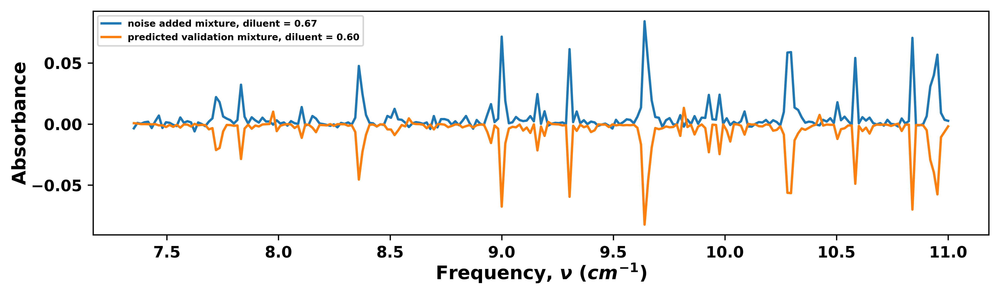

Noise added mixture (validation) concentrations: [0.   0.33 0.   0.   0.   0.   0.   0.   0.   0.   0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.02467026  0.31363097 -0.00153078 -0.00803519 -0.00478126  0.0040552
   0.01695318  0.00398852 -0.02652192  0.01249866  0.05409454  0.00640362]]
Predicted Noise added mixture (validation) concentrations sum : 0.3954258


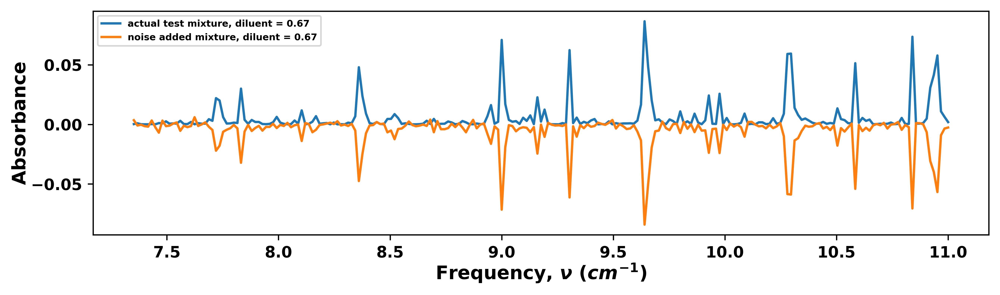

<ipython-input-48-93fef6807b01>:178: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_xticklabels(np.delete(labels,0));


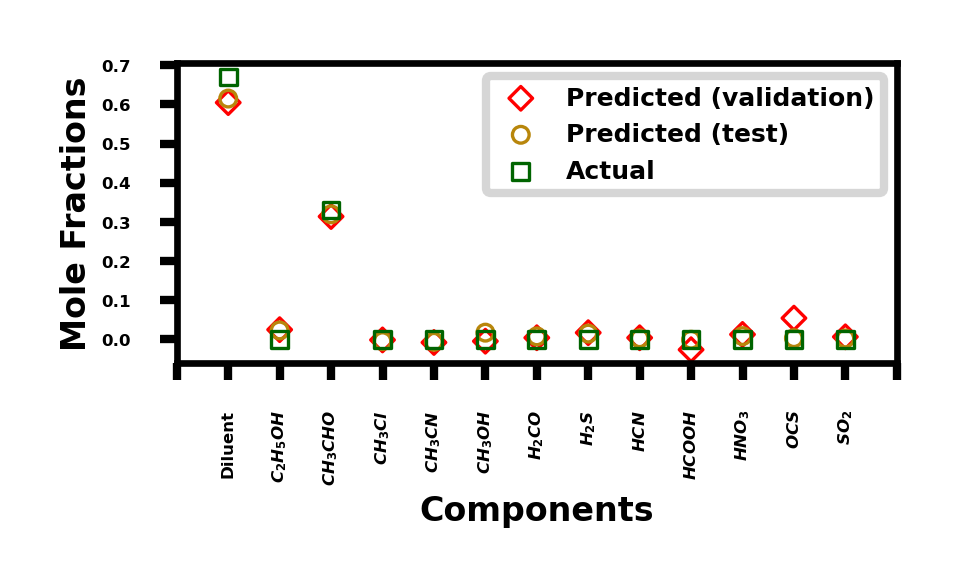

<ipython-input-48-93fef6807b01>:231: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


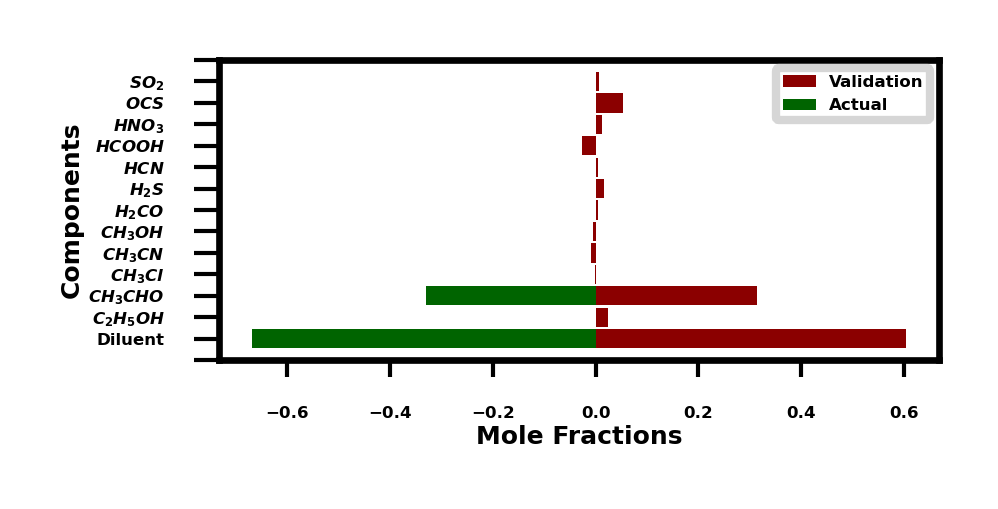

<ipython-input-48-93fef6807b01>:281: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


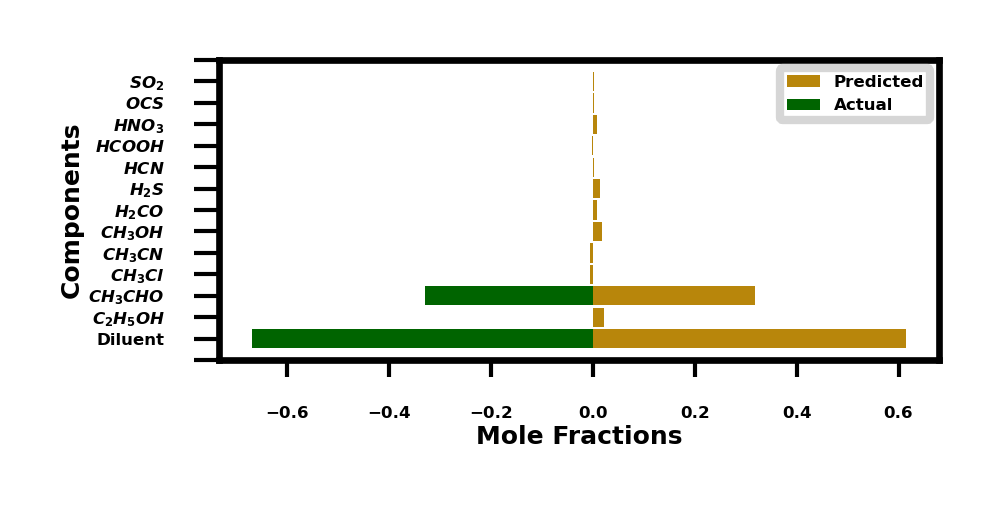

test_mixture2.shape (229, 1)
val_mixture2.shape (229,)
predicted_mixture2_val.shape (229, 1)
     test_mixture2  val_mixture2  predicted_mixture2  predicted_mixture2_val
0         0.000272     -0.003540           -0.000397               -0.000686
1         0.000970      0.000908           -0.000080               -0.000388
2         0.000168      0.000254            0.000114                0.000095
3         0.000076      0.001453            0.000069                0.000074
4         0.000114      0.001862            0.000125                0.000131
..             ...           ...                 ...                     ...
224       0.041579      0.039886            0.040260                0.039563
225       0.057835      0.056726            0.056282                0.057572
226       0.010983      0.009099            0.010897                0.010762
227       0.006321      0.003451            0.006445                0.006356
228       0.001954      0.002597            0.001953        

<ipython-input-48-93fef6807b01>:40: RuntimeWarning: divide by zero encountered in log10
  x_db = 10 * np.log10(x_watts)


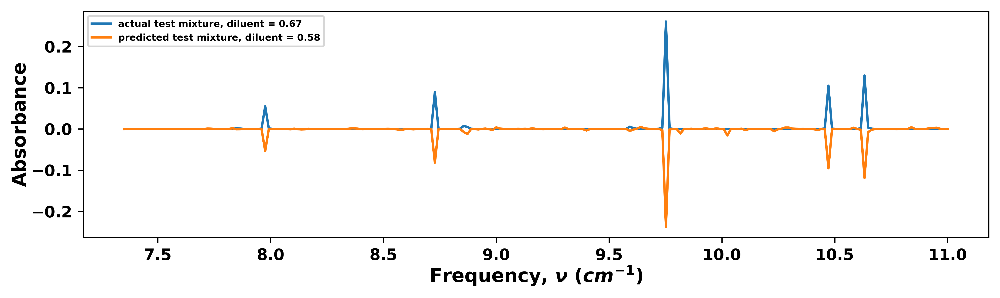

Noise added mixture (validation) concentrations: [0.   0.   0.33 0.   0.   0.   0.   0.   0.   0.   0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.1007091  -0.02412775  0.28021383  0.00643781 -0.02592526  0.01248724
   0.02967787  0.02072532 -0.01496669  0.0096878  -0.02079063 -0.01111318]]
Predicted Noise added mixture (validation) concentrations sum : 0.36301544


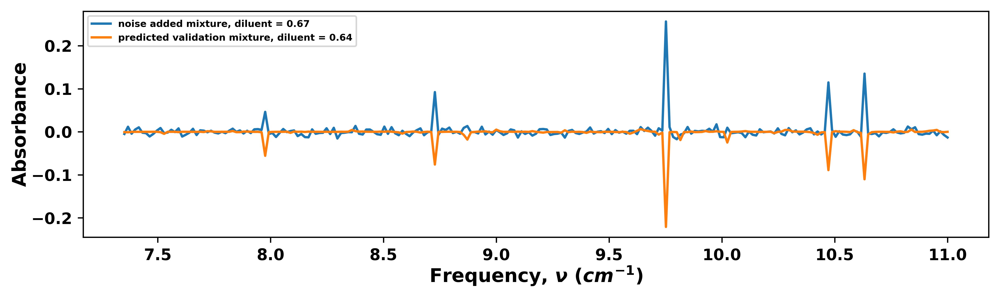

Noise added mixture (validation) concentrations: [0.   0.   0.33 0.   0.   0.   0.   0.   0.   0.   0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.1007091  -0.02412775  0.28021383  0.00643781 -0.02592526  0.01248724
   0.02967787  0.02072532 -0.01496669  0.0096878  -0.02079063 -0.01111318]]
Predicted Noise added mixture (validation) concentrations sum : 0.36301544


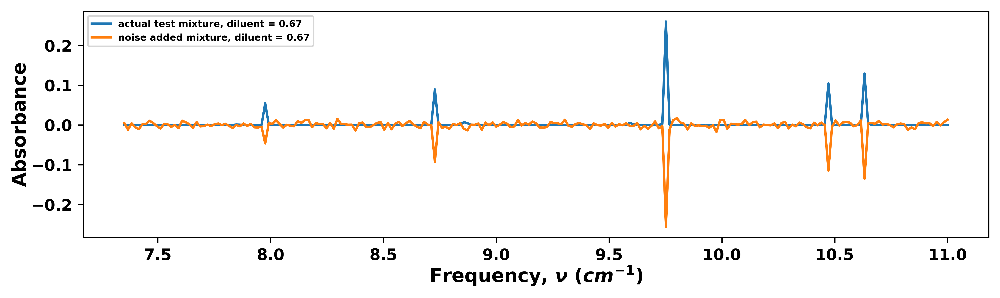

<ipython-input-48-93fef6807b01>:178: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_xticklabels(np.delete(labels,0));


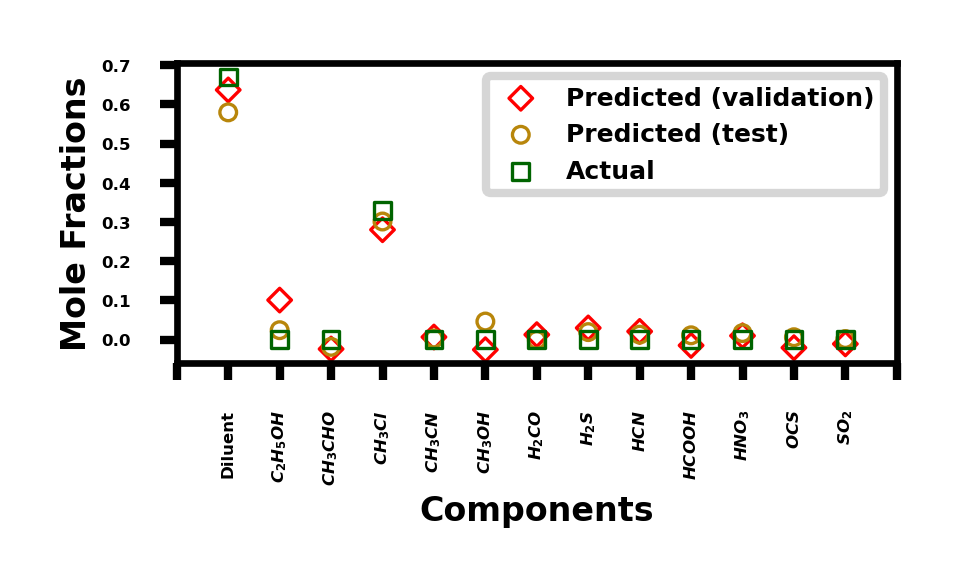

<ipython-input-48-93fef6807b01>:231: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


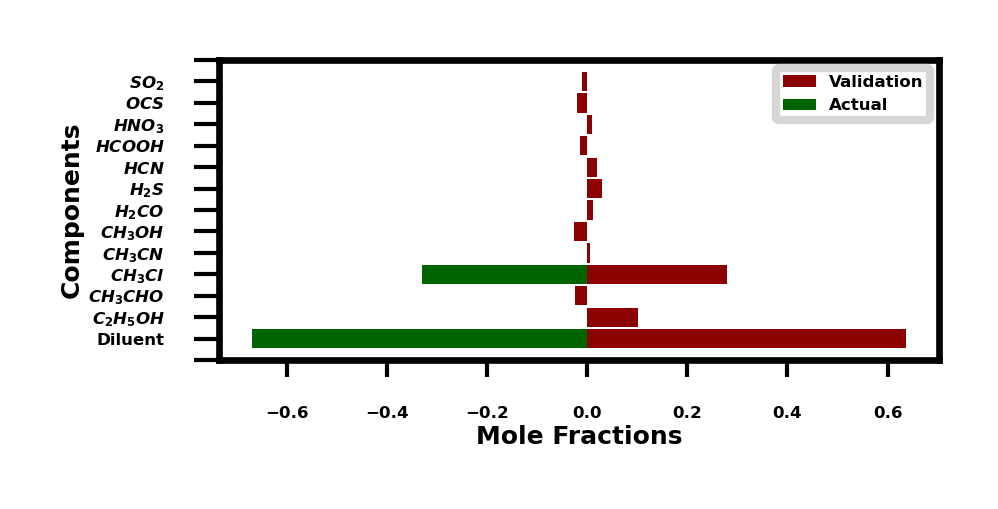

<ipython-input-48-93fef6807b01>:281: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


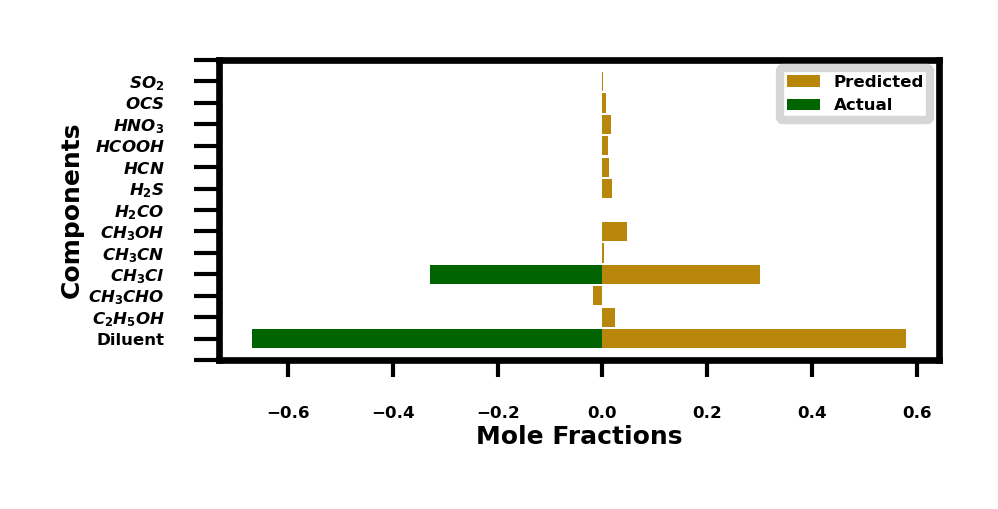

test_mixture2.shape (229, 1)
val_mixture2.shape (229,)
predicted_mixture2_val.shape (229, 1)
     test_mixture2  val_mixture2  predicted_mixture2  predicted_mixture2_val
0     0.000000e+00     -0.005030            0.000546                0.000768
1     0.000000e+00      0.011702            0.000402                0.001081
2     0.000000e+00     -0.004399            0.000065                0.000182
3     0.000000e+00      0.005320            0.000037                0.000047
4     0.000000e+00      0.010352            0.000047                0.000058
..             ...           ...                 ...                     ...
224   0.000000e+00      0.002759           -0.002287               -0.002953
225   0.000000e+00     -0.007972           -0.002752               -0.004373
226   0.000000e+00      0.001062           -0.000269                0.000189
227   2.729483e-58     -0.007217            0.000067                0.000738
228   3.387263e-55     -0.013211           -0.000018        

<ipython-input-48-93fef6807b01>:40: RuntimeWarning: divide by zero encountered in log10
  x_db = 10 * np.log10(x_watts)


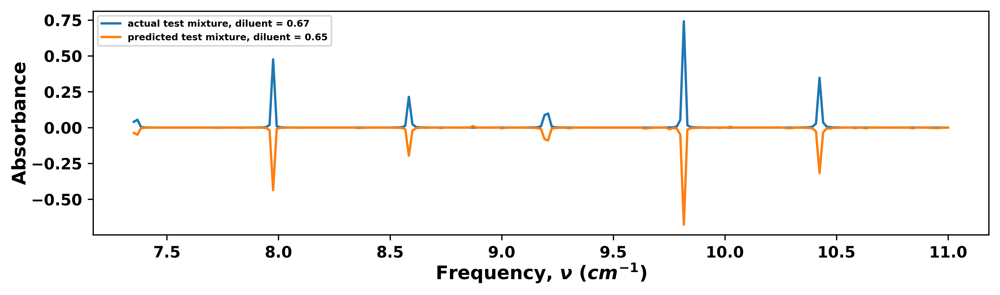

Noise added mixture (validation) concentrations: [0.   0.   0.   0.33 0.   0.   0.   0.   0.   0.   0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.10754656  0.01511776  0.01597271  0.3209077   0.34377527  0.00765363
   0.06960367  0.02368597  0.17649819 -0.06475212 -0.18263578  0.07742292]]
Predicted Noise added mixture (validation) concentrations sum : 0.91079646


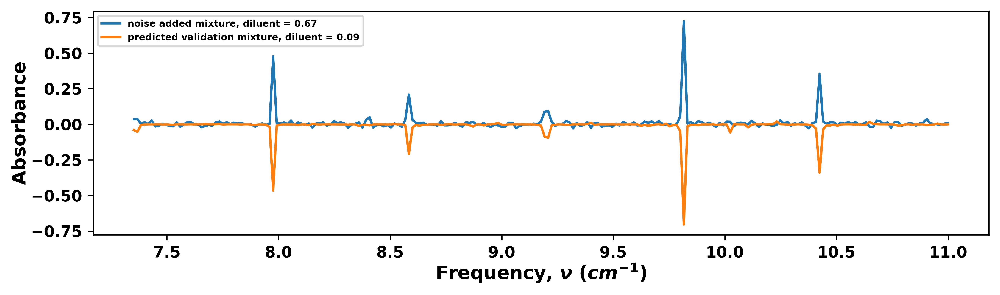

Noise added mixture (validation) concentrations: [0.   0.   0.   0.33 0.   0.   0.   0.   0.   0.   0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.10754656  0.01511776  0.01597271  0.3209077   0.34377527  0.00765363
   0.06960367  0.02368597  0.17649819 -0.06475212 -0.18263578  0.07742292]]
Predicted Noise added mixture (validation) concentrations sum : 0.91079646


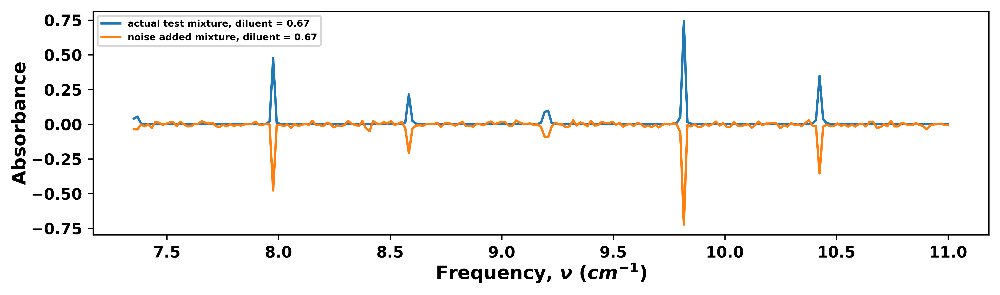

<ipython-input-48-93fef6807b01>:178: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_xticklabels(np.delete(labels,0));


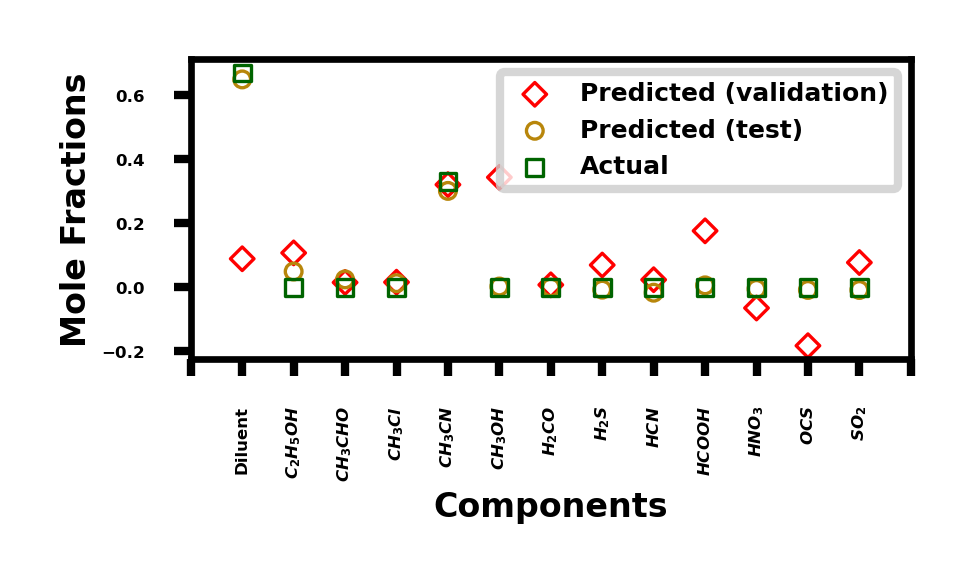

<ipython-input-48-93fef6807b01>:231: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


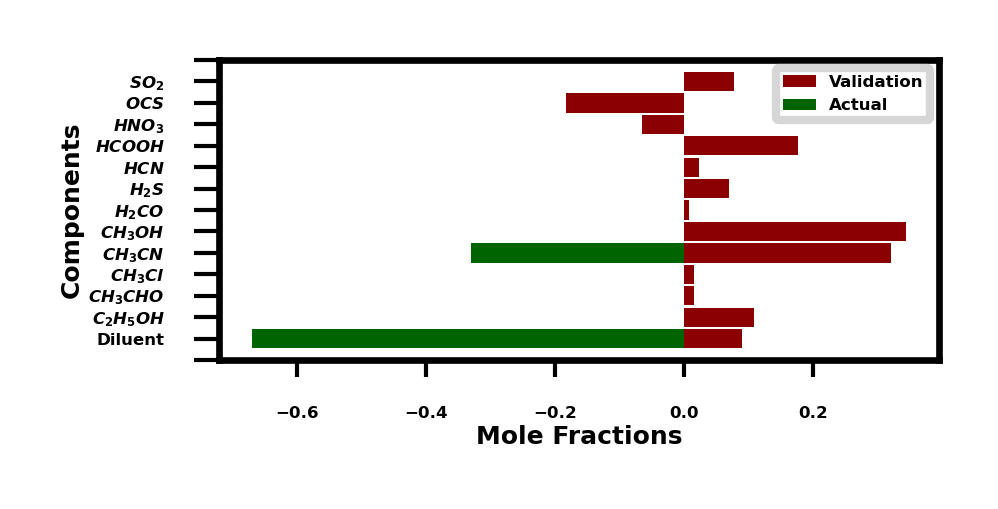

<ipython-input-48-93fef6807b01>:281: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


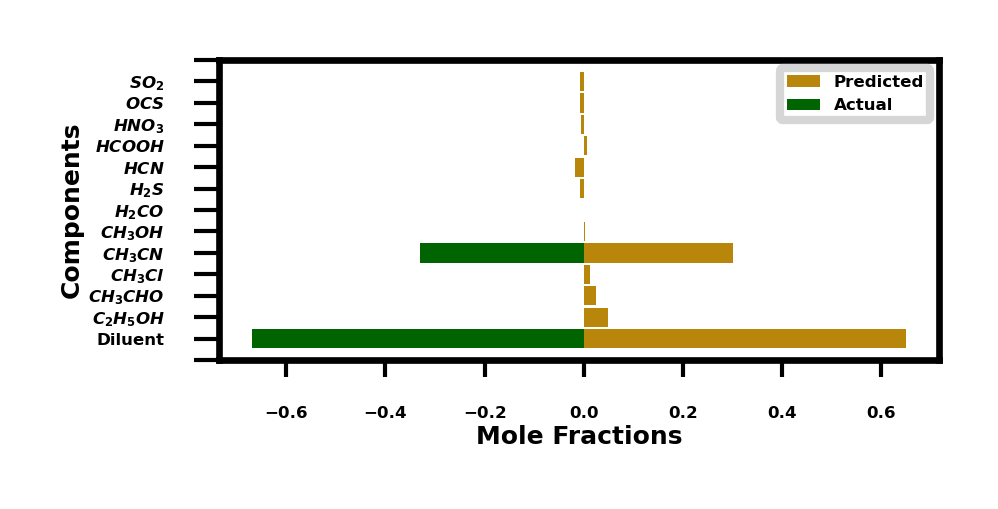

test_mixture2.shape (229, 1)
val_mixture2.shape (229,)
predicted_mixture2_val.shape (229, 1)
     test_mixture2  val_mixture2  predicted_mixture2  predicted_mixture2_val
0     4.035932e-02      0.036340            0.036904                0.040437
1     5.474876e-02      0.037135            0.050110                0.053357
2     4.224169e-03      0.002170            0.003916                0.004178
3     1.432822e-03      0.015147            0.001309                0.001534
4     7.141752e-04      0.001066            0.000662                0.000628
..             ...           ...                 ...                     ...
224   9.335681e-07      0.001468            0.003141                0.001871
225   1.783814e-06     -0.000657            0.004315               -0.004764
226   4.779448e-06     -0.003818            0.001236                0.000980
227   4.889422e-05      0.004532            0.001073                0.001705
228   1.346145e-04      0.007328            0.000318        

<ipython-input-48-93fef6807b01>:40: RuntimeWarning: divide by zero encountered in log10
  x_db = 10 * np.log10(x_watts)


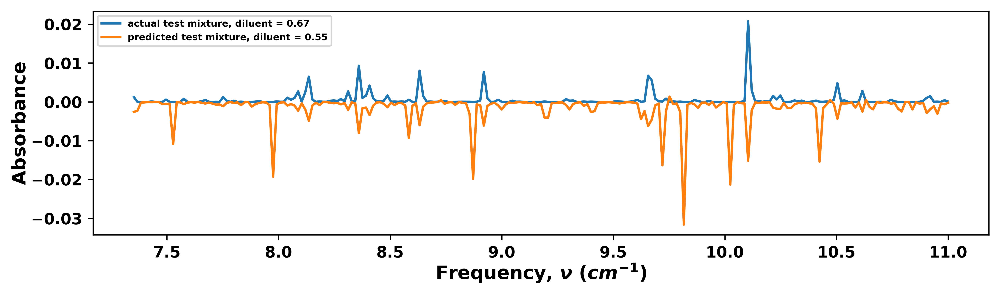

Noise added mixture (validation) concentrations: [0.   0.   0.   0.   0.33 0.   0.   0.   0.   0.   0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.00522034  0.00781435 -0.00024058  0.01402749  0.23427112  0.0310552
   0.02305301  0.02952068  0.01834758  0.00266291  0.03448353  0.03157657]]
Predicted Noise added mixture (validation) concentrations sum : 0.43179217


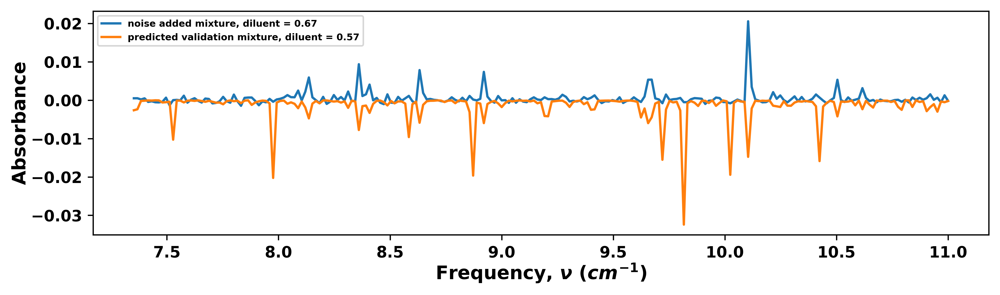

Noise added mixture (validation) concentrations: [0.   0.   0.   0.   0.33 0.   0.   0.   0.   0.   0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.00522034  0.00781435 -0.00024058  0.01402749  0.23427112  0.0310552
   0.02305301  0.02952068  0.01834758  0.00266291  0.03448353  0.03157657]]
Predicted Noise added mixture (validation) concentrations sum : 0.43179217


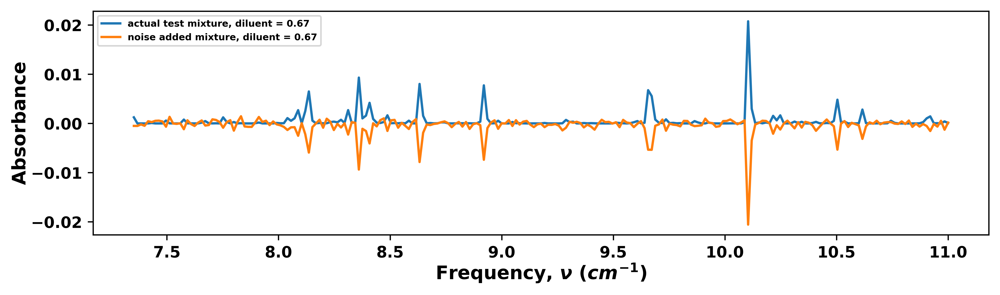

<ipython-input-48-93fef6807b01>:178: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_xticklabels(np.delete(labels,0));


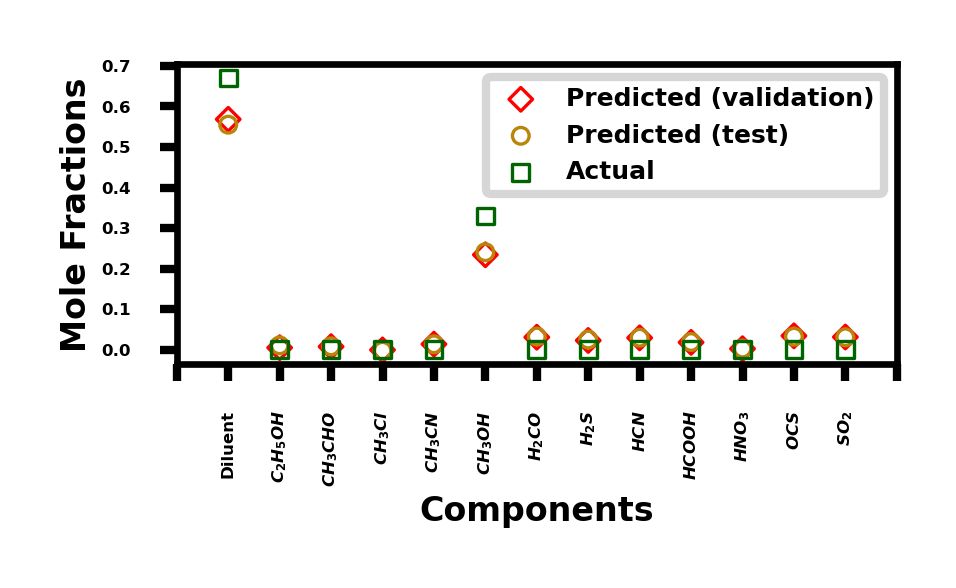

<ipython-input-48-93fef6807b01>:231: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


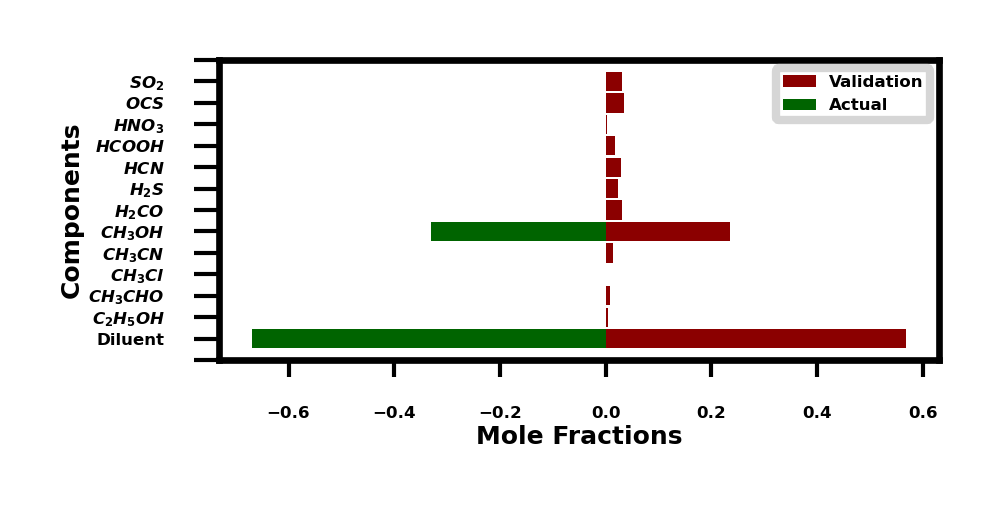

<ipython-input-48-93fef6807b01>:281: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


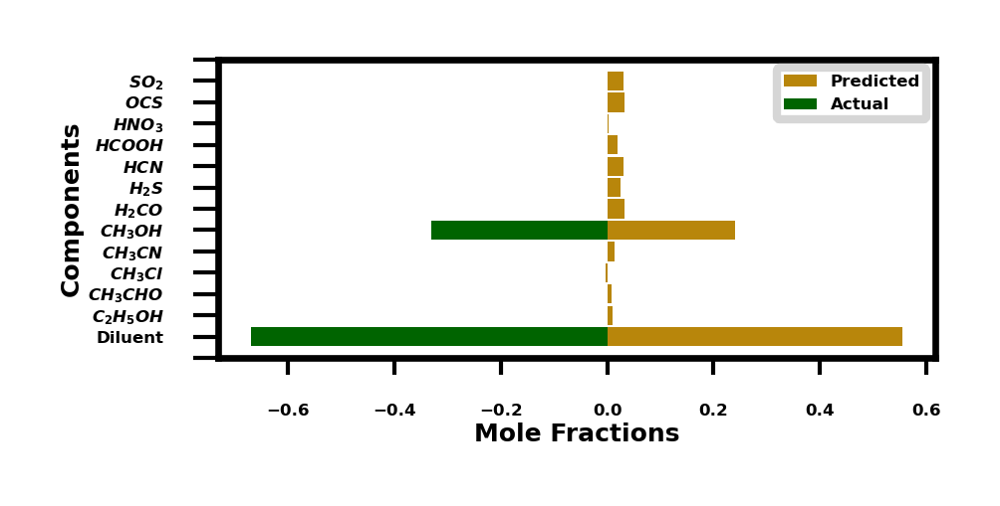

test_mixture2.shape (229, 1)
val_mixture2.shape (229,)
predicted_mixture2_val.shape (229, 1)
     test_mixture2  val_mixture2  predicted_mixture2  predicted_mixture2_val
0     1.241853e-03      0.000501            0.002594                0.002621
1     1.484633e-06      0.000508            0.002289                0.002358
2     2.461168e-10      0.000201            0.000197                0.000196
3     9.381214e-12      0.000481            0.000135                0.000136
4     3.331117e-06     -0.000445            0.000060                0.000058
..             ...           ...                 ...                     ...
224   3.575697e-05      0.000106            0.001122                0.001023
225   5.533228e-05      0.000643            0.003062                0.002980
226   8.877960e-06     -0.000536            0.000418                0.000337
227   4.110095e-04      0.001273            0.000616                0.000524
228   8.718745e-05     -0.000178            0.000221        

<ipython-input-48-93fef6807b01>:40: RuntimeWarning: divide by zero encountered in log10
  x_db = 10 * np.log10(x_watts)


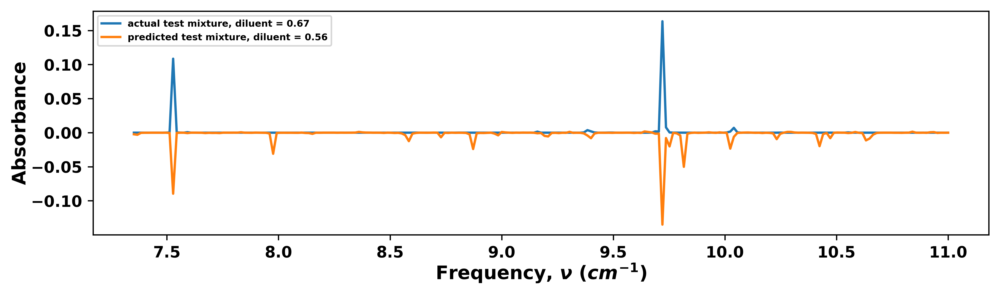

Noise added mixture (validation) concentrations: [0.   0.   0.   0.   0.   0.33 0.   0.   0.   0.   0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[-0.07901662 -0.00660083  0.0213045   0.02697356  0.00063163  0.2774698
   0.02453986  0.04365303 -0.00304294  0.0296334   0.15729043  0.017915  ]]
Predicted Noise added mixture (validation) concentrations sum : 0.51075083


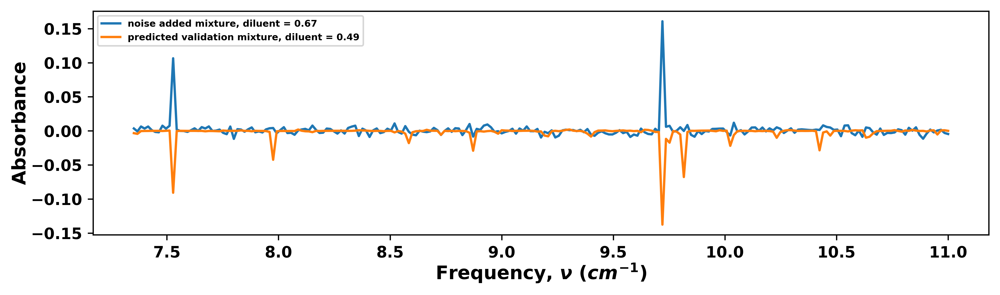

Noise added mixture (validation) concentrations: [0.   0.   0.   0.   0.   0.33 0.   0.   0.   0.   0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[-0.07901662 -0.00660083  0.0213045   0.02697356  0.00063163  0.2774698
   0.02453986  0.04365303 -0.00304294  0.0296334   0.15729043  0.017915  ]]
Predicted Noise added mixture (validation) concentrations sum : 0.51075083


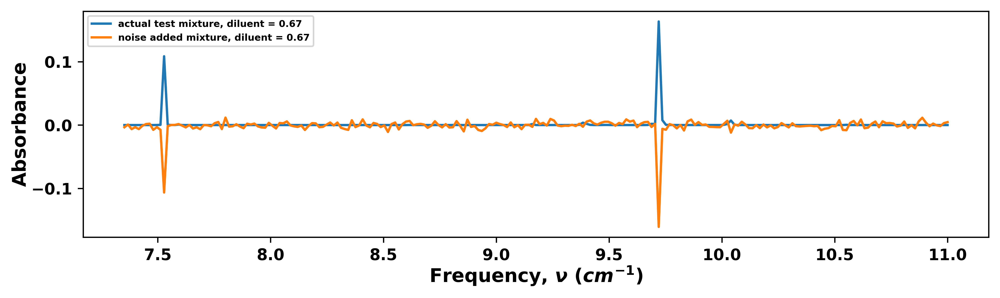

<ipython-input-48-93fef6807b01>:178: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_xticklabels(np.delete(labels,0));


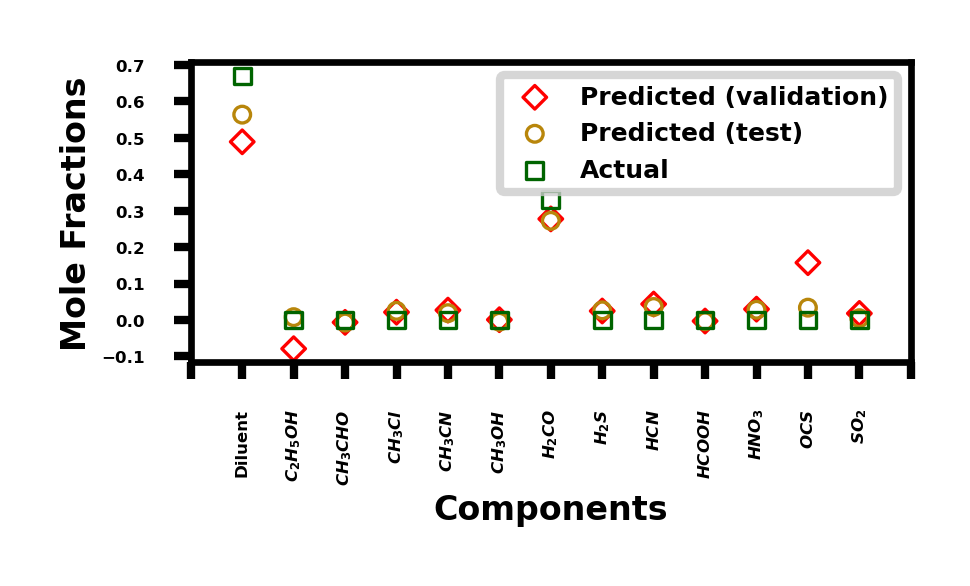

<ipython-input-48-93fef6807b01>:231: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


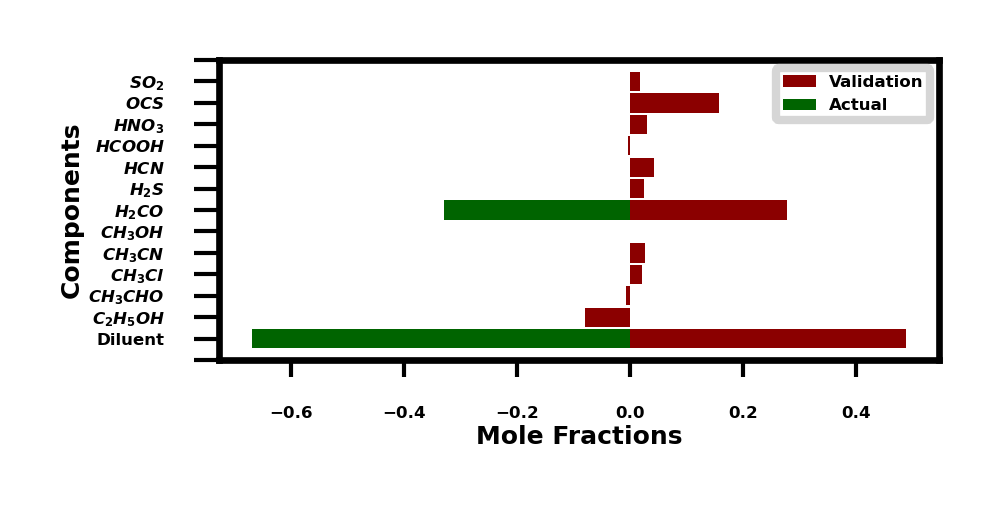

<ipython-input-48-93fef6807b01>:281: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


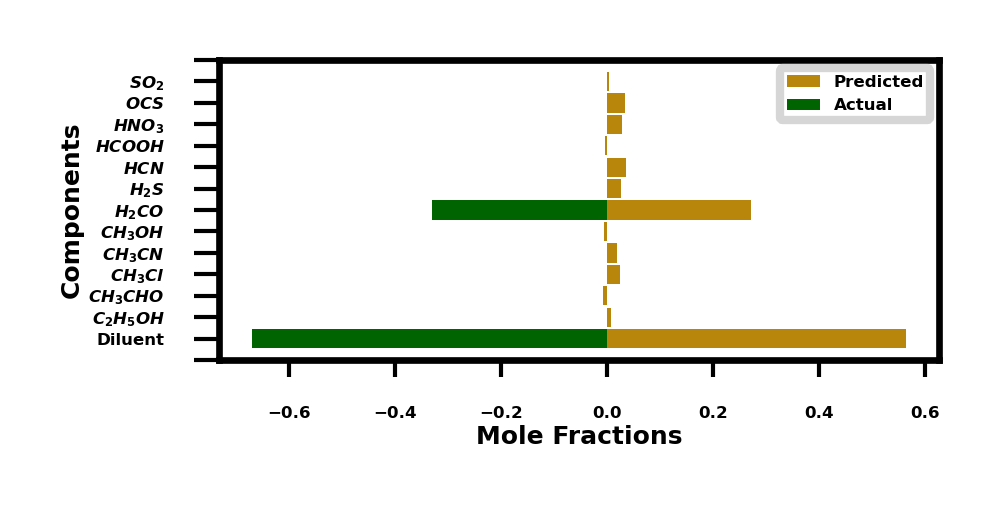

test_mixture2.shape (229, 1)
val_mixture2.shape (229,)
predicted_mixture2_val.shape (229, 1)
     test_mixture2  val_mixture2  predicted_mixture2  predicted_mixture2_val
0     3.459140e-06      0.003531            0.002351                0.003341
1     9.005501e-07     -0.000779            0.003084                0.004402
2     0.000000e+00      0.006406            0.000270                0.000290
3     4.645110e-08      0.003431            0.000123                0.000156
4     5.207077e-11      0.006374            0.000107                0.000106
..             ...           ...                 ...                     ...
224   1.195546e-08     -0.002269           -0.000827               -0.000813
225   0.000000e+00      0.000460            0.000402                0.005295
226   7.904411e-75      0.001601            0.000056               -0.000699
227   3.155937e-74     -0.003072            0.000095               -0.000893
228   1.283278e-71     -0.004616            0.000051        

<ipython-input-48-93fef6807b01>:40: RuntimeWarning: divide by zero encountered in log10
  x_db = 10 * np.log10(x_watts)


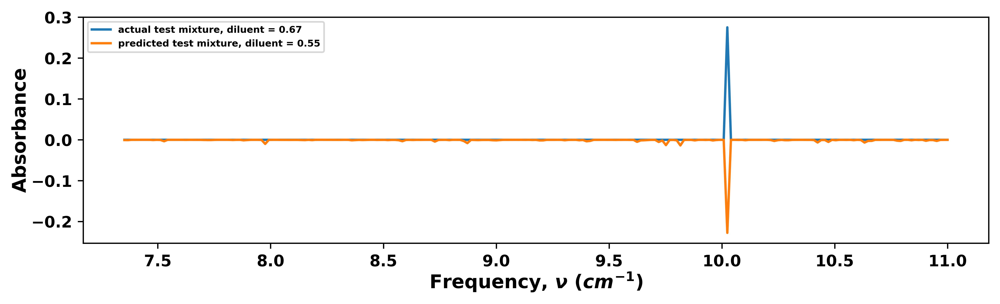

Noise added mixture (validation) concentrations: [0.   0.   0.   0.   0.   0.   0.33 0.   0.   0.   0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.09973679  0.01794616  0.00490815 -0.01199732  0.1009103   0.00356818
   0.28411493  0.0094263  -0.07268301  0.0353612   0.01126959  0.0066284 ]]
Predicted Noise added mixture (validation) concentrations sum : 0.48918965


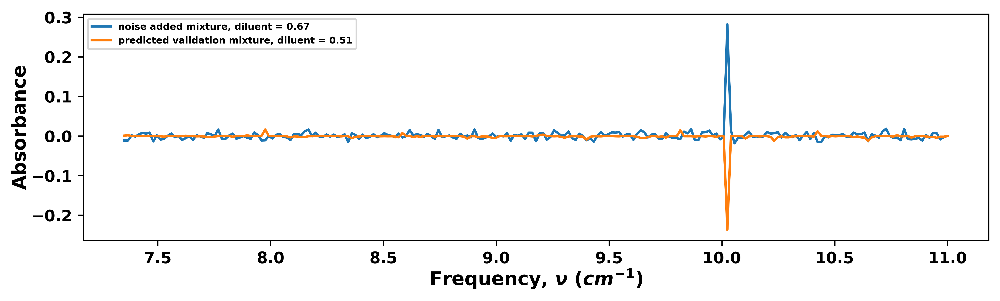

Noise added mixture (validation) concentrations: [0.   0.   0.   0.   0.   0.   0.33 0.   0.   0.   0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.09973679  0.01794616  0.00490815 -0.01199732  0.1009103   0.00356818
   0.28411493  0.0094263  -0.07268301  0.0353612   0.01126959  0.0066284 ]]
Predicted Noise added mixture (validation) concentrations sum : 0.48918965


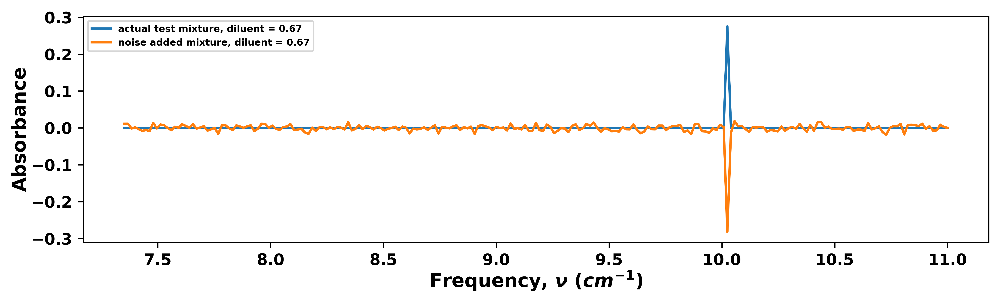

<ipython-input-48-93fef6807b01>:178: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_xticklabels(np.delete(labels,0));


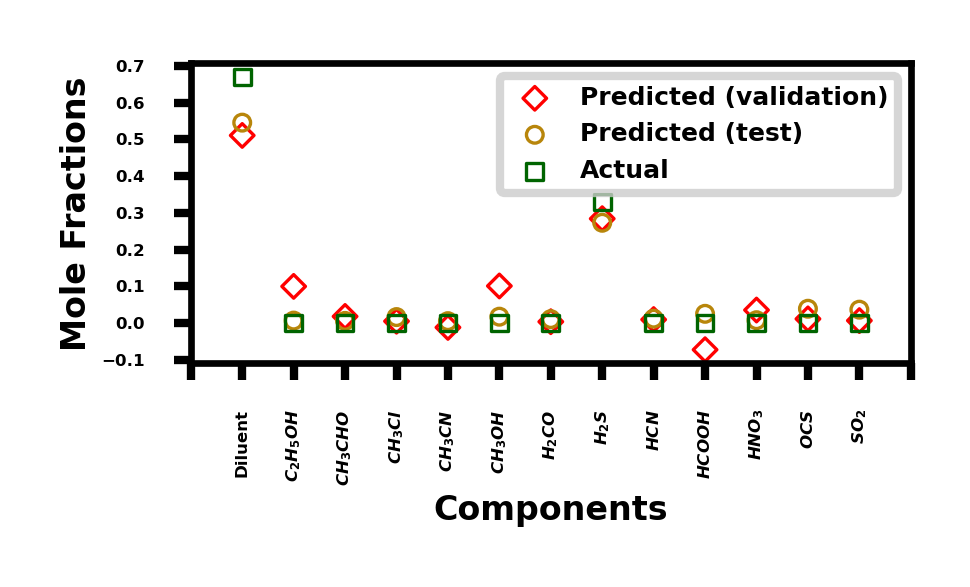

<ipython-input-48-93fef6807b01>:231: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


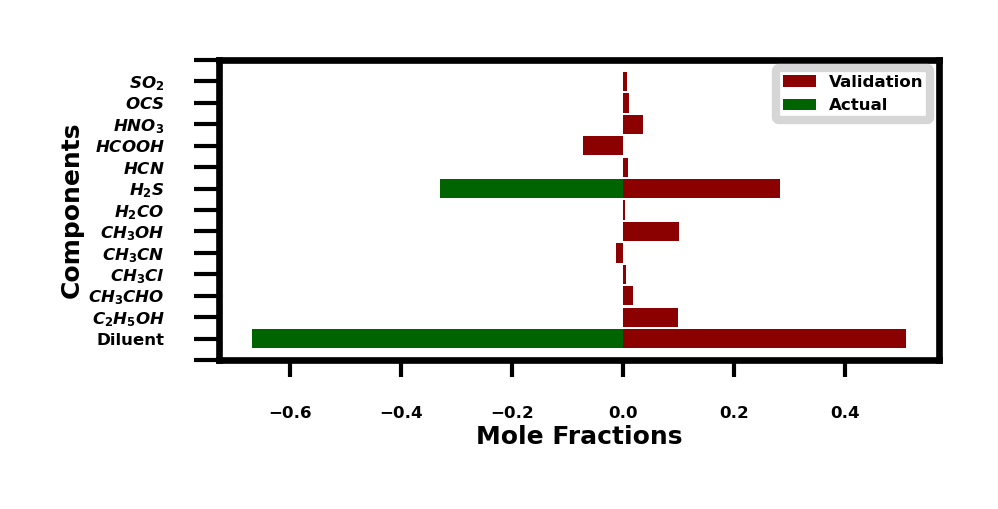

<ipython-input-48-93fef6807b01>:281: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


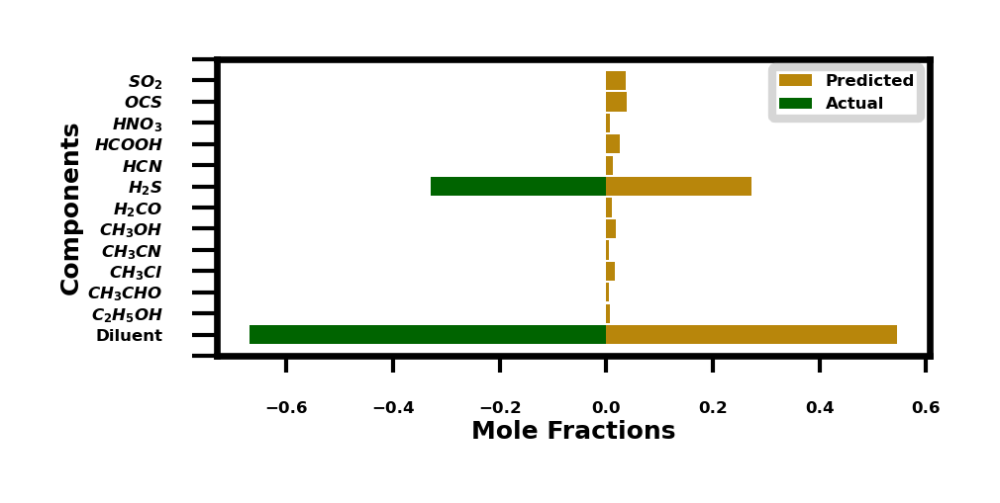

test_mixture2.shape (229, 1)
val_mixture2.shape (229,)
predicted_mixture2_val.shape (229, 1)
     test_mixture2  val_mixture2  predicted_mixture2  predicted_mixture2_val
0     0.000000e+00     -0.011323            0.000729               -0.000894
1     0.000000e+00     -0.011371            0.000874               -0.001846
2     0.000000e+00      0.001636            0.000088               -0.000006
3     0.000000e+00     -0.001505            0.000113                0.000043
4     0.000000e+00      0.003700            0.000050                0.000101
..             ...           ...                 ...                     ...
224   0.000000e+00      0.007526            0.000754                0.002424
225   0.000000e+00      0.006713            0.002808                0.004535
226   0.000000e+00     -0.008720            0.000315                0.001789
227   0.000000e+00     -0.002300            0.000255                0.001823
228   4.052928e-73     -0.000212            0.000158        

<ipython-input-48-93fef6807b01>:40: RuntimeWarning: divide by zero encountered in log10
  x_db = 10 * np.log10(x_watts)


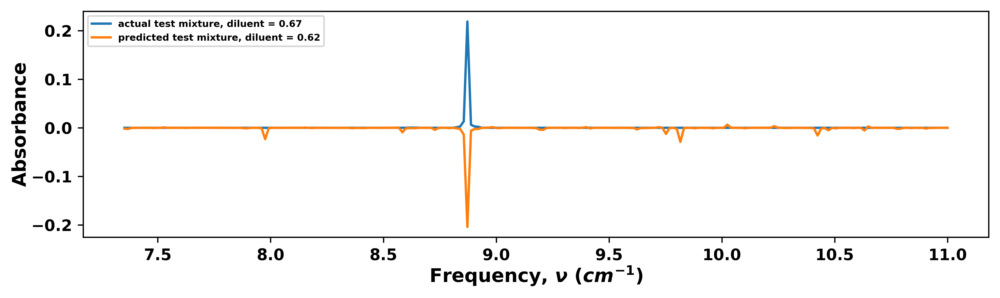

Noise added mixture (validation) concentrations: [0.   0.   0.   0.   0.   0.   0.   0.33 0.   0.   0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[-0.00178516  0.00323012  0.01917597  0.02875675 -0.02521278  0.00454201
  -0.00173251  0.31220108  0.02961141  0.00115688  0.13426651  0.07329934]]
Predicted Noise added mixture (validation) concentrations sum : 0.57750964


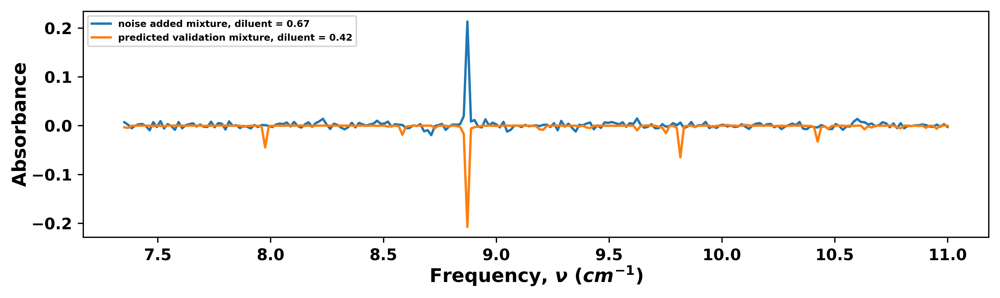

Noise added mixture (validation) concentrations: [0.   0.   0.   0.   0.   0.   0.   0.33 0.   0.   0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[-0.00178516  0.00323012  0.01917597  0.02875675 -0.02521278  0.00454201
  -0.00173251  0.31220108  0.02961141  0.00115688  0.13426651  0.07329934]]
Predicted Noise added mixture (validation) concentrations sum : 0.57750964


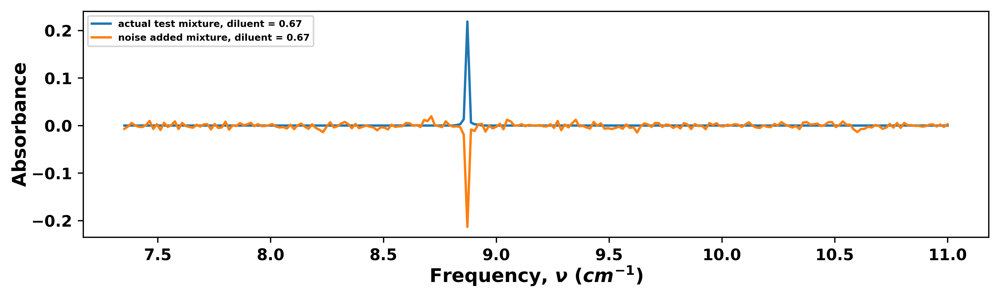

<ipython-input-48-93fef6807b01>:178: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_xticklabels(np.delete(labels,0));


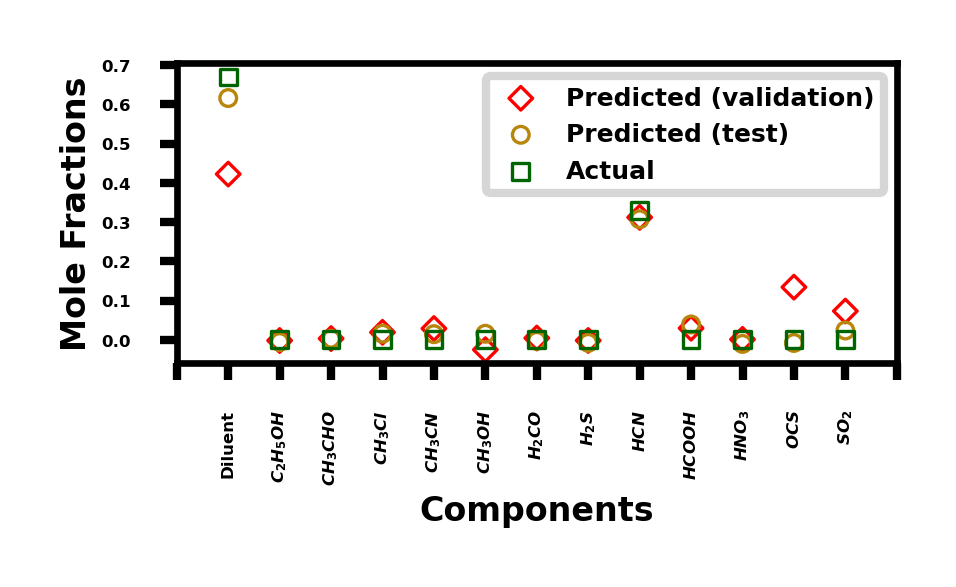

<ipython-input-48-93fef6807b01>:231: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


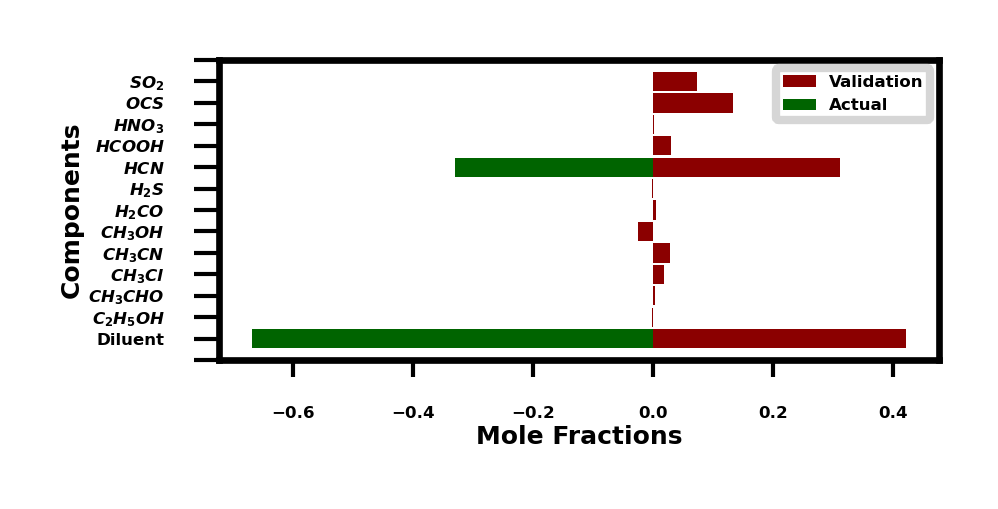

<ipython-input-48-93fef6807b01>:281: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


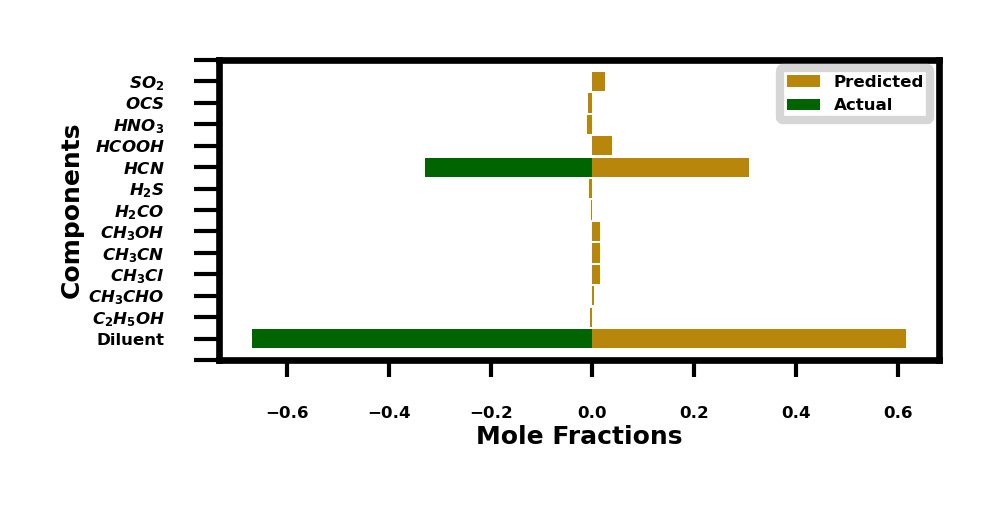

test_mixture2.shape (229, 1)
val_mixture2.shape (229,)
predicted_mixture2_val.shape (229, 1)
     test_mixture2  val_mixture2  predicted_mixture2  predicted_mixture2_val
0     1.691343e-09      0.006961            0.001784                0.003437
1     0.000000e+00      0.001886            0.002383                0.004782
2     0.000000e+00     -0.005420            0.000173                0.000380
3     0.000000e+00     -0.000116            0.000101                0.000284
4     0.000000e+00      0.002693            0.000017                0.000100
..             ...           ...                 ...                     ...
224   0.000000e+00     -0.002356            0.000311                0.000414
225   0.000000e+00      0.002049            0.000041                0.006464
226   0.000000e+00     -0.002241           -0.000044                0.000104
227   0.000000e+00      0.002907           -0.000044                0.000031
228   3.134310e-76     -0.002775            0.000051        

<ipython-input-48-93fef6807b01>:40: RuntimeWarning: divide by zero encountered in log10
  x_db = 10 * np.log10(x_watts)


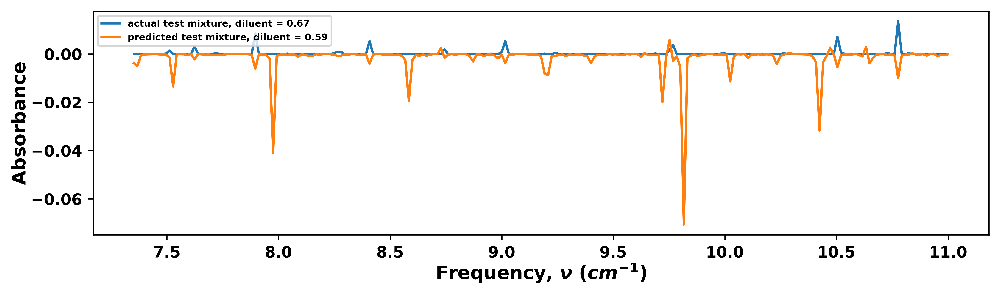

Noise added mixture (validation) concentrations: [0.   0.   0.   0.   0.   0.   0.   0.   0.33 0.   0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.03534332 -0.00220616 -0.00889551  0.02918519  0.02784858  0.03830544
   0.01270009  0.00410355  0.22664486  0.01115651  0.02646487  0.00703515]]
Predicted Noise added mixture (validation) concentrations sum : 0.4076859


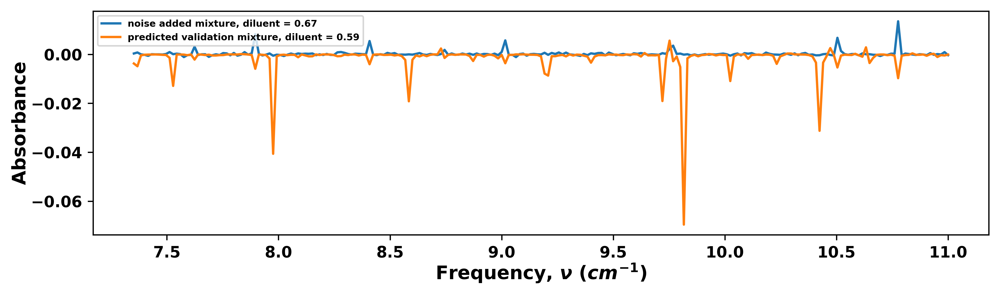

Noise added mixture (validation) concentrations: [0.   0.   0.   0.   0.   0.   0.   0.   0.33 0.   0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.03534332 -0.00220616 -0.00889551  0.02918519  0.02784858  0.03830544
   0.01270009  0.00410355  0.22664486  0.01115651  0.02646487  0.00703515]]
Predicted Noise added mixture (validation) concentrations sum : 0.4076859


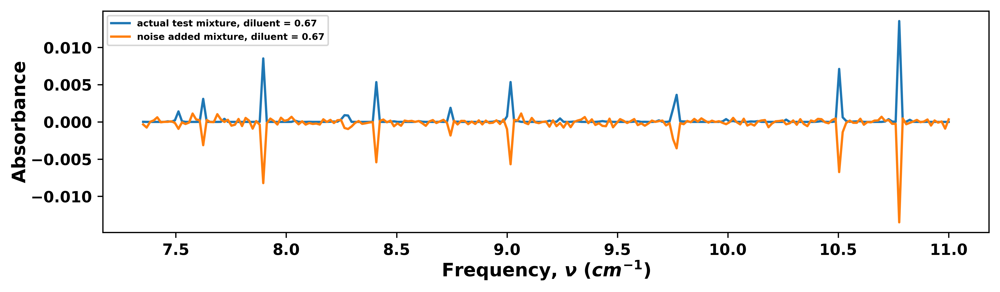

<ipython-input-48-93fef6807b01>:178: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_xticklabels(np.delete(labels,0));


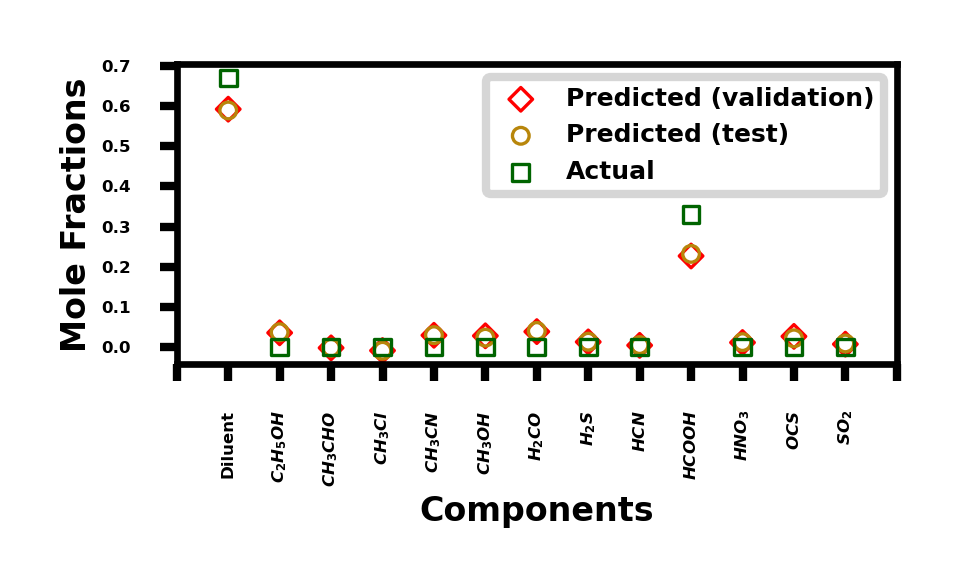

<ipython-input-48-93fef6807b01>:231: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


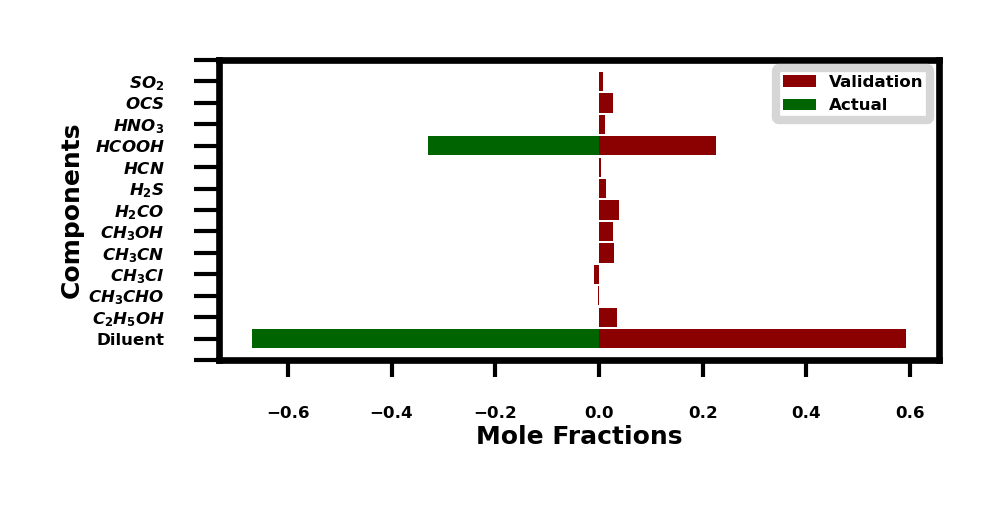

<ipython-input-48-93fef6807b01>:281: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


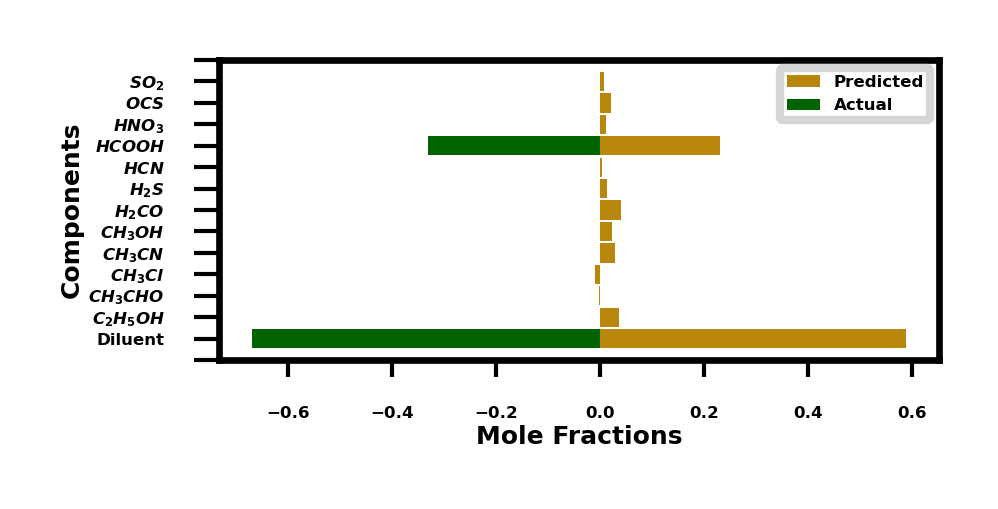

test_mixture2.shape (229, 1)
val_mixture2.shape (229,)
predicted_mixture2_val.shape (229, 1)
     test_mixture2  val_mixture2  predicted_mixture2  predicted_mixture2_val
0     1.280094e-05      0.000339            0.003773                0.003742
1     0.000000e+00      0.000759            0.004929                0.004868
2     3.954207e-08     -0.000018            0.000428                0.000421
3     3.126191e-07     -0.000204            0.000174                0.000167
4     4.685321e-07     -0.000617            0.000109                0.000104
..             ...           ...                 ...                     ...
224   1.318525e-07     -0.000192           -0.000169               -0.000224
225   1.059726e-06      0.000098            0.000957                0.001086
226   1.649622e-06     -0.000060            0.000375                0.000340
227   1.368370e-06      0.000901            0.000497                0.000472
228   3.087102e-08     -0.000338            0.000116        

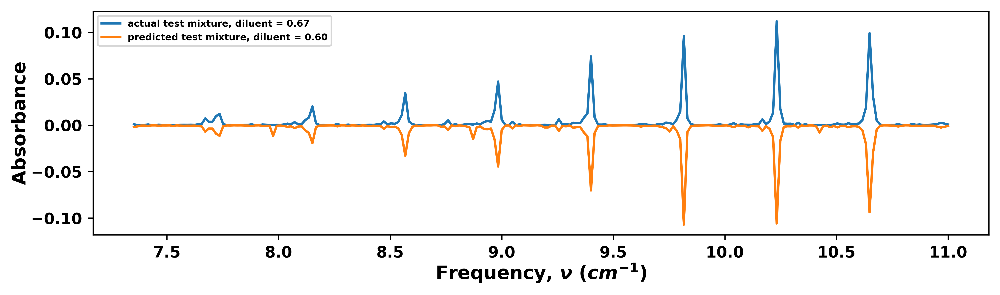

Noise added mixture (validation) concentrations: [0.   0.   0.   0.   0.   0.   0.   0.   0.   0.33 0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.02406116  0.00169497  0.01024418  0.02422755  0.01634608 -0.01203956
   0.01554844  0.02170059 -0.08372708  0.28935406  0.05793186  0.02336795]]
Predicted Noise added mixture (validation) concentrations sum : 0.3887102


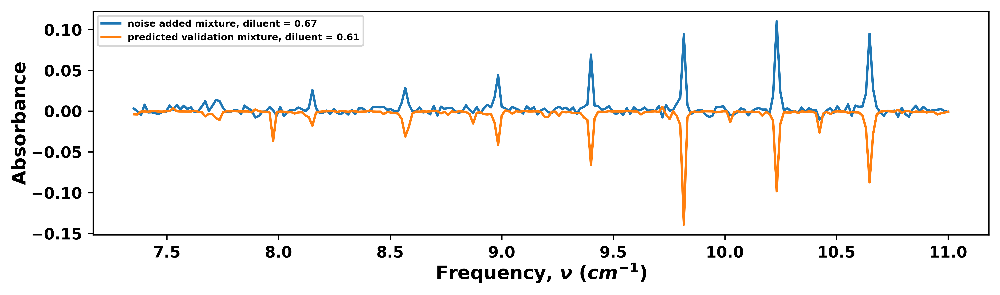

Noise added mixture (validation) concentrations: [0.   0.   0.   0.   0.   0.   0.   0.   0.   0.33 0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.02406116  0.00169497  0.01024418  0.02422755  0.01634608 -0.01203956
   0.01554844  0.02170059 -0.08372708  0.28935406  0.05793186  0.02336795]]
Predicted Noise added mixture (validation) concentrations sum : 0.3887102


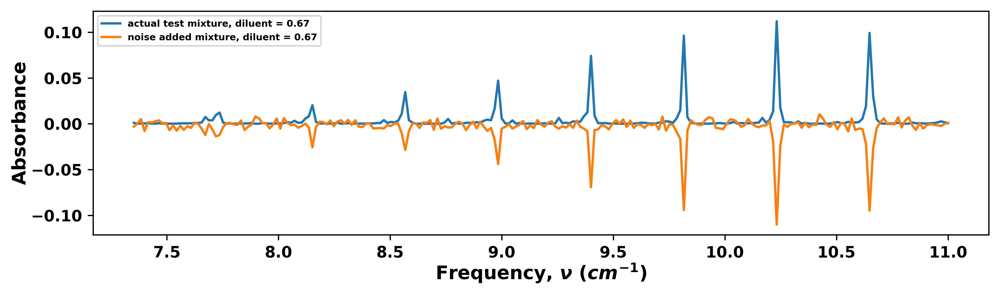

<ipython-input-48-93fef6807b01>:178: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_xticklabels(np.delete(labels,0));


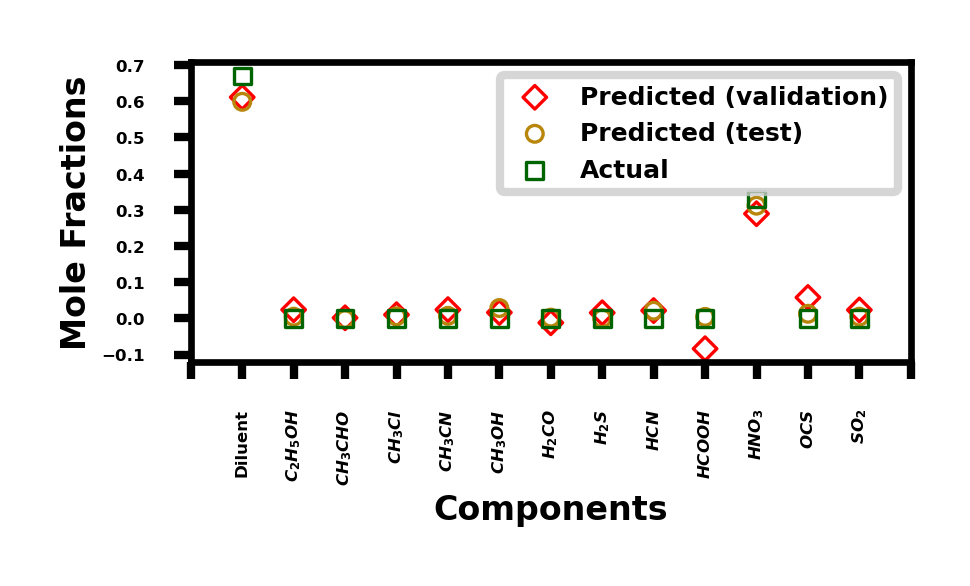

<ipython-input-48-93fef6807b01>:231: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


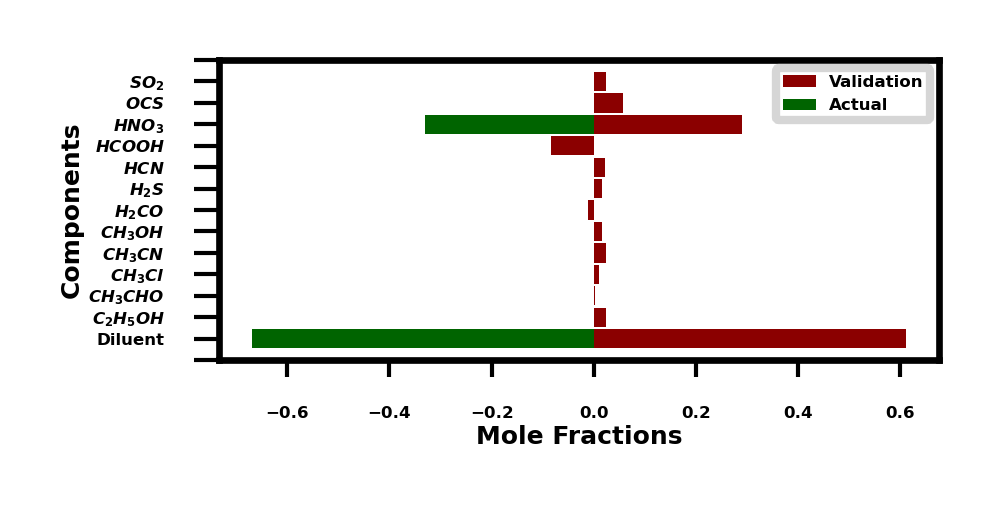

<ipython-input-48-93fef6807b01>:281: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


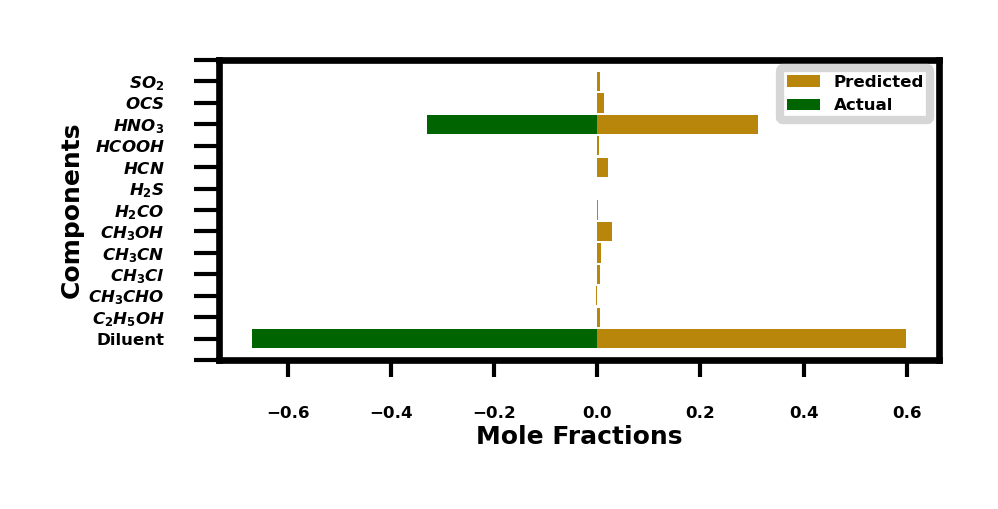

test_mixture2.shape (229, 1)
val_mixture2.shape (229,)
predicted_mixture2_val.shape (229, 1)
     test_mixture2  val_mixture2  predicted_mixture2  predicted_mixture2_val
0         0.001051      0.003058            0.001979                0.003963
1         0.000100     -0.000383            0.001282                0.004133
2         0.000311     -0.004961            0.000390                0.000613
3         0.000359      0.007820            0.000381                0.000479
4         0.000764     -0.001663            0.000740                0.000742
..             ...           ...                 ...                     ...
224       0.000780      0.001061            0.000505                0.000918
225       0.001401      0.001675            0.001592                0.004250
226       0.002642      0.002480            0.002475                0.002593
227       0.001712      0.000131            0.001673                0.001843
228       0.000750     -0.001070            0.000726        

<ipython-input-48-93fef6807b01>:40: RuntimeWarning: divide by zero encountered in log10
  x_db = 10 * np.log10(x_watts)


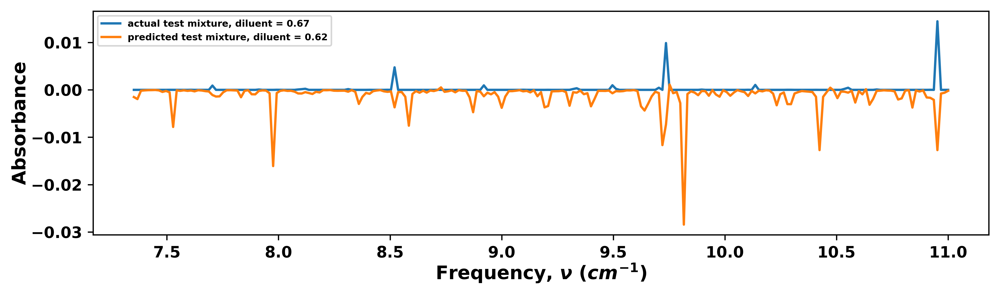

Noise added mixture (validation) concentrations: [0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.33 0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.02030332  0.0170732  -0.0019002   0.01223373  0.01726422  0.02341856
   0.00132954  0.00624107  0.02916499  0.00828301  0.22124931  0.01994275]]
Predicted Noise added mixture (validation) concentrations sum : 0.3746035


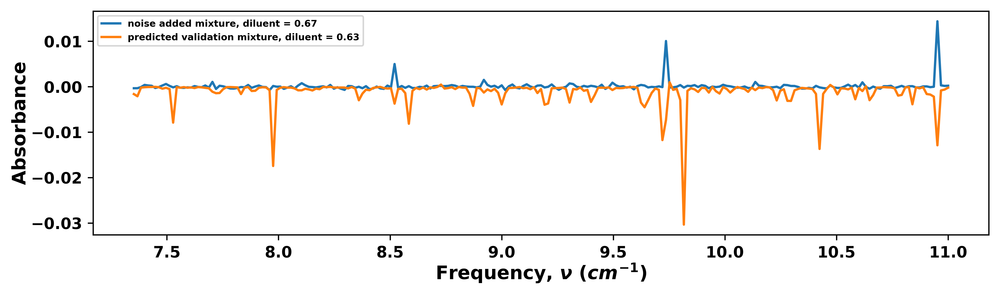

Noise added mixture (validation) concentrations: [0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.33 0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.02030332  0.0170732  -0.0019002   0.01223373  0.01726422  0.02341856
   0.00132954  0.00624107  0.02916499  0.00828301  0.22124931  0.01994275]]
Predicted Noise added mixture (validation) concentrations sum : 0.3746035


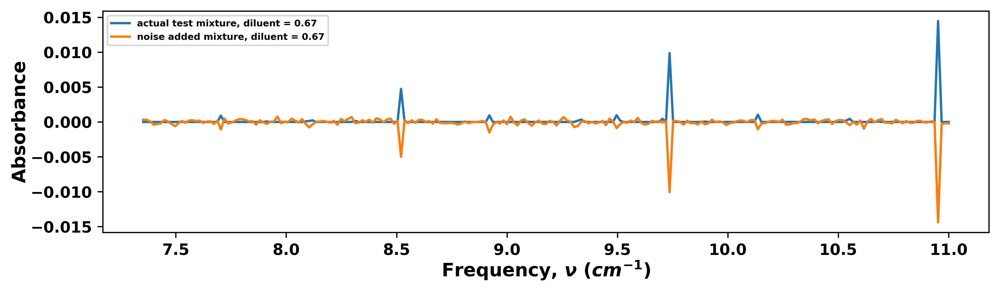

<ipython-input-48-93fef6807b01>:178: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_xticklabels(np.delete(labels,0));


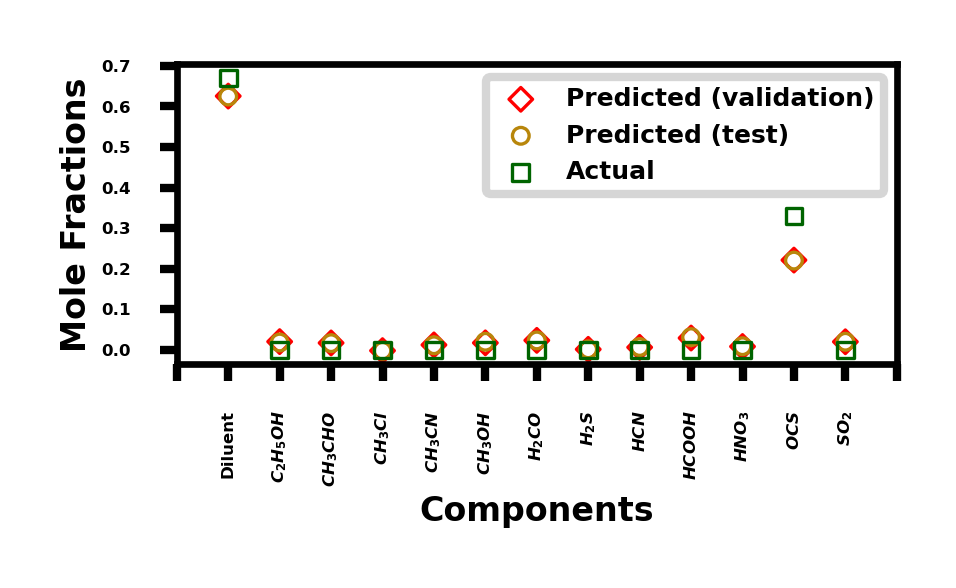

<ipython-input-48-93fef6807b01>:231: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


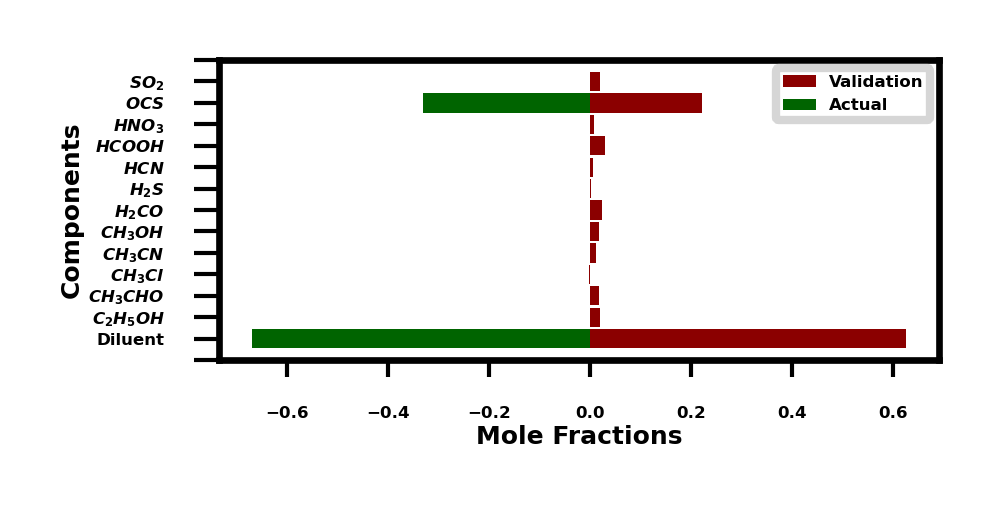

<ipython-input-48-93fef6807b01>:281: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


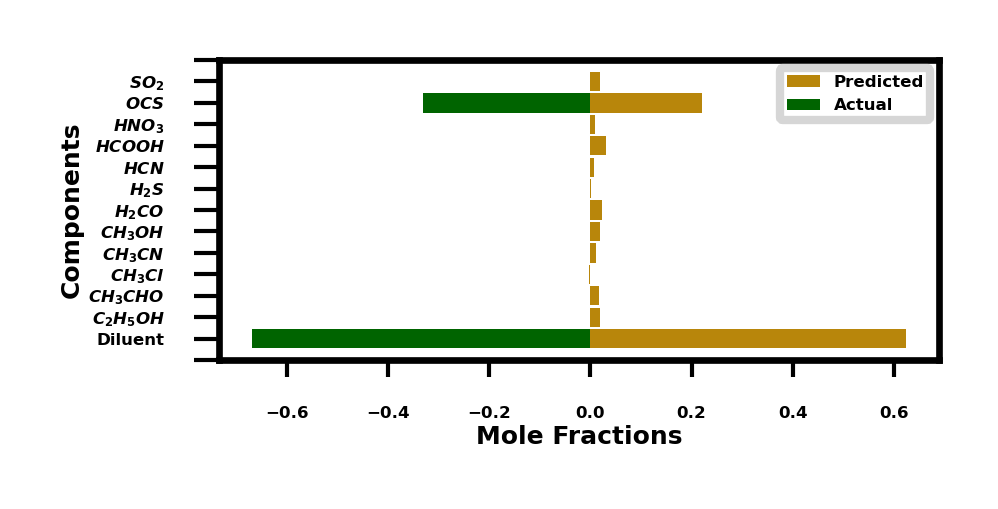

test_mixture2.shape (229, 1)
val_mixture2.shape (229,)
predicted_mixture2_val.shape (229, 1)
     test_mixture2  val_mixture2  predicted_mixture2  predicted_mixture2_val
0     0.000000e+00     -0.000336            0.001518                0.001619
1     0.000000e+00     -0.000329            0.001945                0.002100
2     0.000000e+00     -0.000075            0.000184                0.000197
3     0.000000e+00      0.000393            0.000113                0.000117
4     0.000000e+00      0.000271            0.000067                0.000068
..             ...           ...                 ...                     ...
224   0.000000e+00     -0.000006            0.002114                0.002189
225   1.446782e-02      0.014389            0.012713                0.012885
226   0.000000e+00      0.000301            0.000787                0.000821
227   0.000000e+00      0.000174            0.000605                0.000635
228   7.634160e-73      0.000215            0.000206        

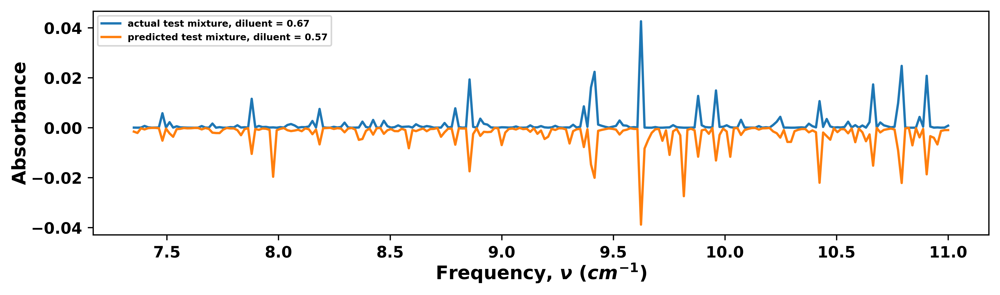

Noise added mixture (validation) concentrations: [0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.33]
Predicted Noise added mixture (validation) concentrations: [[0.01892726 0.03415856 0.01361613 0.00992815 0.00560418 0.0095523
  0.01317621 0.00335874 0.01671584 0.00169799 0.01441193 0.28736374]]
Predicted Noise added mixture (validation) concentrations sum : 0.42851102


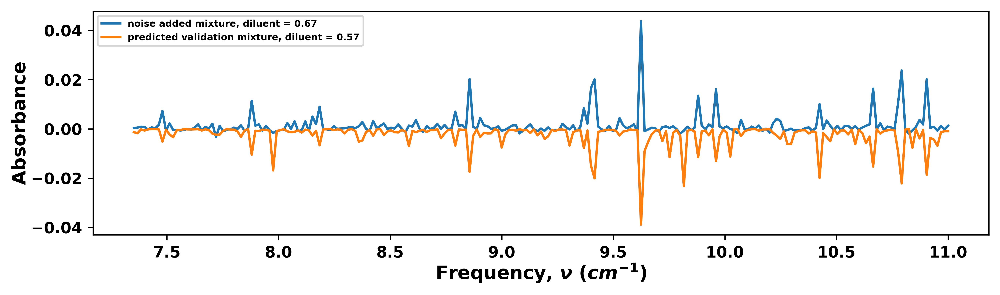

Noise added mixture (validation) concentrations: [0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.   0.33]
Predicted Noise added mixture (validation) concentrations: [[0.01892726 0.03415856 0.01361613 0.00992815 0.00560418 0.0095523
  0.01317621 0.00335874 0.01671584 0.00169799 0.01441193 0.28736374]]
Predicted Noise added mixture (validation) concentrations sum : 0.42851102


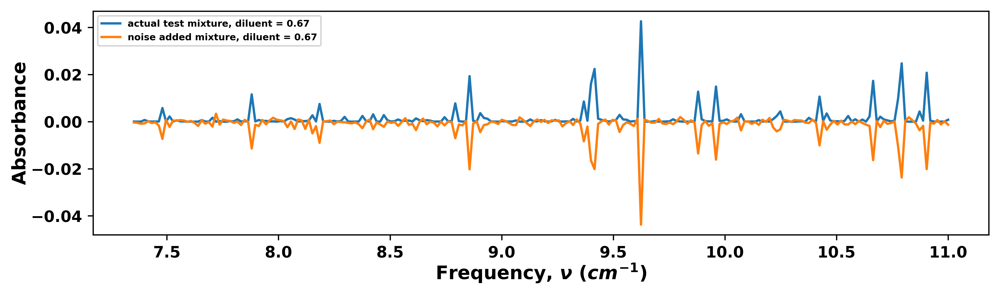

<ipython-input-48-93fef6807b01>:178: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_xticklabels(np.delete(labels,0));


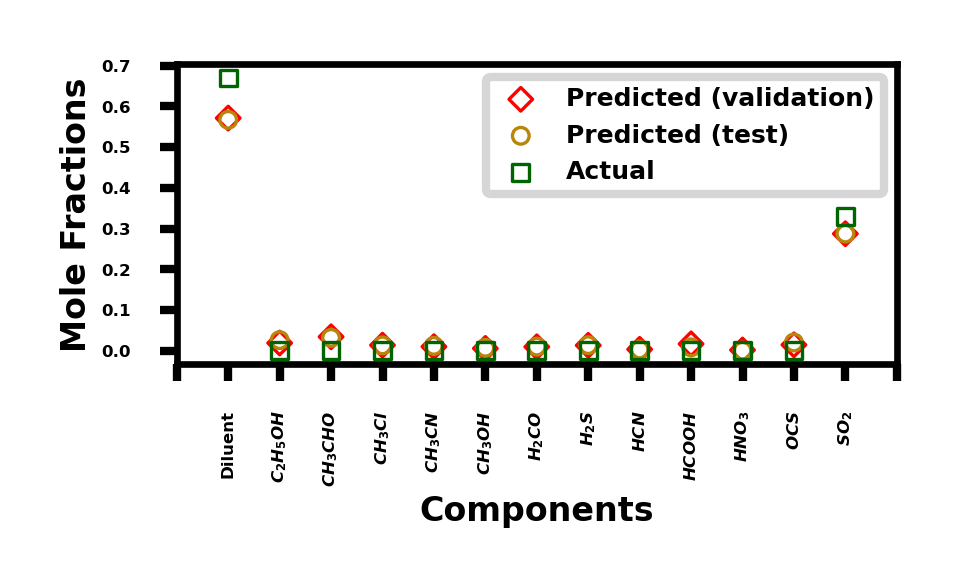

<ipython-input-48-93fef6807b01>:231: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


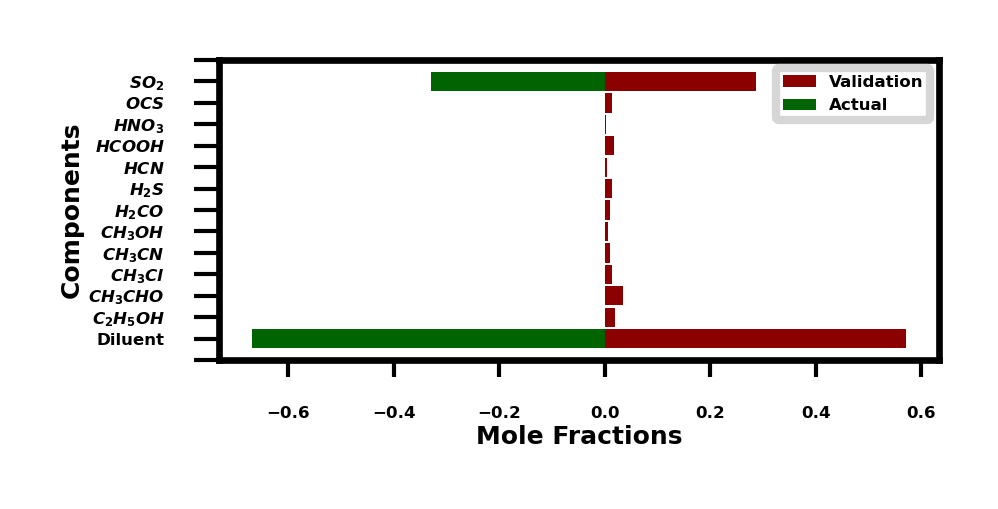

<ipython-input-48-93fef6807b01>:281: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


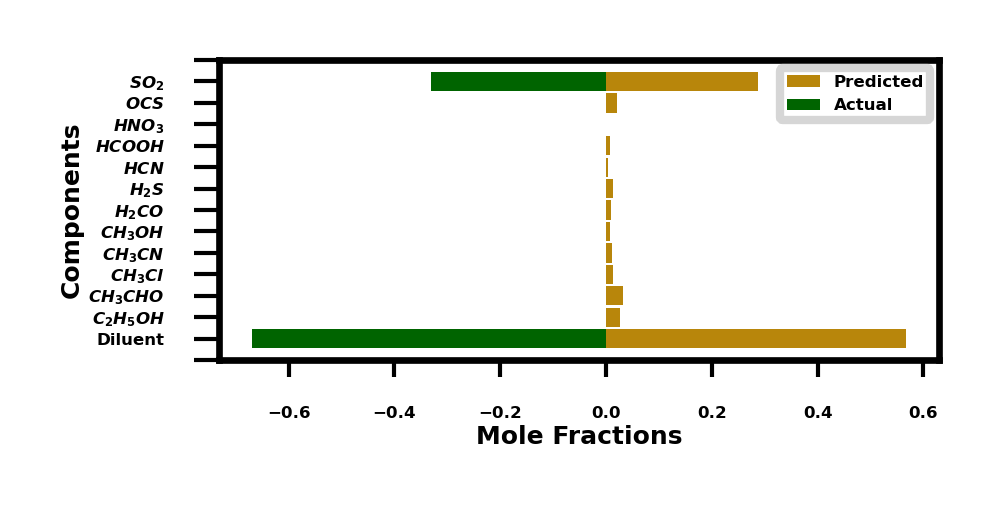

test_mixture2.shape (229, 1)
val_mixture2.shape (229,)
predicted_mixture2_val.shape (229, 1)
     test_mixture2  val_mixture2  predicted_mixture2  predicted_mixture2_val
0         0.000040      0.000337            0.001566                0.001318
1         0.000014      0.000520            0.002105                0.001776
2         0.000049      0.000896            0.000239                0.000209
3         0.000710      0.000735            0.000688                0.000678
4         0.000156     -0.000226            0.000182                0.000180
..             ...           ...                 ...                     ...
224       0.000037      0.000847            0.004024                0.004353
225       0.000104     -0.000733            0.006695                0.006855
226       0.000015      0.001170            0.001301                0.001336
227       0.000051     -0.000140            0.000966                0.000938
228       0.000811      0.001293            0.000944        

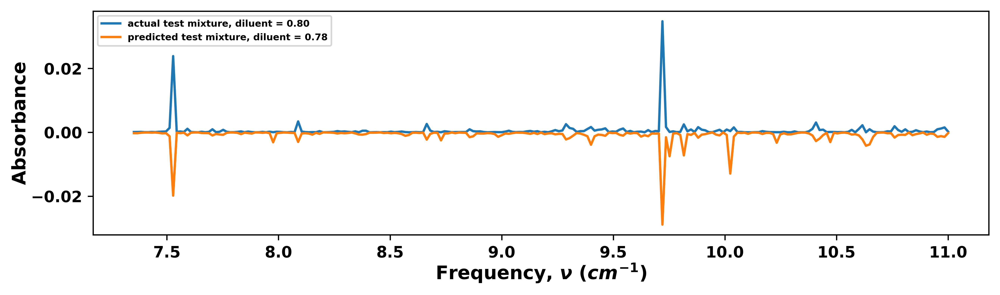

Noise added mixture (validation) concentrations: [0.13 0.   0.   0.   0.   0.07 0.   0.   0.   0.   0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.09484667  0.00170321  0.01121073  0.00061867  0.00010816  0.06043687
   0.01085053 -0.00216804  0.01033102  0.01039931 -0.02483531  0.0127472 ]]
Predicted Noise added mixture (validation) concentrations sum : 0.18624903


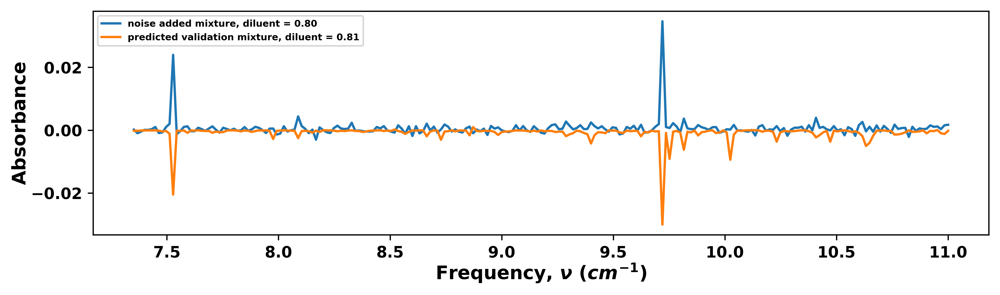

Noise added mixture (validation) concentrations: [0.13 0.   0.   0.   0.   0.07 0.   0.   0.   0.   0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.09484667  0.00170321  0.01121073  0.00061867  0.00010816  0.06043687
   0.01085053 -0.00216804  0.01033102  0.01039931 -0.02483531  0.0127472 ]]
Predicted Noise added mixture (validation) concentrations sum : 0.18624903


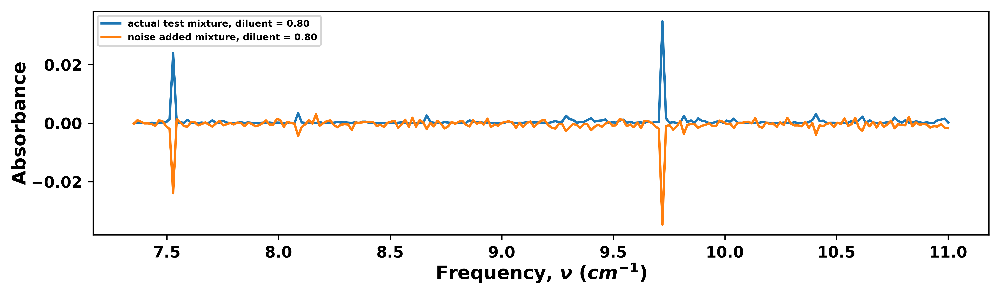

<ipython-input-48-93fef6807b01>:178: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_xticklabels(np.delete(labels,0));


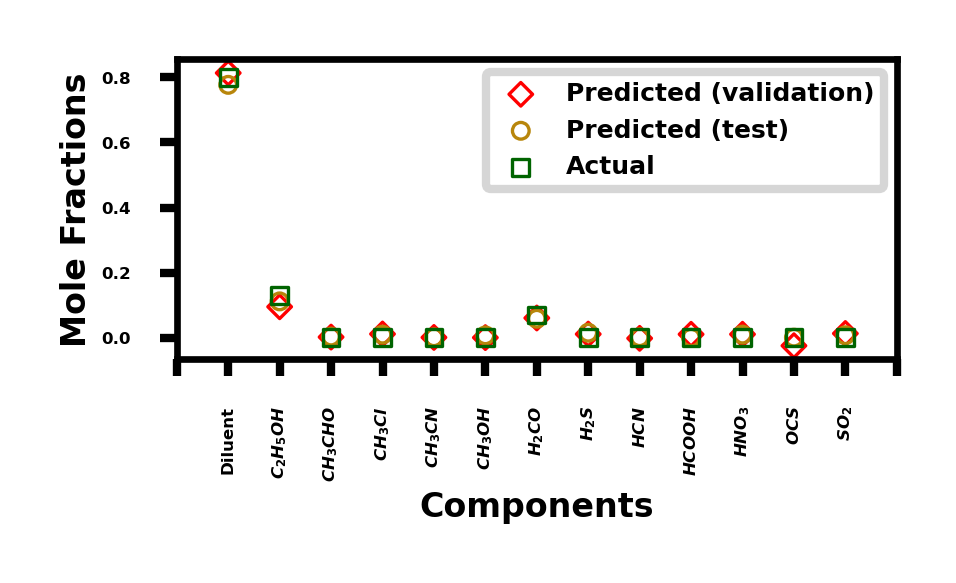

<ipython-input-48-93fef6807b01>:231: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


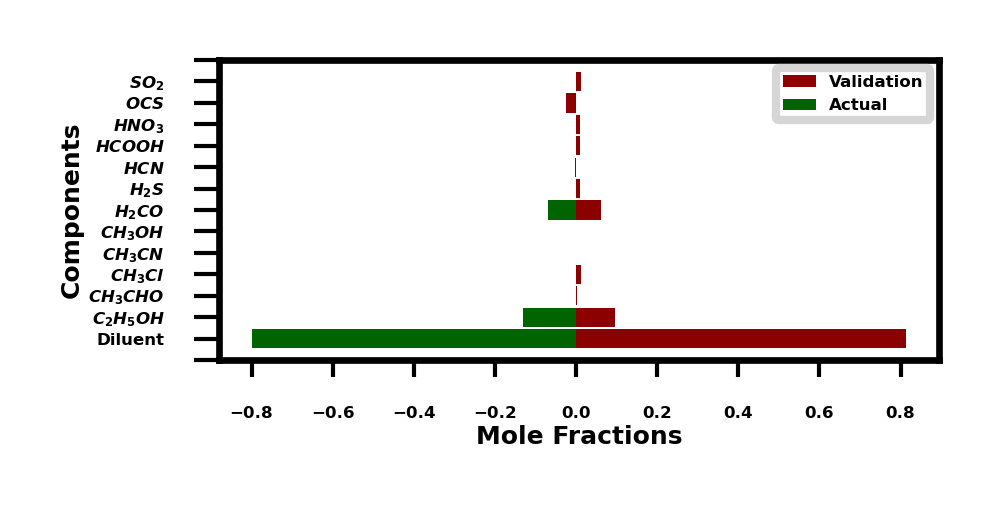

<ipython-input-48-93fef6807b01>:281: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


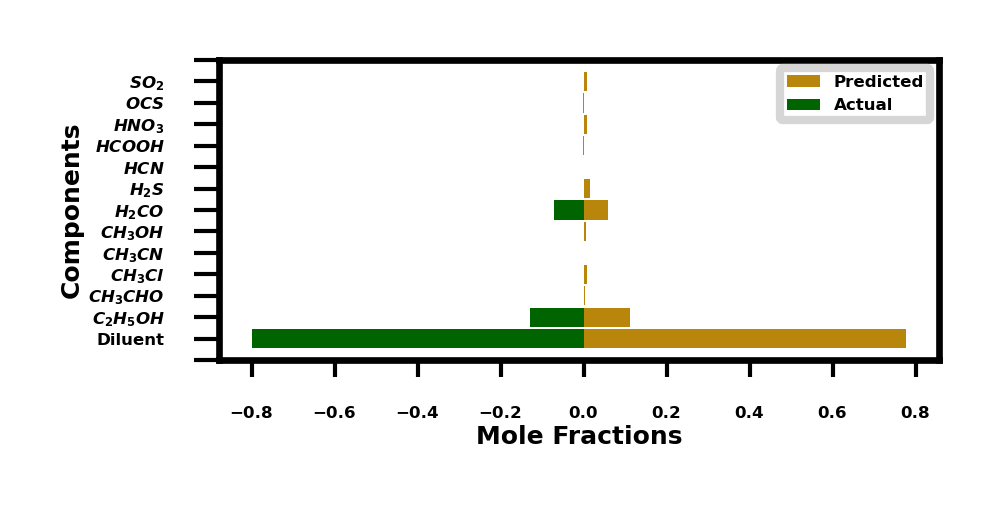

test_mixture2.shape (229, 1)
val_mixture2.shape (229,)
predicted_mixture2_val.shape (229, 1)
     test_mixture2  val_mixture2  predicted_mixture2  predicted_mixture2_val
0         0.000089      0.000199            0.000266                0.000178
1         0.000105     -0.000974            0.000280                0.000188
2         0.000135     -0.000453            0.000141                0.000119
3         0.000049      0.000105            0.000074                0.000078
4         0.000045      0.000097            0.000067                0.000065
..             ...           ...                 ...                     ...
224       0.000088      0.001049            0.000511                0.000305
225       0.000947      0.001184            0.001423               -0.000051
226       0.001181      0.000353            0.001197                0.001003
227       0.001527      0.001568            0.001430                0.001203
228       0.000210      0.001729            0.000241        

<ipython-input-48-93fef6807b01>:40: RuntimeWarning: divide by zero encountered in log10
  x_db = 10 * np.log10(x_watts)


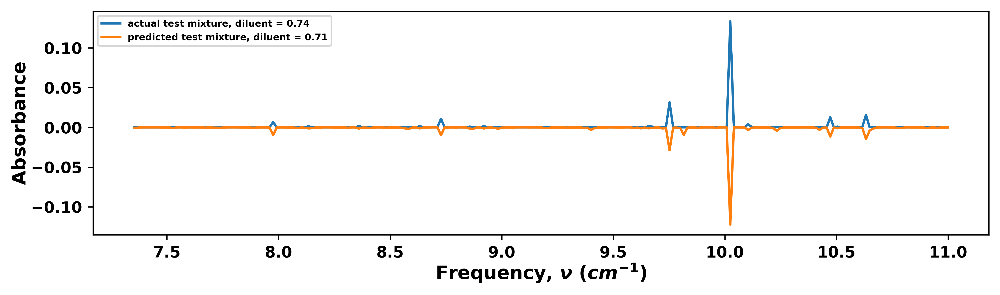

Noise added mixture (validation) concentrations: [0.   0.   0.04 0.   0.06 0.   0.16 0.   0.   0.   0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[-0.11645673  0.01844639  0.04176525  0.0132359   0.05682928  0.01842504
   0.13714904  0.00761031  0.05743364  0.0226981   0.02962375  0.01634564]]
Predicted Noise added mixture (validation) concentrations sum : 0.3031056


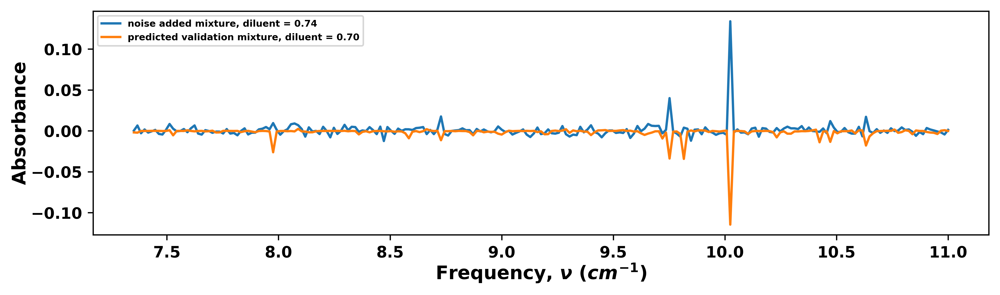

Noise added mixture (validation) concentrations: [0.   0.   0.04 0.   0.06 0.   0.16 0.   0.   0.   0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[-0.11645673  0.01844639  0.04176525  0.0132359   0.05682928  0.01842504
   0.13714904  0.00761031  0.05743364  0.0226981   0.02962375  0.01634564]]
Predicted Noise added mixture (validation) concentrations sum : 0.3031056


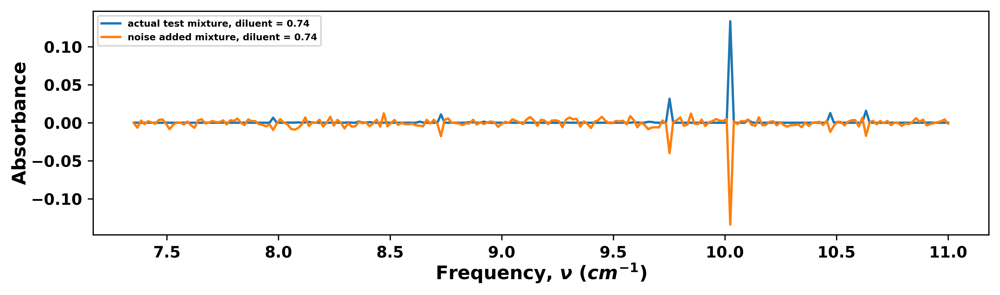

<ipython-input-48-93fef6807b01>:178: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_xticklabels(np.delete(labels,0));


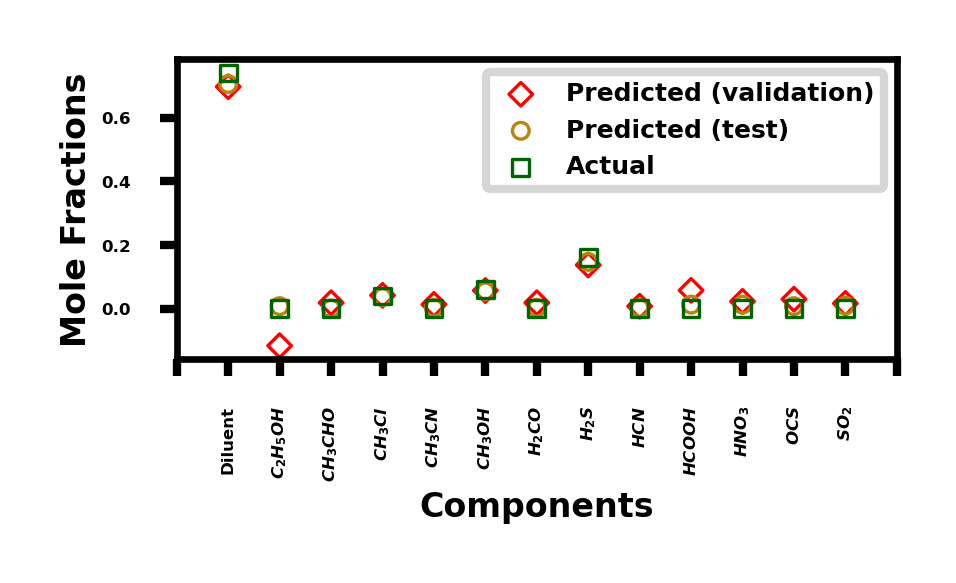

<ipython-input-48-93fef6807b01>:231: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


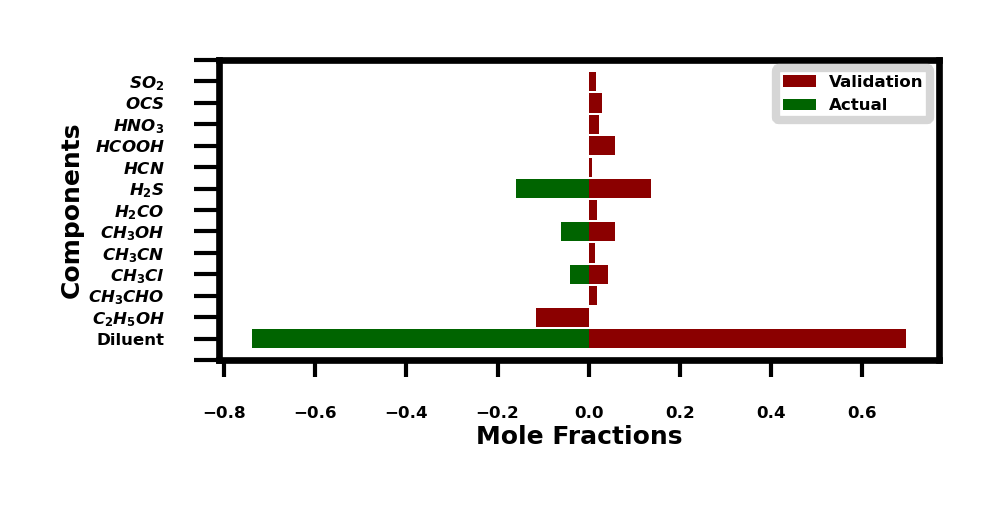

<ipython-input-48-93fef6807b01>:281: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


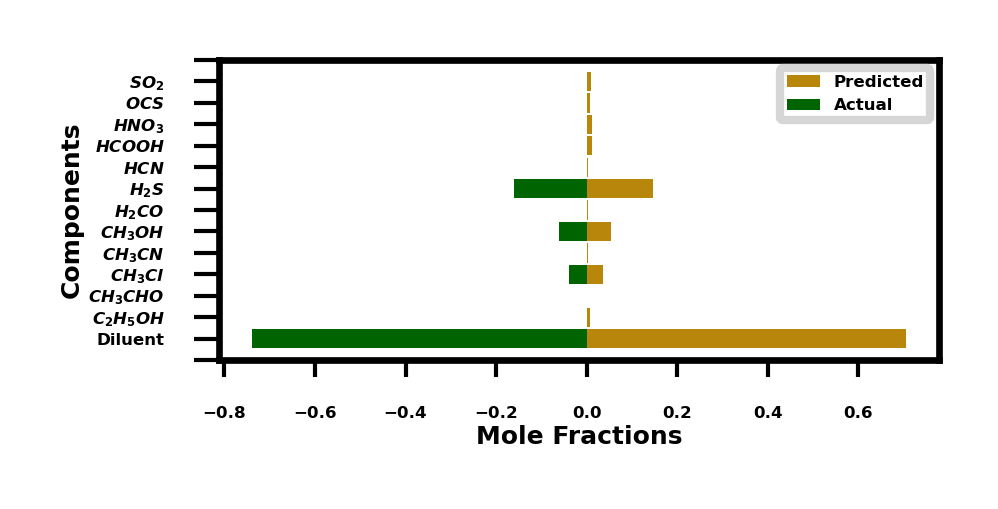

test_mixture2.shape (229, 1)
val_mixture2.shape (229,)
predicted_mixture2_val.shape (229, 1)
     test_mixture2  val_mixture2  predicted_mixture2  predicted_mixture2_val
0     2.257914e-04      0.000345            0.000571                0.001845
1     2.699333e-07      0.006592            0.000447                0.002164
2     4.474851e-11     -0.002876            0.000055                0.000082
3     1.705675e-12      0.001749            0.000048                0.000077
4     6.056577e-07     -0.002051            0.000042                0.000055
..             ...           ...                 ...                     ...
224   6.501267e-06      0.000542            0.000085                0.002307
225   1.006042e-05     -0.000726            0.000524                0.003794
226   1.614175e-06     -0.001863            0.000183               -0.000260
227   7.472900e-05     -0.004344            0.000231               -0.000821
228   1.585226e-05      0.001237            0.000081        

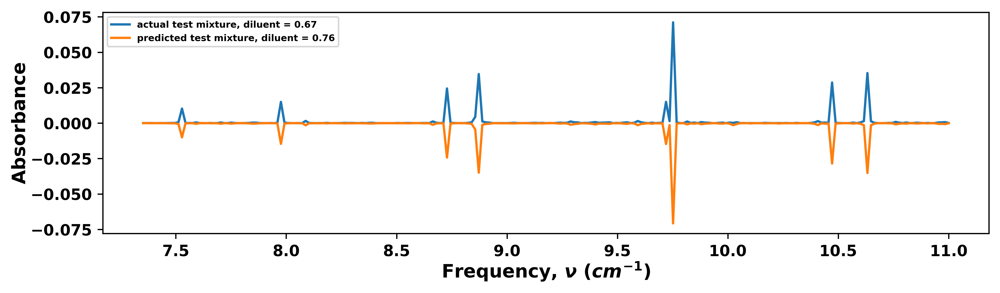

Noise added mixture (validation) concentrations: [0.06 0.   0.09 0.   0.   0.03 0.   0.05 0.   0.   0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.08096325  0.00394337  0.08107772  0.0039685  -0.02776923  0.03430504
   0.0089046   0.05628406  0.01674641 -0.00124672  0.01703482  0.00796785]]
Predicted Noise added mixture (validation) concentrations sum : 0.28217968


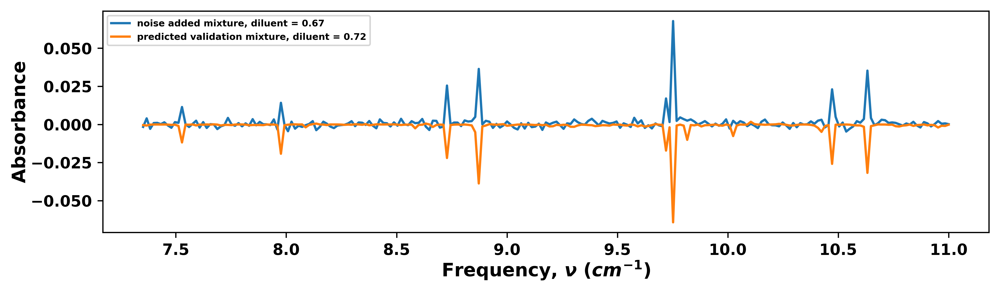

Noise added mixture (validation) concentrations: [0.06 0.   0.09 0.   0.   0.03 0.   0.05 0.   0.   0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.08096325  0.00394337  0.08107772  0.0039685  -0.02776923  0.03430504
   0.0089046   0.05628406  0.01674641 -0.00124672  0.01703482  0.00796785]]
Predicted Noise added mixture (validation) concentrations sum : 0.28217968


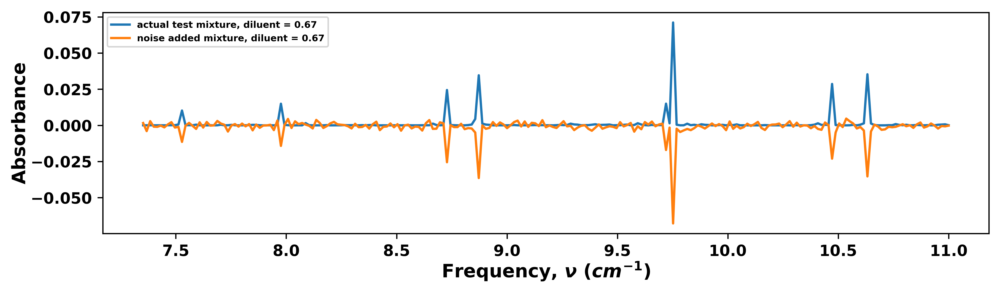

<ipython-input-48-93fef6807b01>:178: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_xticklabels(np.delete(labels,0));


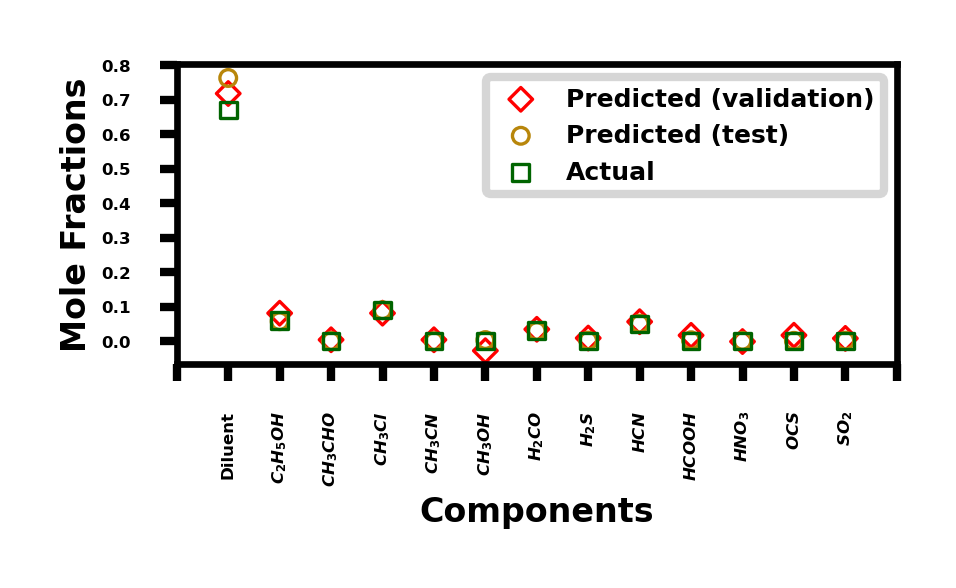

<ipython-input-48-93fef6807b01>:231: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


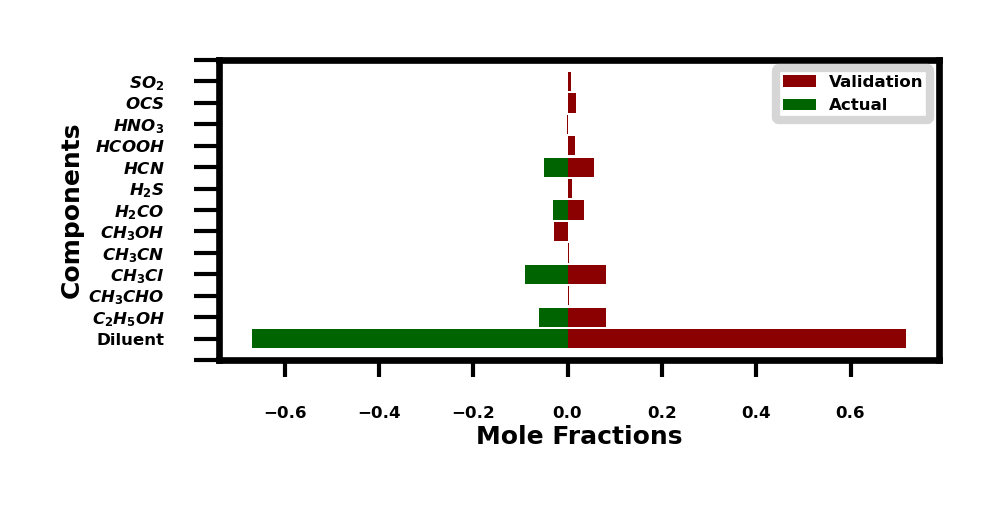

<ipython-input-48-93fef6807b01>:281: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


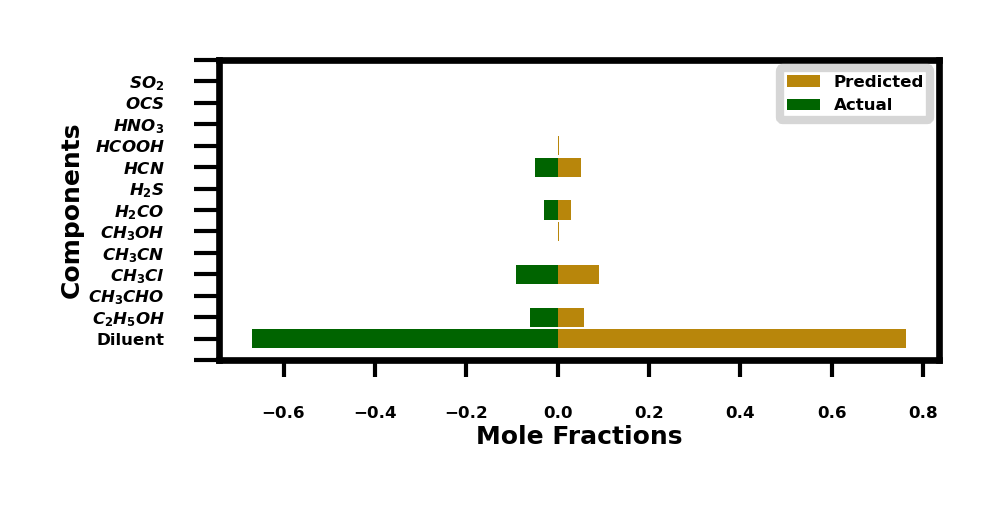

test_mixture2.shape (229, 1)
val_mixture2.shape (229,)
predicted_mixture2_val.shape (229, 1)
     test_mixture2  val_mixture2  predicted_mixture2  predicted_mixture2_val
0         0.000041     -0.001615            0.000032                0.000437
1         0.000049      0.003959            0.000018                0.000735
2         0.000062     -0.002898            0.000059                0.000137
3         0.000023      0.000912            0.000025                0.000065
4         0.000021      0.001027            0.000022                0.000039
..             ...           ...                 ...                     ...
224       0.000040      0.000158            0.000072                0.000546
225       0.000437      0.002198            0.000505                0.002021
226       0.000545      0.000456            0.000539                0.000857
227       0.000705      0.000685            0.000691                0.000987
228       0.000097      0.000172            0.000100        

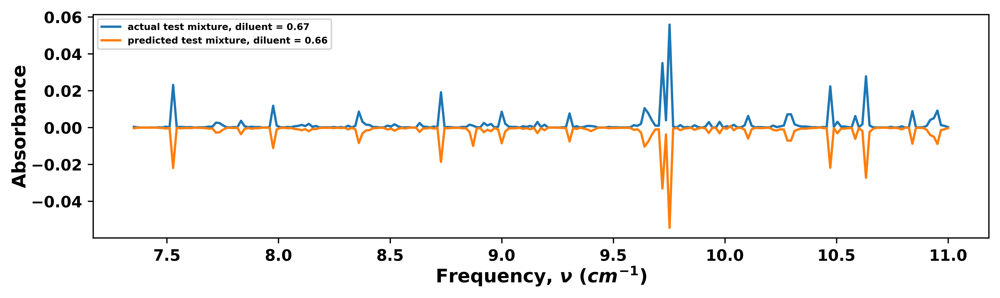

Noise added mixture (validation) concentrations: [0.   0.04 0.07 0.   0.1  0.07 0.   0.   0.   0.   0.05 0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.04117402  0.04141076  0.06933751  0.00065963  0.07949495  0.06559972
   0.00148781  0.01223878 -0.00931869  0.00023744  0.01312349  0.00262737]]
Predicted Noise added mixture (validation) concentrations sum : 0.31807277


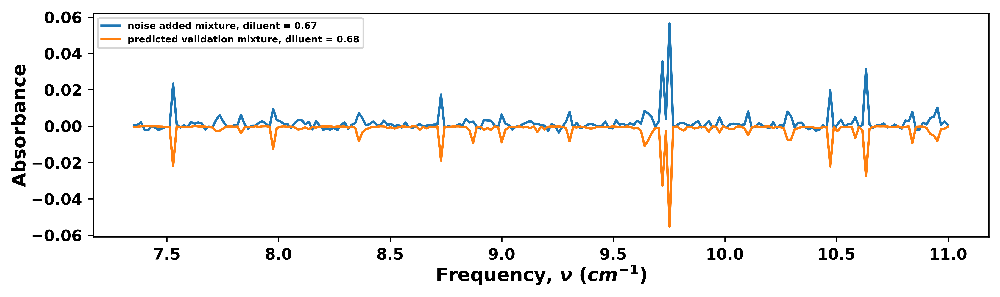

Noise added mixture (validation) concentrations: [0.   0.04 0.07 0.   0.1  0.07 0.   0.   0.   0.   0.05 0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.04117402  0.04141076  0.06933751  0.00065963  0.07949495  0.06559972
   0.00148781  0.01223878 -0.00931869  0.00023744  0.01312349  0.00262737]]
Predicted Noise added mixture (validation) concentrations sum : 0.31807277


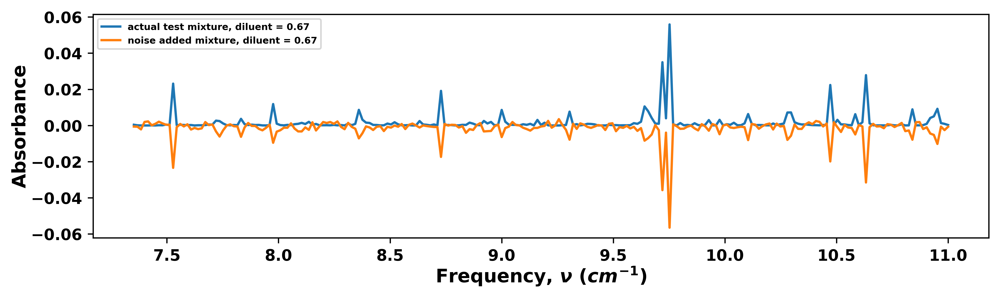

<ipython-input-48-93fef6807b01>:178: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_xticklabels(np.delete(labels,0));


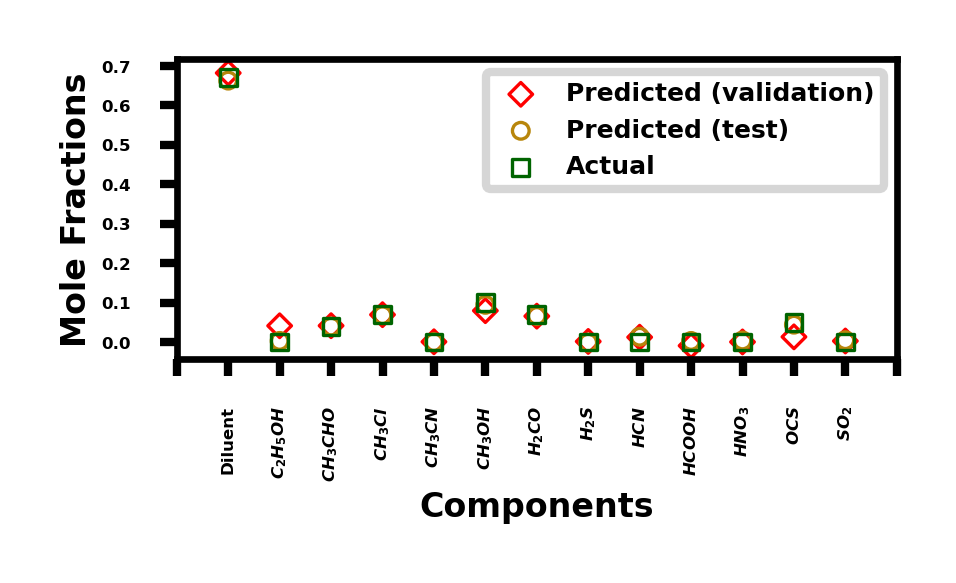

<ipython-input-48-93fef6807b01>:231: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


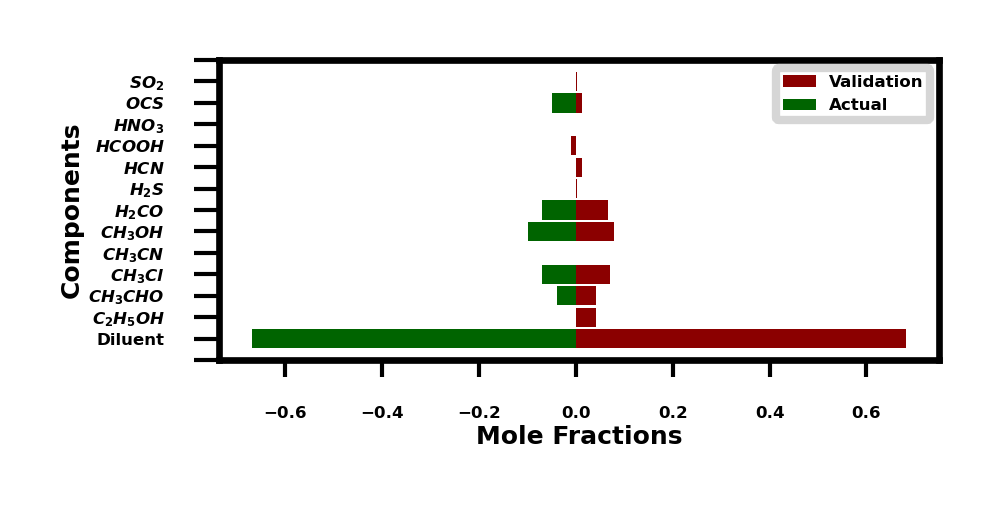

<ipython-input-48-93fef6807b01>:281: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


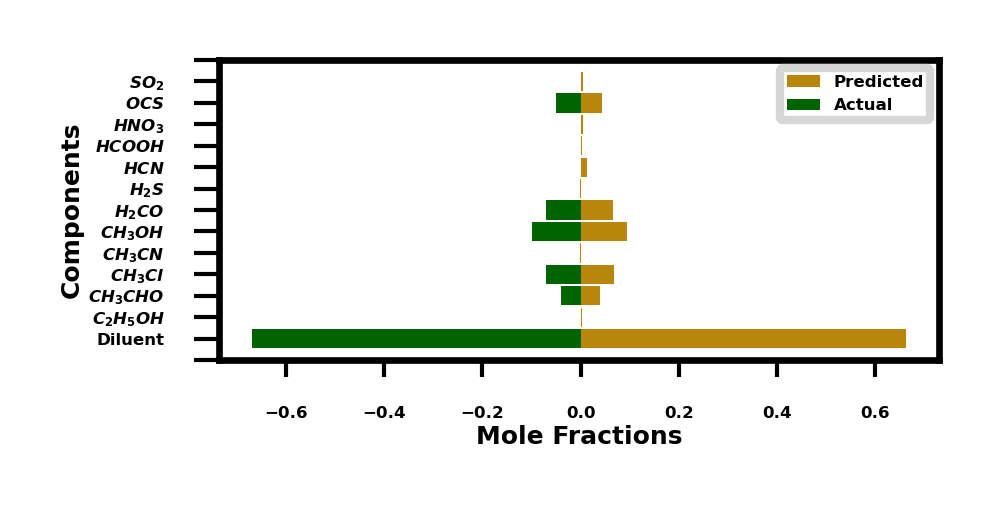

test_mixture2.shape (229, 1)
val_mixture2.shape (229,)
predicted_mixture2_val.shape (229, 1)
     test_mixture2  val_mixture2  predicted_mixture2  predicted_mixture2_val
0         0.000410      0.000591            0.000367                0.000443
1         0.000118      0.000666            0.000070                0.000265
2         0.000020      0.002157            0.000023                0.000073
3         0.000009     -0.001970            0.000023                0.000034
4         0.000015     -0.002254            0.000026                0.000033
..             ...           ...                 ...                     ...
224       0.005051      0.005205            0.004958                0.005255
225       0.009219      0.010187            0.008852                0.008148
226       0.001334      0.000649            0.001363                0.001757
227       0.000891      0.002552            0.000921                0.001377
228       0.000263      0.000685            0.000281        

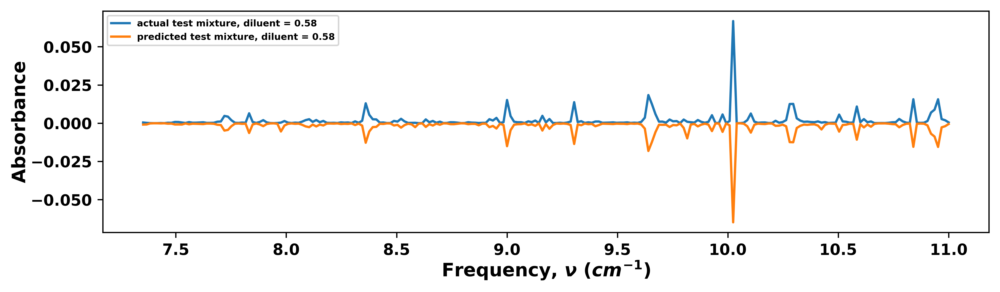

Noise added mixture (validation) concentrations: [0.04 0.07 0.   0.   0.1  0.   0.08 0.   0.06 0.   0.07 0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.04020921  0.07632409 -0.00097206  0.0034099   0.09701479  0.00103826
   0.07389903  0.00897341  0.01616959 -0.00884707  0.08549067 -0.00517736]]
Predicted Noise added mixture (validation) concentrations sum : 0.38753244


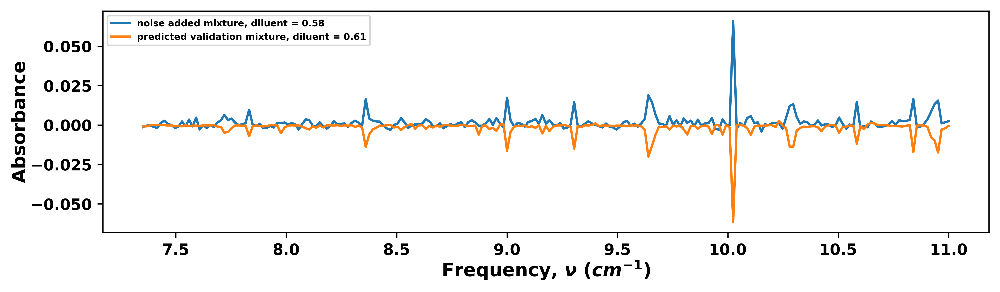

Noise added mixture (validation) concentrations: [0.04 0.07 0.   0.   0.1  0.   0.08 0.   0.06 0.   0.07 0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.04020921  0.07632409 -0.00097206  0.0034099   0.09701479  0.00103826
   0.07389903  0.00897341  0.01616959 -0.00884707  0.08549067 -0.00517736]]
Predicted Noise added mixture (validation) concentrations sum : 0.38753244


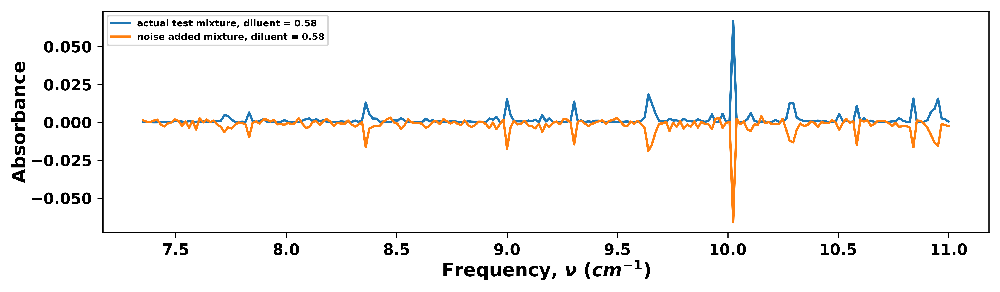

<ipython-input-48-93fef6807b01>:178: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_xticklabels(np.delete(labels,0));


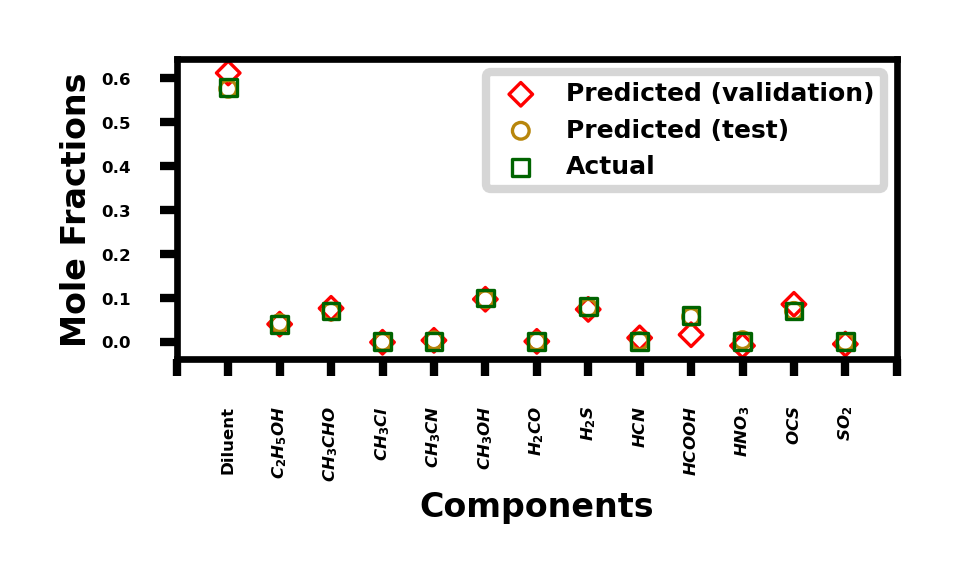

<ipython-input-48-93fef6807b01>:231: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


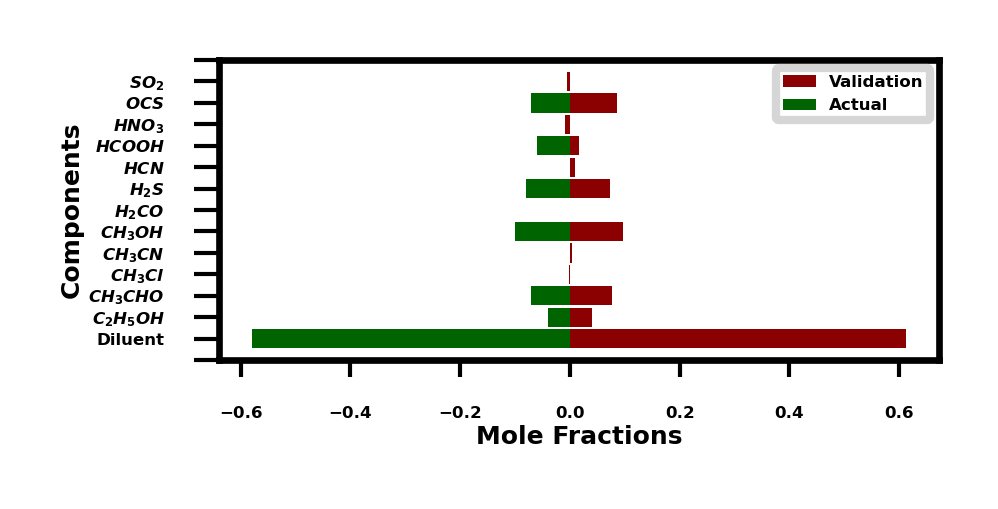

<ipython-input-48-93fef6807b01>:281: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


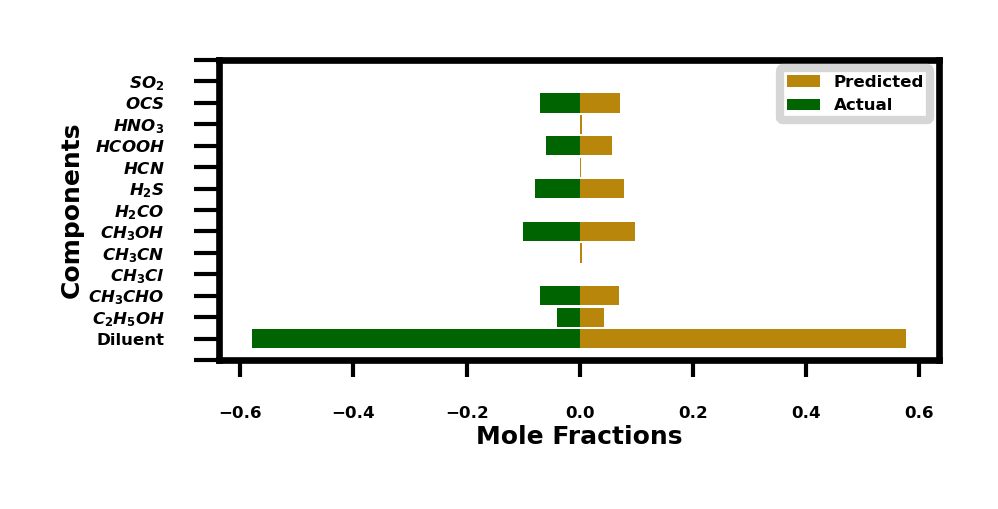

test_mixture2.shape (229, 1)
val_mixture2.shape (229,)
predicted_mixture2_val.shape (229, 1)
     test_mixture2  val_mixture2  predicted_mixture2  predicted_mixture2_val
0         0.000464     -0.001306            0.000891                0.000844
1         0.000238     -0.000368            0.000817                0.000820
2         0.000077     -0.000113            0.000128                0.000115
3         0.000031     -0.001185            0.000051                0.000027
4         0.000039     -0.001792            0.000056                0.000026
..             ...           ...                 ...                     ...
224       0.008858      0.013310            0.008734                0.009633
225       0.015645      0.015549            0.015513                0.017395
226       0.002696      0.001111            0.002716                0.002837
227       0.001935      0.001774            0.001964                0.002009
228       0.000505      0.002448            0.000512        

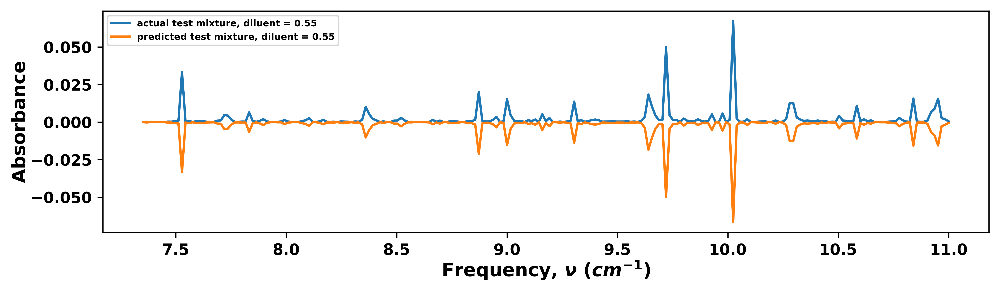

Noise added mixture (validation) concentrations: [0.04 0.07 0.   0.   0.   0.1  0.08 0.03 0.06 0.   0.07 0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.03018858  0.07587065  0.00103243 -0.00081709 -0.00187265  0.09890813
   0.0841389   0.03065652  0.06666753 -0.00113065  0.01445431 -0.0016295 ]]
Predicted Noise added mixture (validation) concentrations sum : 0.39646715


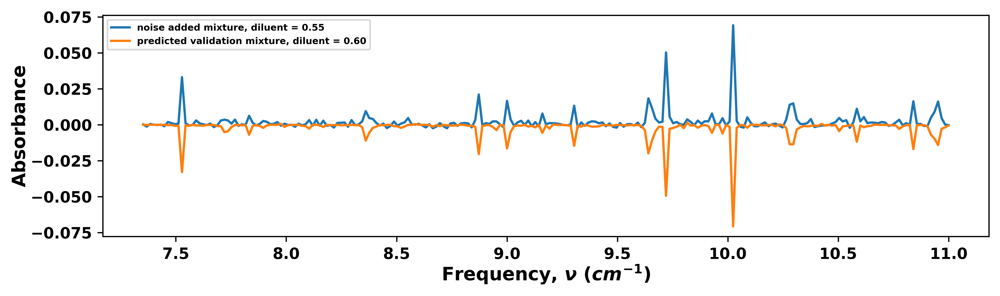

Noise added mixture (validation) concentrations: [0.04 0.07 0.   0.   0.   0.1  0.08 0.03 0.06 0.   0.07 0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.03018858  0.07587065  0.00103243 -0.00081709 -0.00187265  0.09890813
   0.0841389   0.03065652  0.06666753 -0.00113065  0.01445431 -0.0016295 ]]
Predicted Noise added mixture (validation) concentrations sum : 0.39646715


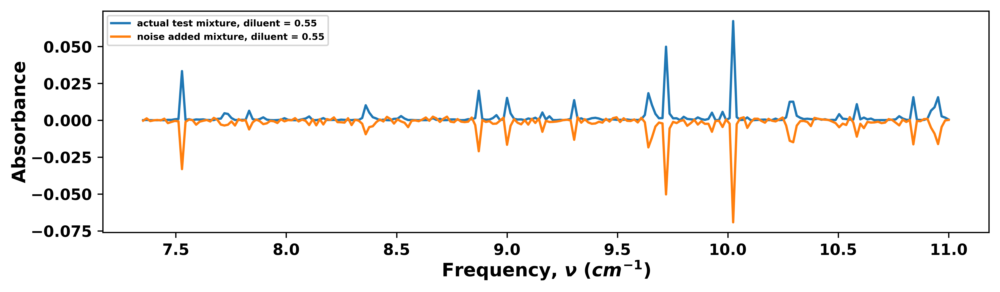

<ipython-input-48-93fef6807b01>:178: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_xticklabels(np.delete(labels,0));


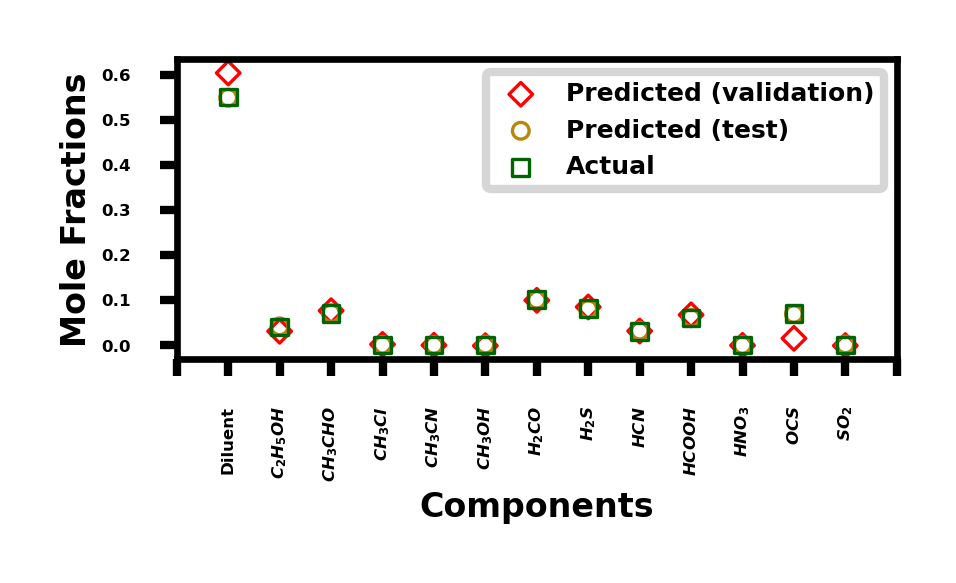

<ipython-input-48-93fef6807b01>:231: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


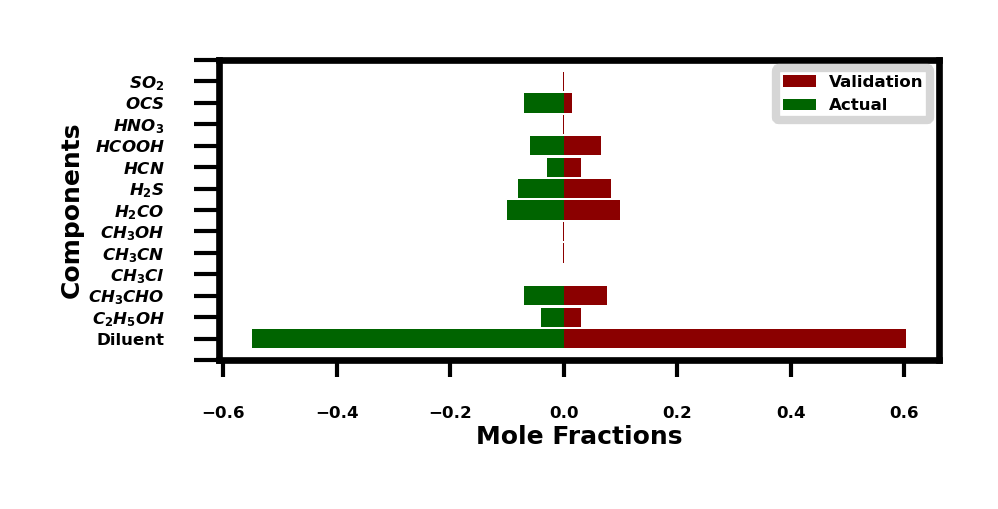

<ipython-input-48-93fef6807b01>:281: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


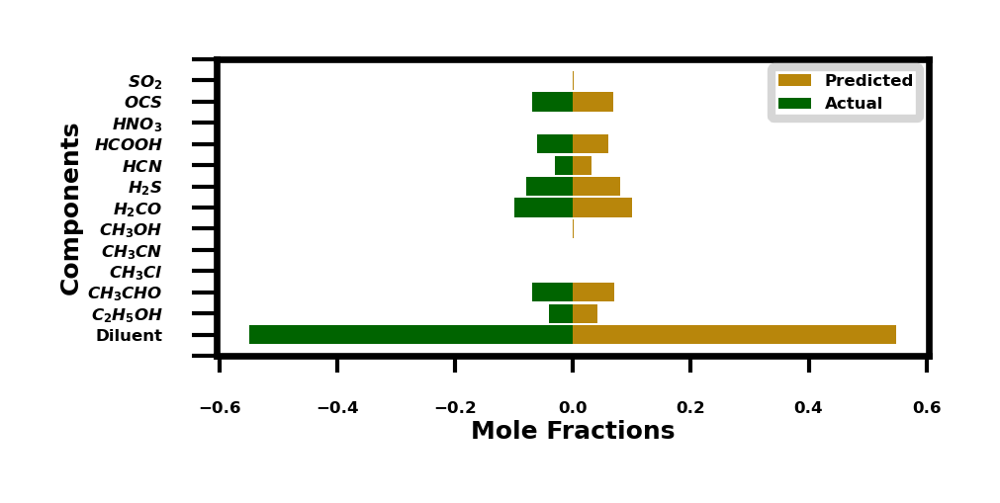

test_mixture2.shape (229, 1)
val_mixture2.shape (229,)
predicted_mixture2_val.shape (229, 1)
     test_mixture2  val_mixture2  predicted_mixture2  predicted_mixture2_val
0         0.000088      0.000258            0.000070               -0.000024
1         0.000238     -0.001297            0.000212                0.000112
2         0.000077      0.000536            0.000076                0.000058
3         0.000031      0.000033            0.000033                0.000021
4         0.000038     -0.000205            0.000038                0.000032
..             ...           ...                 ...                     ...
224       0.008847      0.009019            0.008863                0.009577
225       0.015629      0.016128            0.015588                0.014145
226       0.002694      0.004559            0.002704                0.002791
227       0.001811      0.000094            0.001824                0.001800
228       0.000479     -0.000256            0.000483        

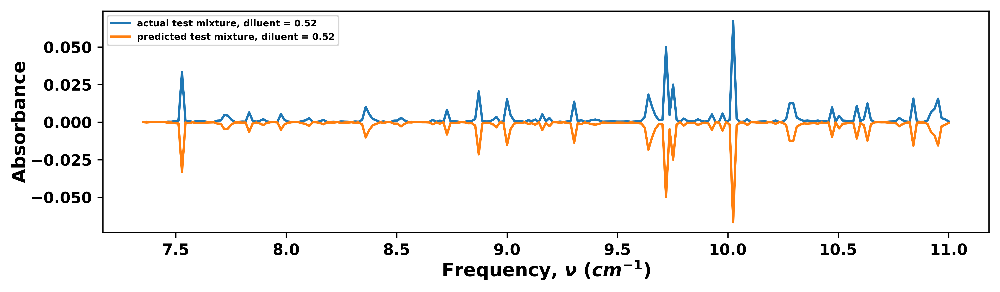

Noise added mixture (validation) concentrations: [0.04 0.07 0.03 0.   0.   0.1  0.08 0.03 0.06 0.   0.07 0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.06530093  0.07114566  0.02692585 -0.00163866  0.0113691   0.09534031
   0.0800499   0.03279111  0.05283497  0.00357584  0.13073495 -0.00223966]]
Predicted Noise added mixture (validation) concentrations sum : 0.5661903


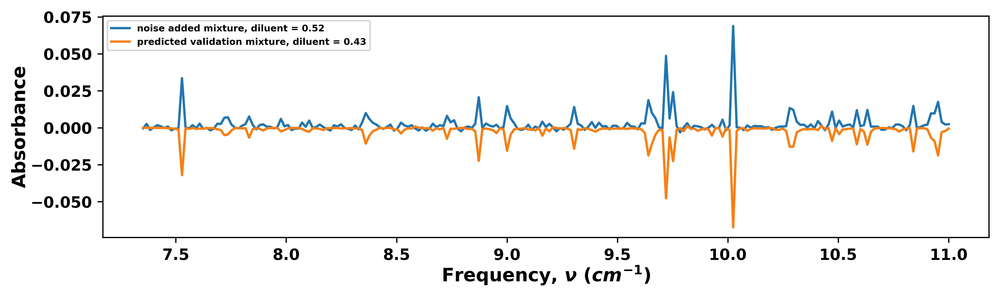

Noise added mixture (validation) concentrations: [0.04 0.07 0.03 0.   0.   0.1  0.08 0.03 0.06 0.   0.07 0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.06530093  0.07114566  0.02692585 -0.00163866  0.0113691   0.09534031
   0.0800499   0.03279111  0.05283497  0.00357584  0.13073495 -0.00223966]]
Predicted Noise added mixture (validation) concentrations sum : 0.5661903


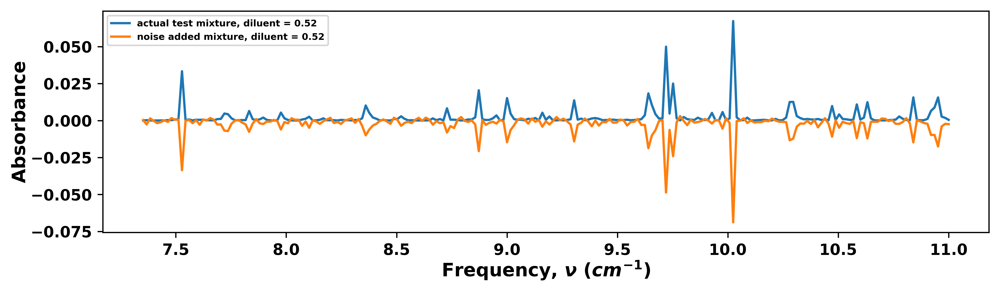

<ipython-input-48-93fef6807b01>:178: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_xticklabels(np.delete(labels,0));


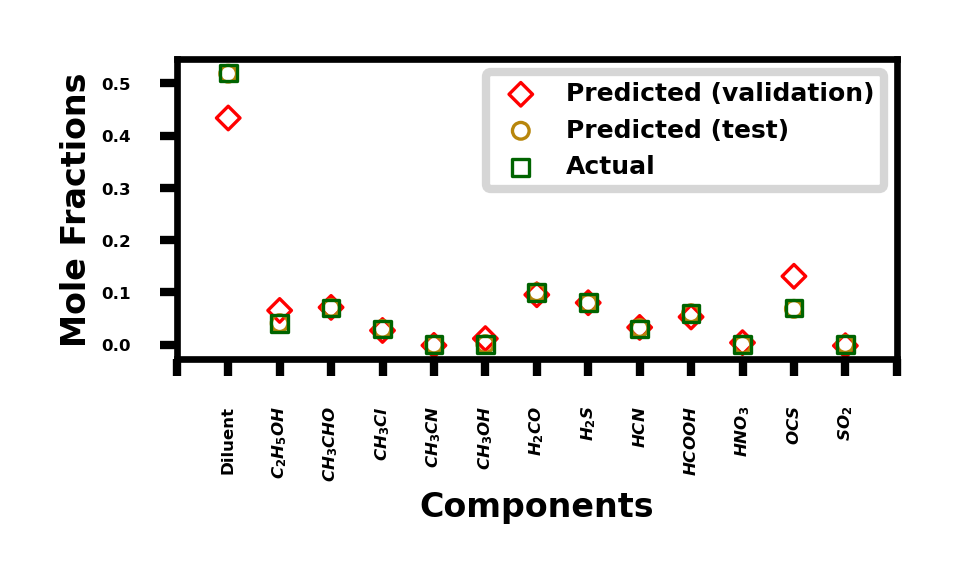

<ipython-input-48-93fef6807b01>:231: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


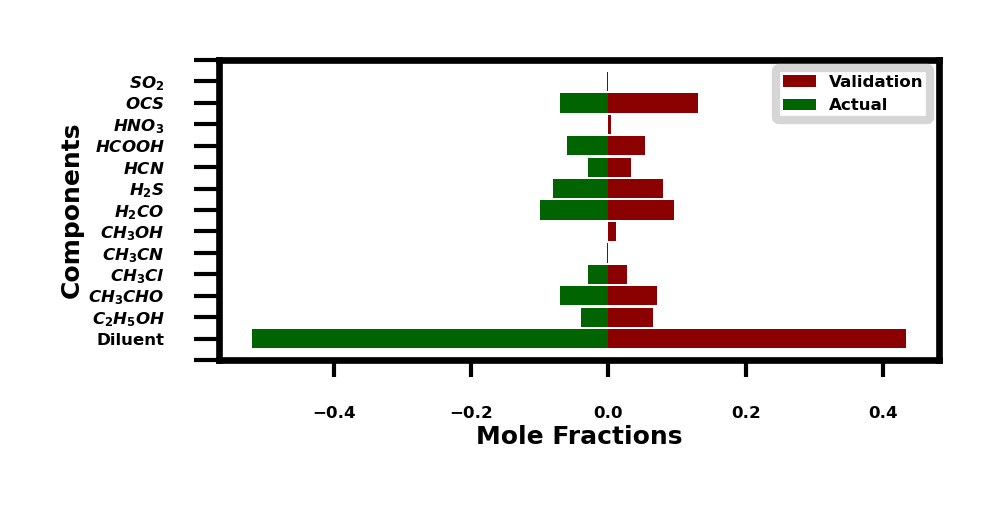

<ipython-input-48-93fef6807b01>:281: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


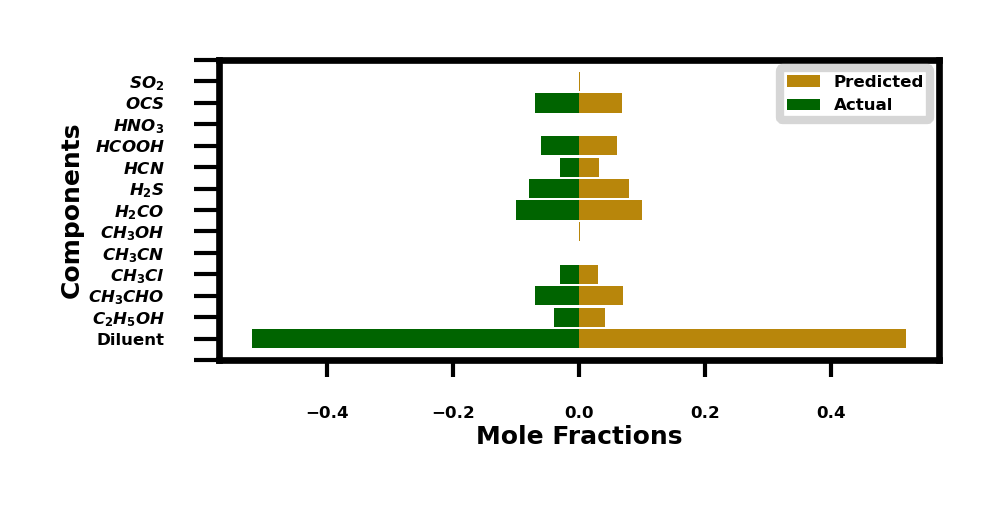

test_mixture2.shape (229, 1)
val_mixture2.shape (229,)
predicted_mixture2_val.shape (229, 1)
     test_mixture2  val_mixture2  predicted_mixture2  predicted_mixture2_val
0         0.000088     -0.000353            0.000066               -0.000040
1         0.000238      0.002641            0.000205               -0.000009
2         0.000077     -0.001468            0.000075                0.000086
3         0.000031      0.000245            0.000032                0.000033
4         0.000038      0.001769            0.000038                0.000051
..             ...           ...                 ...                     ...
224       0.008847      0.009747            0.008864                0.009018
225       0.015629      0.017514            0.015586                0.018693
226       0.002694      0.003991            0.002703                0.002990
227       0.001811      0.002245            0.001823                0.002162
228       0.000479      0.002422            0.000483        

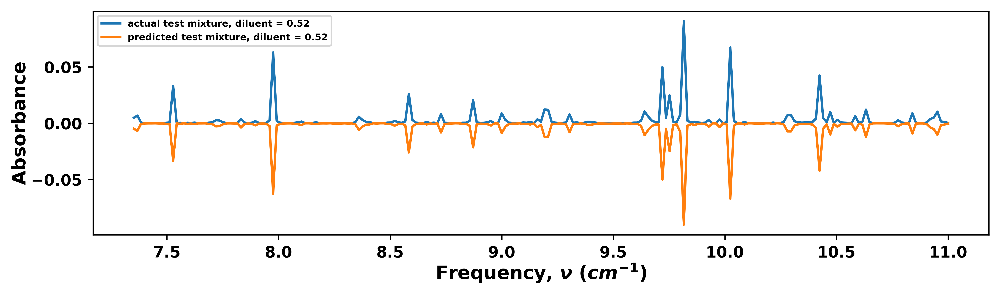

Noise added mixture (validation) concentrations: [0.03 0.04 0.03 0.04 0.   0.1  0.08 0.03 0.06 0.   0.07 0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.02161135  0.04593788  0.03289883  0.03859119 -0.04526244  0.09874767
   0.08653329  0.03505903  0.10421969  0.00590338  0.08561593  0.00903987]]
Predicted Noise added mixture (validation) concentrations sum : 0.5188956


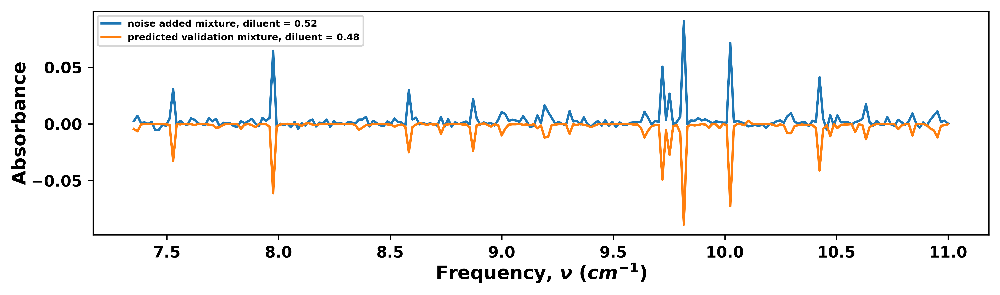

Noise added mixture (validation) concentrations: [0.03 0.04 0.03 0.04 0.   0.1  0.08 0.03 0.06 0.   0.07 0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 0.02161135  0.04593788  0.03289883  0.03859119 -0.04526244  0.09874767
   0.08653329  0.03505903  0.10421969  0.00590338  0.08561593  0.00903987]]
Predicted Noise added mixture (validation) concentrations sum : 0.5188956


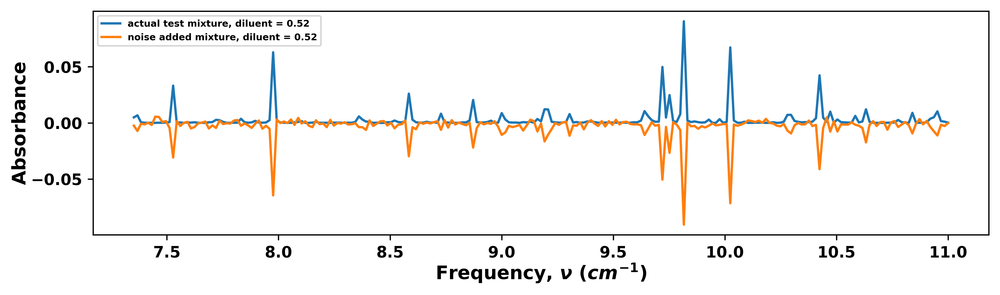

<ipython-input-48-93fef6807b01>:178: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_xticklabels(np.delete(labels,0));


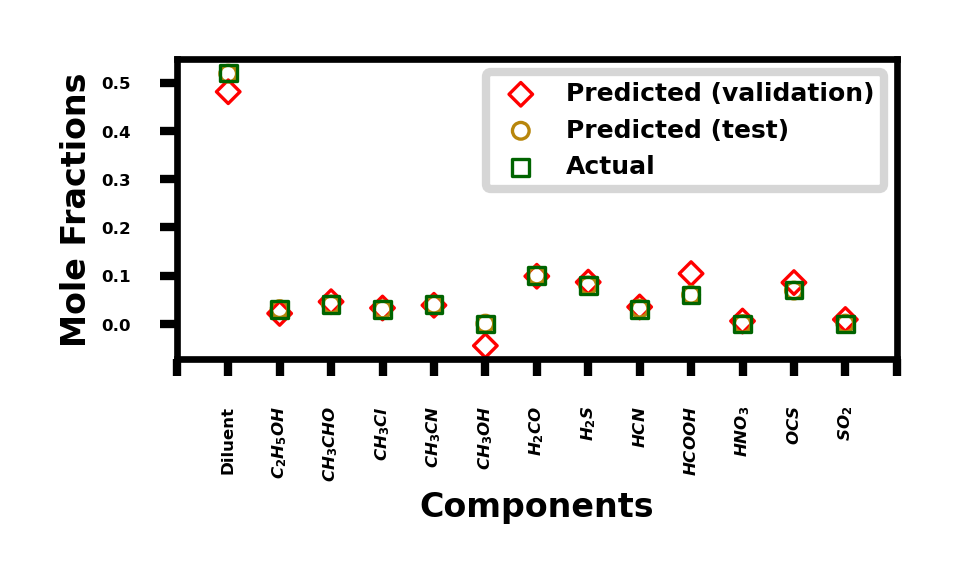

<ipython-input-48-93fef6807b01>:231: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


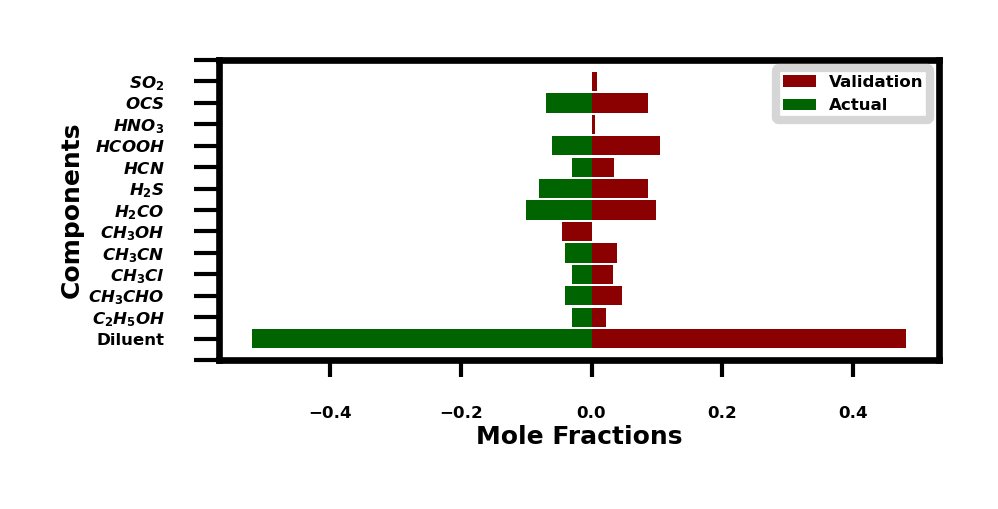

<ipython-input-48-93fef6807b01>:281: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


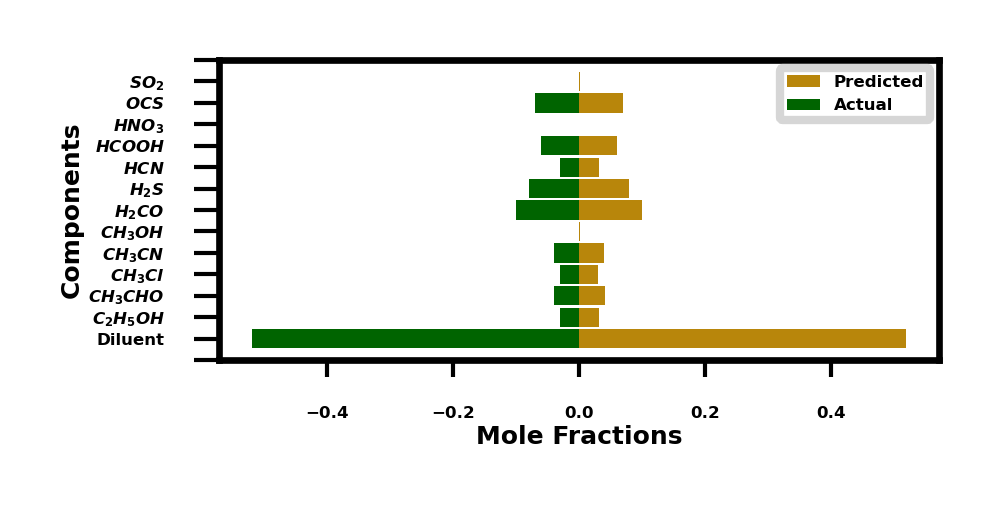

test_mixture2.shape (229, 1)
val_mixture2.shape (229,)
predicted_mixture2_val.shape (229, 1)
     test_mixture2  val_mixture2  predicted_mixture2  predicted_mixture2_val
0         0.004949      0.002440            0.004922                0.004627
1         0.006778      0.007114            0.006741                0.006557
2         0.000564      0.000740            0.000561                0.000547
3         0.000194      0.001291            0.000194                0.000212
4         0.000111     -0.000164            0.000110                0.000125
..             ...           ...                 ...                     ...
224       0.005060      0.007414            0.005083                0.005813
225       0.010298      0.011136            0.010290                0.011983
226       0.001605      0.001654            0.001614                0.001773
227       0.001125      0.002785            0.001134                0.001116
228       0.000302      0.000153            0.000304        

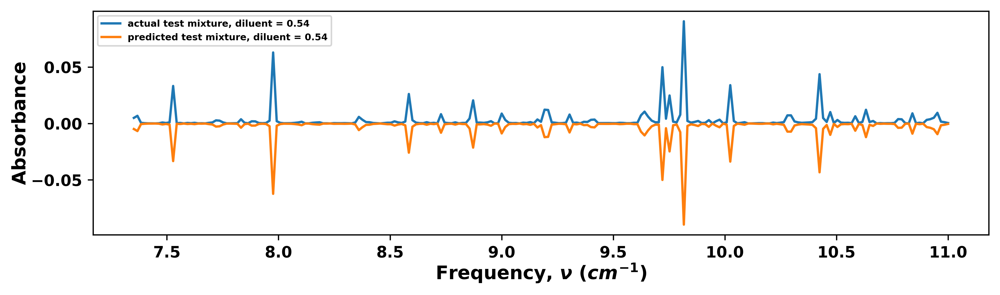

Noise added mixture (validation) concentrations: [0.03 0.04 0.03 0.04 0.   0.1  0.04 0.03 0.06 0.   0.05 0.04]
Predicted Noise added mixture (validation) concentrations: [[ 0.02890216  0.03798831  0.02780117  0.03916465  0.02355759  0.09940884
   0.04361213  0.02682406  0.04789541  0.00344057 -0.00380626  0.04716424]]
Predicted Noise added mixture (validation) concentrations sum : 0.42195284


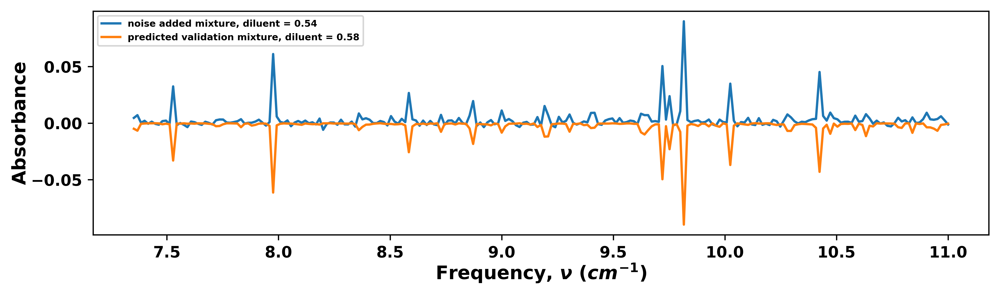

Noise added mixture (validation) concentrations: [0.03 0.04 0.03 0.04 0.   0.1  0.04 0.03 0.06 0.   0.05 0.04]
Predicted Noise added mixture (validation) concentrations: [[ 0.02890216  0.03798831  0.02780117  0.03916465  0.02355759  0.09940884
   0.04361213  0.02682406  0.04789541  0.00344057 -0.00380626  0.04716424]]
Predicted Noise added mixture (validation) concentrations sum : 0.42195284


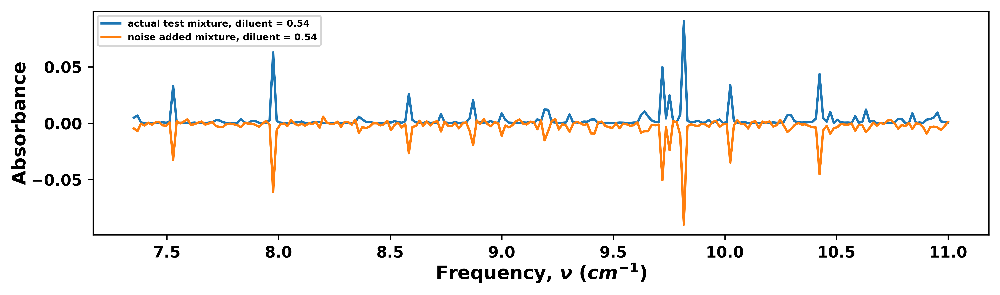

<ipython-input-48-93fef6807b01>:178: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_xticklabels(np.delete(labels,0));


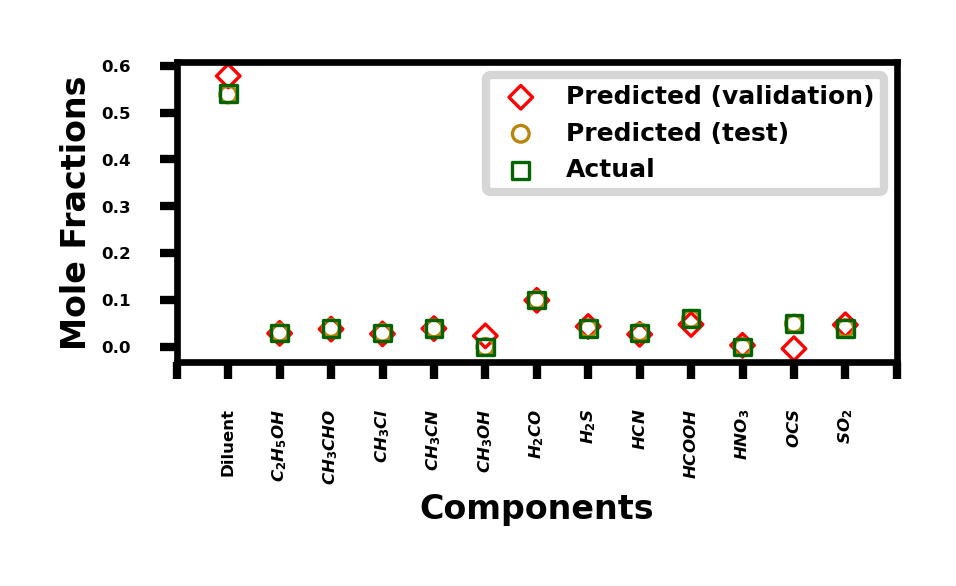

<ipython-input-48-93fef6807b01>:231: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


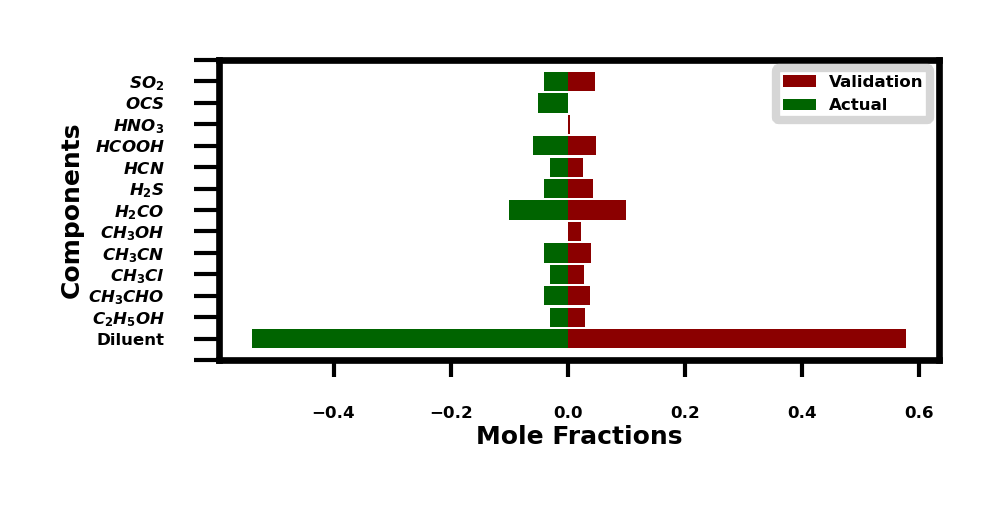

<ipython-input-48-93fef6807b01>:281: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


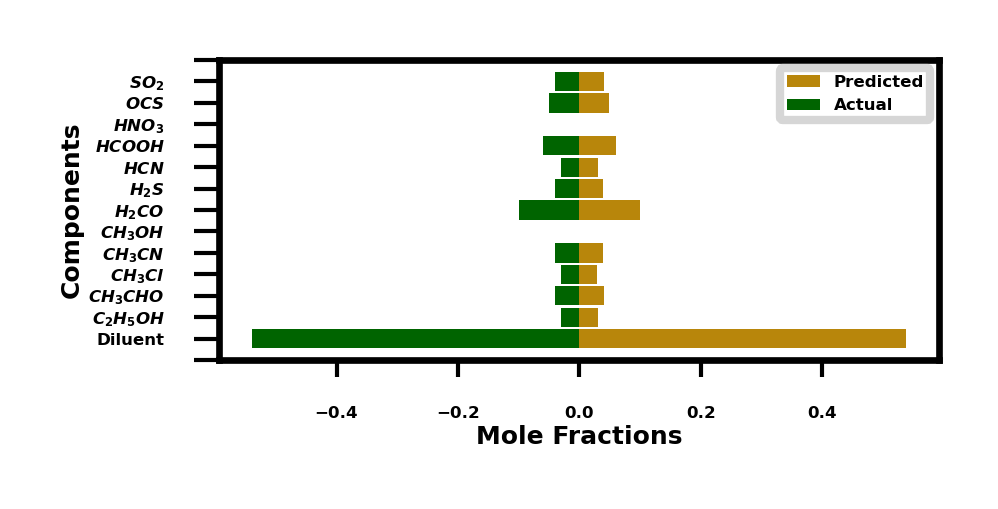

test_mixture2.shape (229, 1)
val_mixture2.shape (229,)
predicted_mixture2_val.shape (229, 1)
     test_mixture2  val_mixture2  predicted_mixture2  predicted_mixture2_val
0         0.004954      0.004648            0.004906                0.004949
1         0.006780      0.007070            0.006717                0.006636
2         0.000570      0.000325            0.000565                0.000561
3         0.000280      0.002108            0.000279                0.000295
4         0.000130     -0.000536            0.000129                0.000139
..             ...           ...                 ...                     ...
224       0.005065      0.002994            0.005100                0.004822
225       0.009434      0.003667            0.009468                0.006735
226       0.001607      0.006072            0.001618                0.001558
227       0.001131      0.002566            0.001140                0.001128
228       0.000400     -0.001203            0.000402        

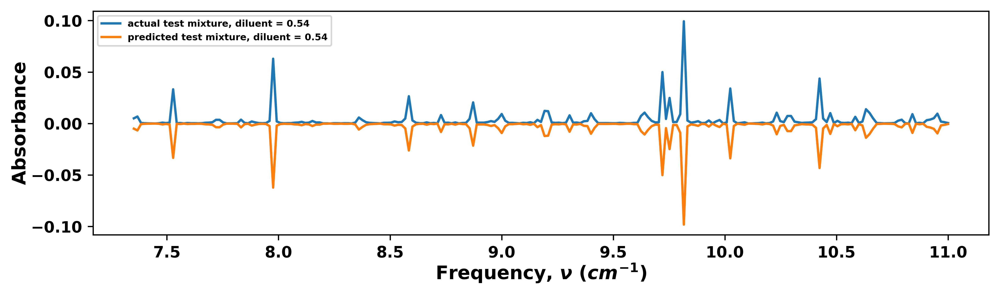

Noise added mixture (validation) concentrations: [0.03 0.04 0.03 0.04 0.   0.1  0.04 0.03 0.03 0.03 0.05 0.04]
Predicted Noise added mixture (validation) concentrations: [[ 0.0259881   0.041227    0.03210303  0.04232594 -0.02122432  0.09927939
   0.03819852  0.03444988  0.08232838  0.02165133  0.02071887  0.06178718]]
Predicted Noise added mixture (validation) concentrations sum : 0.47883332


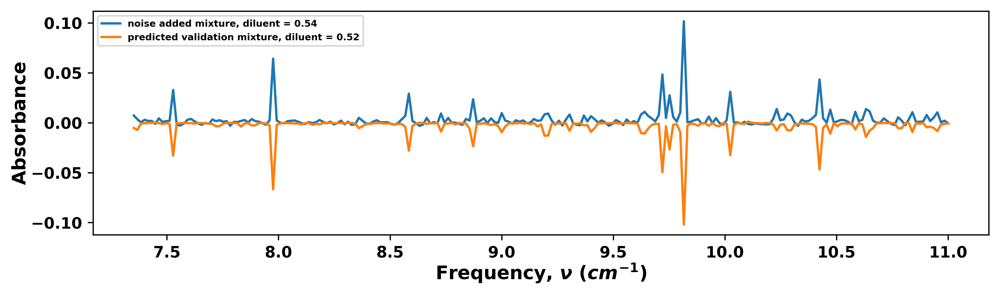

Noise added mixture (validation) concentrations: [0.03 0.04 0.03 0.04 0.   0.1  0.04 0.03 0.03 0.03 0.05 0.04]
Predicted Noise added mixture (validation) concentrations: [[ 0.0259881   0.041227    0.03210303  0.04232594 -0.02122432  0.09927939
   0.03819852  0.03444988  0.08232838  0.02165133  0.02071887  0.06178718]]
Predicted Noise added mixture (validation) concentrations sum : 0.47883332


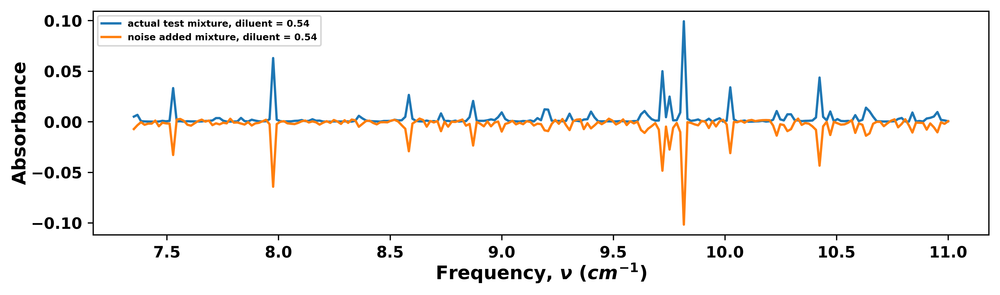

<ipython-input-48-93fef6807b01>:178: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_xticklabels(np.delete(labels,0));


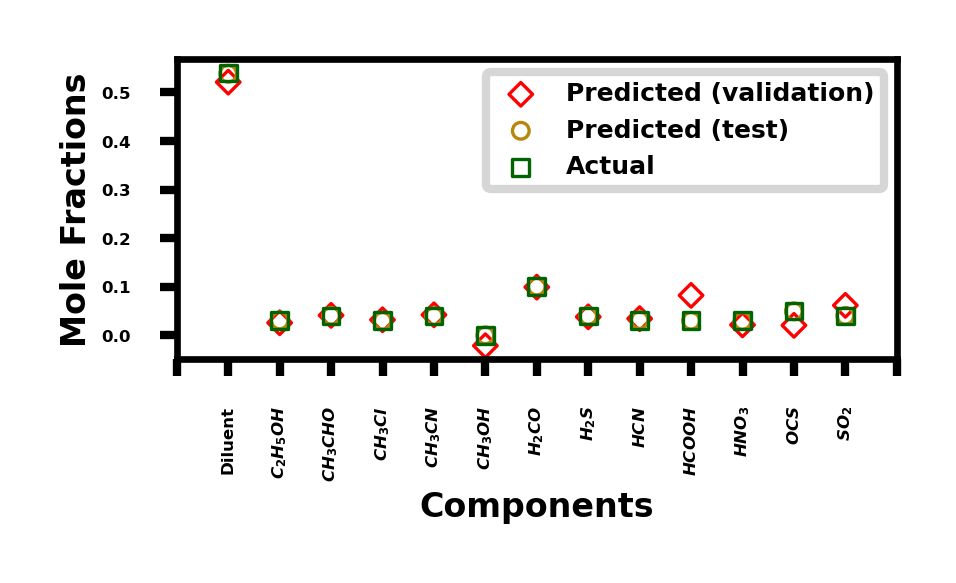

<ipython-input-48-93fef6807b01>:231: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


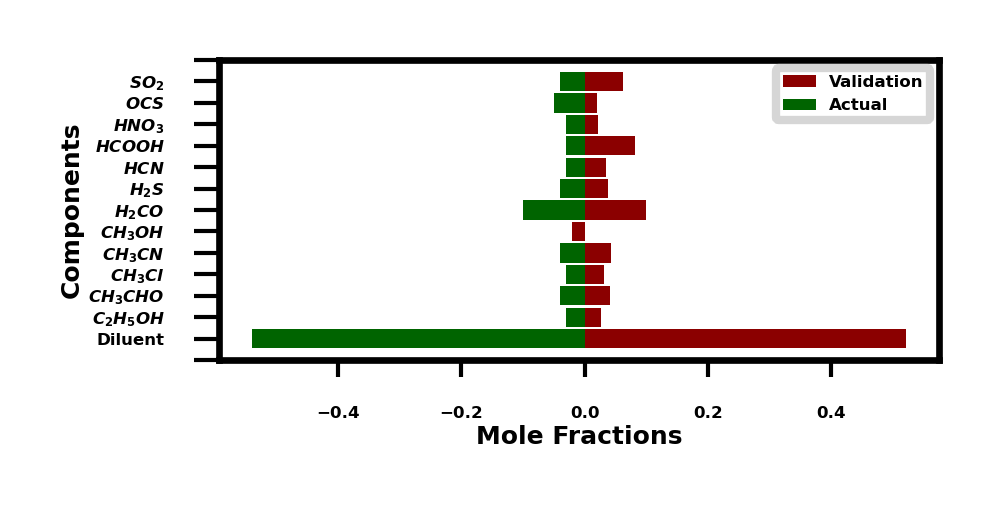

<ipython-input-48-93fef6807b01>:281: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


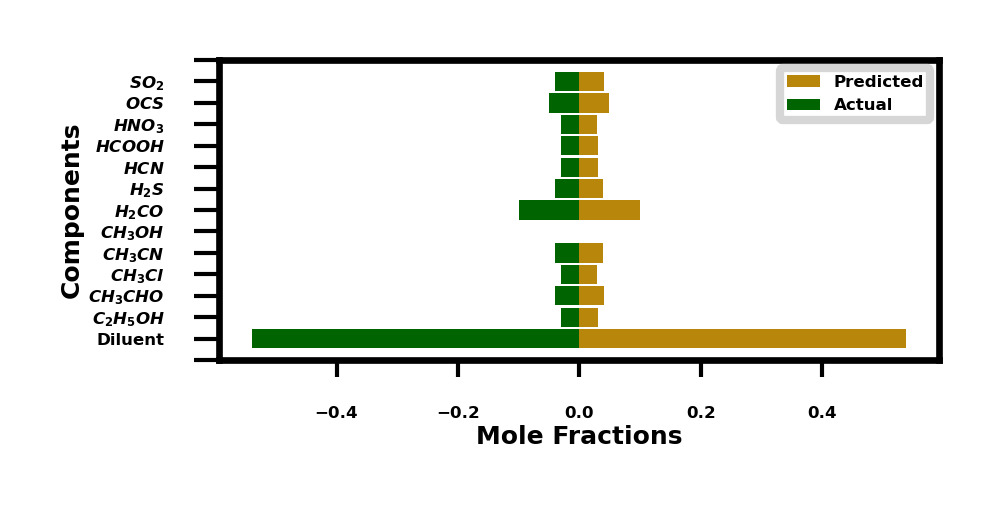

test_mixture2.shape (229, 1)
val_mixture2.shape (229,)
predicted_mixture2_val.shape (229, 1)
     test_mixture2  val_mixture2  predicted_mixture2  predicted_mixture2_val
0         0.005048      0.007225            0.004991                0.005229
1         0.006789      0.003460            0.006713                0.007174
2         0.000598      0.000443            0.000592                0.000620
3         0.000313      0.003013            0.000311                0.000360
4         0.000199      0.001872            0.000198                0.000194
..             ...           ...                 ...                     ...
224       0.005136      0.005404            0.005164                0.005268
225       0.009561      0.010443            0.009585                0.008431
226       0.001847      0.000520            0.001858                0.001785
227       0.001286      0.002077            0.001297                0.001197
228       0.000468     -0.000489            0.000470        

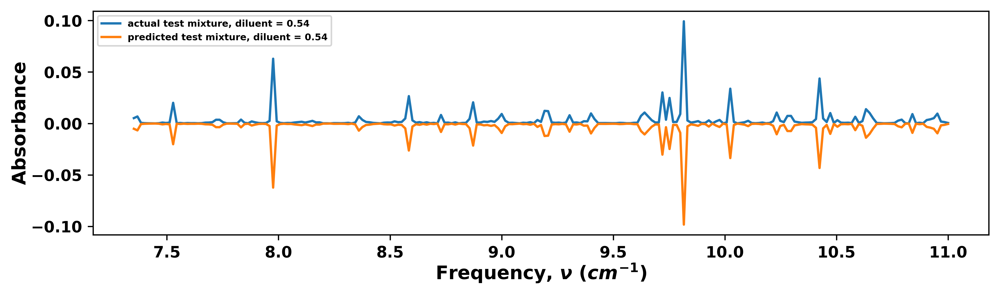

Noise added mixture (validation) concentrations: [0.03 0.04 0.03 0.04 0.04 0.06 0.04 0.03 0.03 0.03 0.05 0.04]
Predicted Noise added mixture (validation) concentrations: [[0.06207868 0.02664106 0.0280515  0.04328037 0.00069452 0.06556938
  0.03648738 0.02710213 0.00935664 0.02583171 0.09698178 0.05185318]]
Predicted Noise added mixture (validation) concentrations sum : 0.47392833


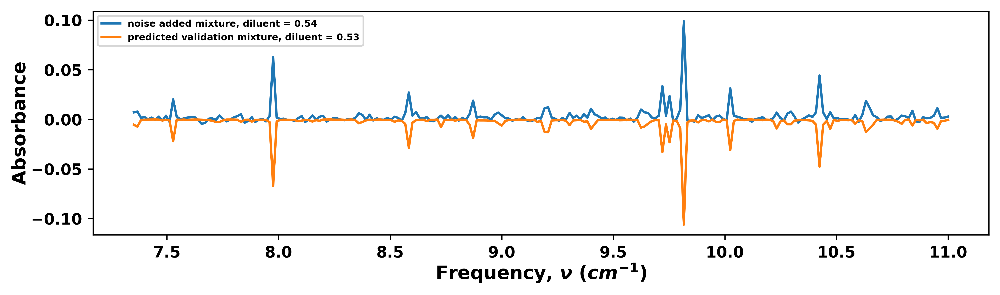

Noise added mixture (validation) concentrations: [0.03 0.04 0.03 0.04 0.04 0.06 0.04 0.03 0.03 0.03 0.05 0.04]
Predicted Noise added mixture (validation) concentrations: [[0.06207868 0.02664106 0.0280515  0.04328037 0.00069452 0.06556938
  0.03648738 0.02710213 0.00935664 0.02583171 0.09698178 0.05185318]]
Predicted Noise added mixture (validation) concentrations sum : 0.47392833


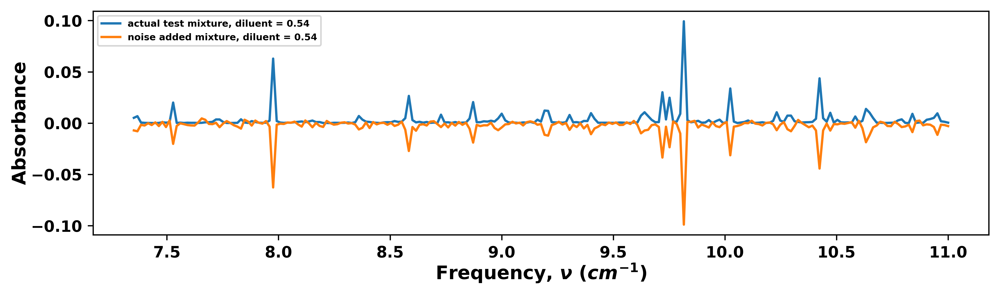

<ipython-input-48-93fef6807b01>:178: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_xticklabels(np.delete(labels,0));


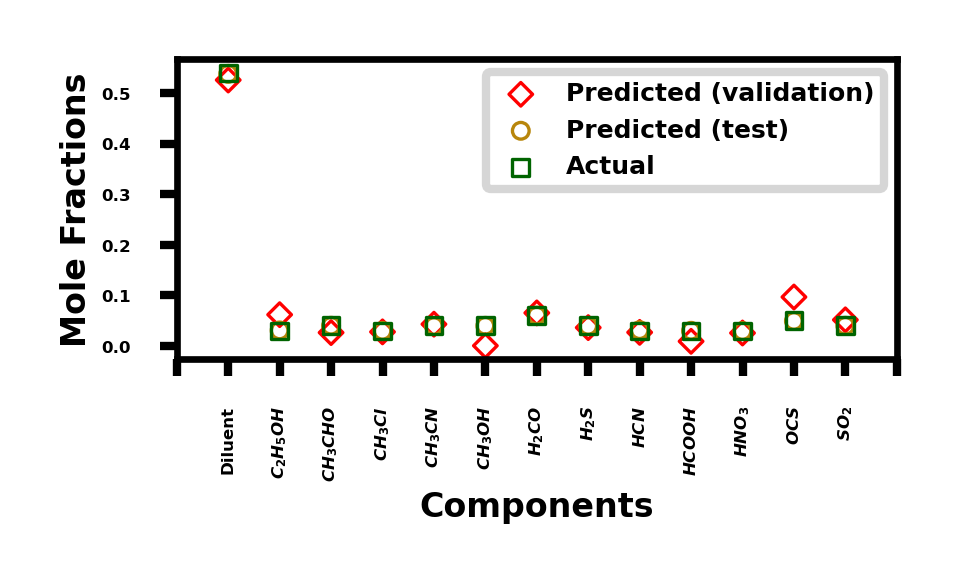

<ipython-input-48-93fef6807b01>:231: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


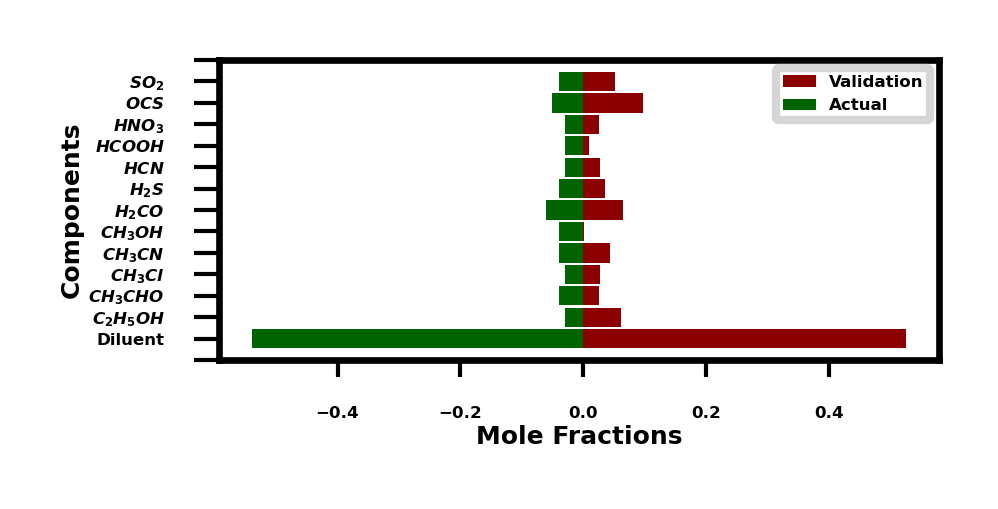

<ipython-input-48-93fef6807b01>:281: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


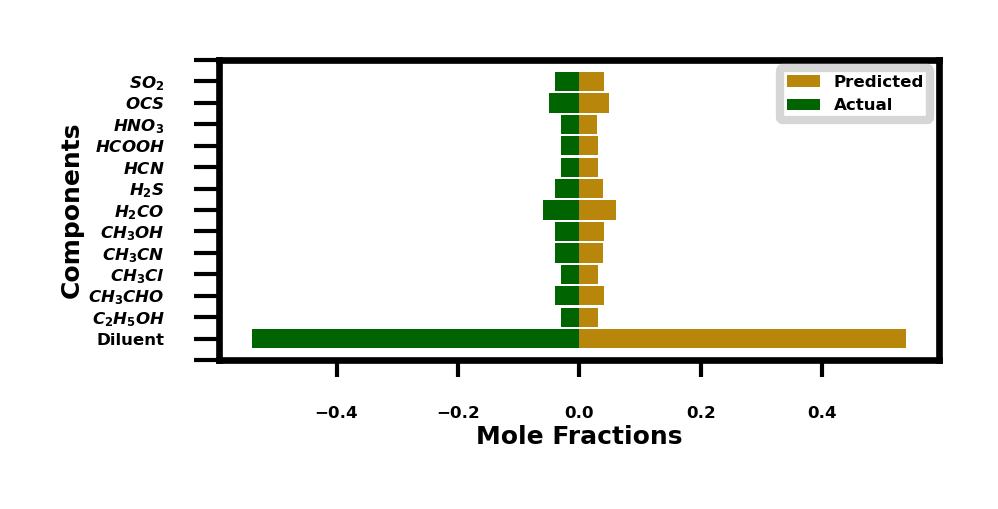

test_mixture2.shape (229, 1)
val_mixture2.shape (229,)
predicted_mixture2_val.shape (229, 1)
     test_mixture2  val_mixture2  predicted_mixture2  predicted_mixture2_val
0         0.005198      0.007088            0.005147                0.005450
1         0.006789      0.007907            0.006722                0.007319
2         0.000598      0.001643            0.000593                0.000664
3         0.000313      0.002293            0.000312                0.000357
4         0.000200      0.000079            0.000198                0.000209
..             ...           ...                 ...                     ...
224       0.005140      0.003677            0.005158                0.003466
225       0.009568      0.011383            0.009581                0.009500
226       0.001848      0.001503            0.001858                0.001661
227       0.001336      0.001865            0.001347                0.001389
228       0.000479      0.002894            0.000480        

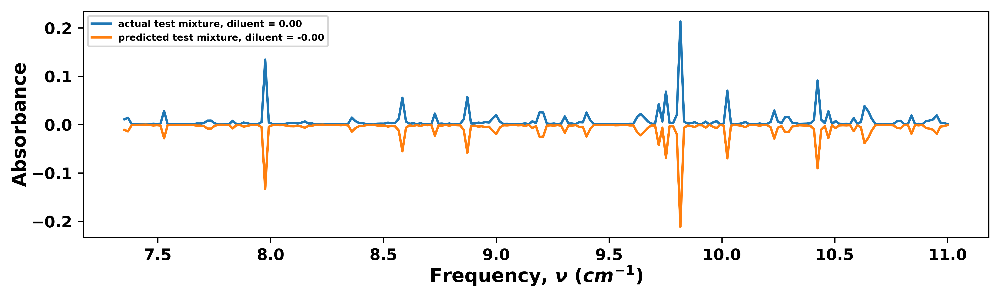

Noise added mixture (validation) concentrations: [0.08333333 0.08333333 0.08333333 0.08333333 0.08333333 0.08333333
 0.08333333 0.08333333 0.08333333 0.08333333 0.08333333 0.08333333]
Predicted Noise added mixture (validation) concentrations: [[ 0.02957338  0.09152284  0.08210258  0.07700013  0.04800577  0.09485821
   0.08900174  0.08958881  0.21662512  0.10335595 -0.08673929  0.03333798]]
Predicted Noise added mixture (validation) concentrations sum : 0.8682332


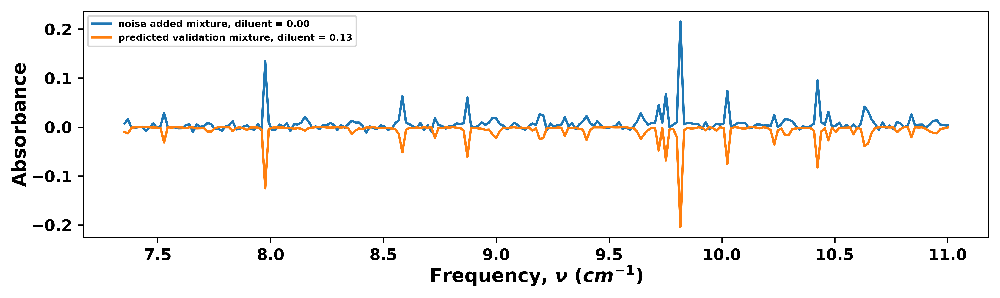

Noise added mixture (validation) concentrations: [0.08333333 0.08333333 0.08333333 0.08333333 0.08333333 0.08333333
 0.08333333 0.08333333 0.08333333 0.08333333 0.08333333 0.08333333]
Predicted Noise added mixture (validation) concentrations: [[ 0.02957338  0.09152284  0.08210258  0.07700013  0.04800577  0.09485821
   0.08900174  0.08958881  0.21662512  0.10335595 -0.08673929  0.03333798]]
Predicted Noise added mixture (validation) concentrations sum : 0.8682332


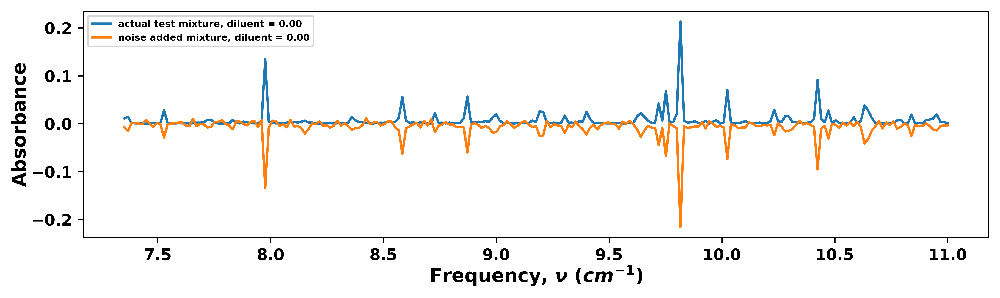

<ipython-input-48-93fef6807b01>:178: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_xticklabels(np.delete(labels,0));


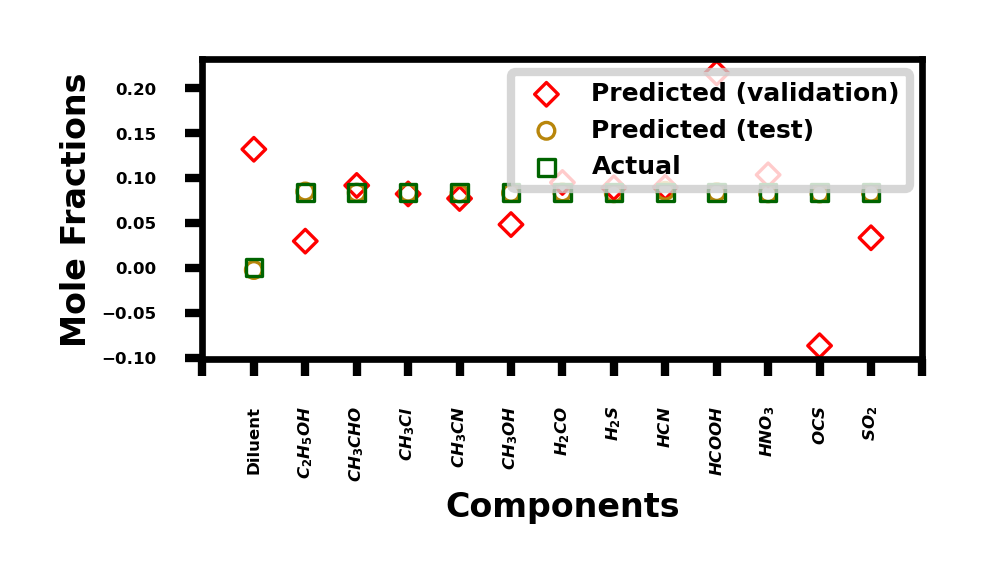

<ipython-input-48-93fef6807b01>:231: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


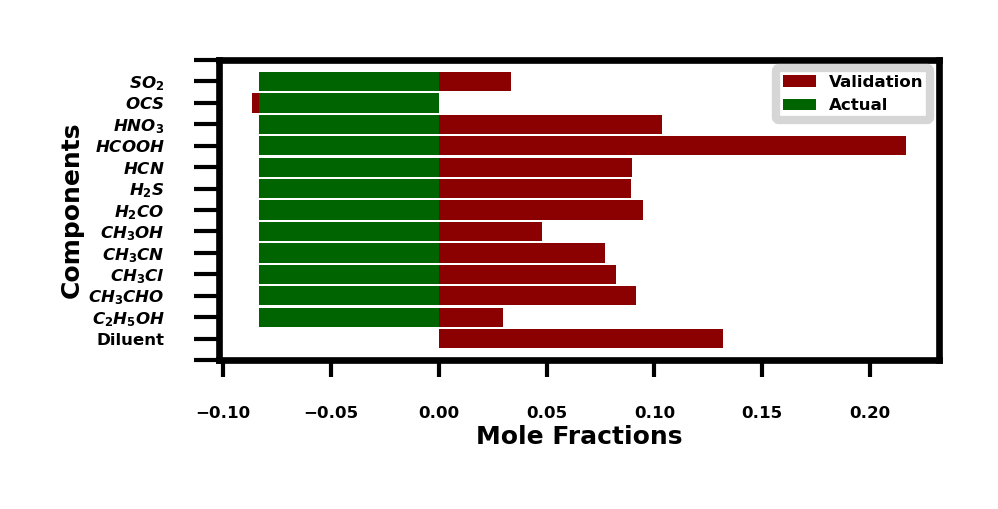

<ipython-input-48-93fef6807b01>:281: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


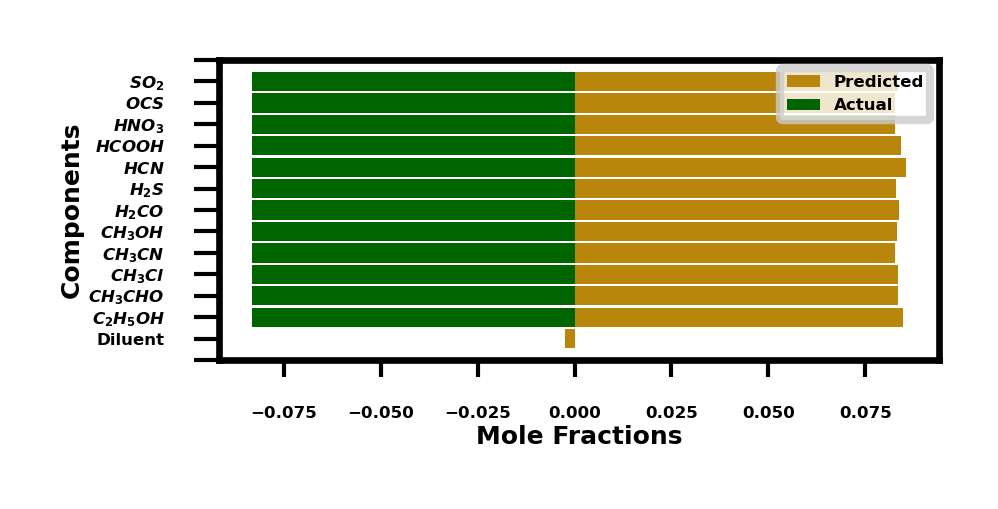

test_mixture2.shape (229, 1)
val_mixture2.shape (229,)
predicted_mixture2_val.shape (229, 1)
     test_mixture2  val_mixture2  predicted_mixture2  predicted_mixture2_val
0         0.010910      0.007062            0.010825                0.010036
1         0.014167      0.015617            0.014054                0.013101
2         0.001287     -0.002135            0.001279                0.001166
3         0.000683     -0.001017            0.000680                0.000551
4         0.000471     -0.000390            0.000469                0.000464
..             ...           ...                 ...                     ...
224       0.010771      0.012130            0.010789                0.011805
225       0.019260      0.014186            0.019263                0.012911
226       0.004205      0.004793            0.004219                0.004147
227       0.003136      0.003781            0.003153                0.002714
228       0.001078      0.003279            0.001080        

In [50]:
# bench(test_c2,test_c2_dilution,"practice", Basis, dfx)

#One-component (pure)

SET_SAME_SNR=15

bench_noise_add(np.array([0.33,0,0,0,0,0,0,0,0,0,0,0]),0.67,"Only_C2H5OH", Basis, dfx,SET_SAME_SNR, linux)
bench_noise_add(np.array([0,0.33,0,0,0,0,0,0,0,0,0,0]),0.67,"Only_CH3CHO", Basis, dfx,SET_SAME_SNR, linux)
bench_noise_add(np.array([0,0,0.33,0,0,0,0,0,0,0,0,0]),0.67,"Only_CH3Cl", Basis, dfx,SET_SAME_SNR, linux)
bench_noise_add(np.array([0,0,0,0.33,0,0,0,0,0,0,0,0]),0.67,"Only_CH3CN", Basis, dfx,SET_SAME_SNR, linux)
bench_noise_add(np.array([0,0,0,0,0.33,0,0,0,0,0,0,0]),0.67,"Only_CH3OH", Basis, dfx,SET_SAME_SNR, linux)
bench_noise_add(np.array([0,0,0,0,0,0.33,0,0,0,0,0,0]),0.67,"Only_H2CO", Basis, dfx,SET_SAME_SNR, linux)
bench_noise_add(np.array([0,0,0,0,0,0,0.33,0,0,0,0,0]),0.67,"Only_H2S", Basis, dfx,SET_SAME_SNR, linux)
bench_noise_add(np.array([0,0,0,0,0,0,0,0.33,0,0,0,0]),0.67,"Only_HCN", Basis, dfx,SET_SAME_SNR, linux)
bench_noise_add(np.array([0,0,0,0,0,0,0,0,0.33,0,0,0]),0.67,"Only_HCOOH", Basis, dfx,SET_SAME_SNR, linux)
bench_noise_add(np.array([0,0,0,0,0,0,0,0,0,0.33,0,0]),0.67,"Only_HNO3", Basis, dfx,SET_SAME_SNR, linux)
bench_noise_add(np.array([0,0,0,0,0,0,0,0,0,0,0.33,0]),0.67,"Only_OCS", Basis, dfx,SET_SAME_SNR, linux)
bench_noise_add(np.array([0,0,0,0,0,0,0,0,0,0,0,0.33]),0.67,"Only_SO2", Basis, dfx,SET_SAME_SNR, linux)

bench_noise_add(np.array([0.13,0,0,0,0,0.07,0,0,0,0,0,0]),0.8,"Two_components", Basis, dfx,SET_SAME_SNR, linux)
bench_noise_add(np.array([0,0,0.04,0,0.06,0,0.16,0,0,0,0,0]),0.74,"Three_components", Basis, dfx,SET_SAME_SNR, linux)
bench_noise_add(np.array([0.06,0,0.09,0,0,0.03,0,0.05,0,0,0,0]),0.67,"Four_components", Basis, dfx,SET_SAME_SNR, linux)
bench_noise_add(np.array([0,0.04,0.07,0,0.1,0.07,0,0,0,0,0.05,0]),0.67,"Five_components", Basis, dfx,SET_SAME_SNR, linux)
bench_noise_add(np.array([0.04,0.07,0,0,0.1,0,0.08,0,0.06,0,0.07,0]),0.58,"Six_components", Basis, dfx,SET_SAME_SNR, linux)
bench_noise_add(np.array([0.04,0.07,0,0,0,0.1,0.08,0.03,0.06,0,0.07,0]),0.55,"Seven_components", Basis, dfx,SET_SAME_SNR, linux)
bench_noise_add(np.array([0.04,0.07,0.03,0,0,0.1,0.08,0.03,0.06,0,0.07,0]),0.52,"Eight_components", Basis, dfx,SET_SAME_SNR, linux)
bench_noise_add(np.array([0.03,0.04,0.03,0.04,0,0.1,0.08,0.03,0.06,0,0.07,0]),0.52,"Nine_components", Basis, dfx,SET_SAME_SNR, linux)
bench_noise_add(np.array([0.03,0.04,0.03,0.04,0,0.1,0.04,0.03,0.06,0,0.05,0.04]),0.54,"Ten_components", Basis, dfx,SET_SAME_SNR, linux)
bench_noise_add(np.array([0.03,0.04,0.03,0.04,0,0.1,0.04,0.03,0.03,0.03,0.05,0.04]),0.54,"Eleven_components", Basis, dfx,SET_SAME_SNR, linux)
bench_noise_add(np.array([0.03,0.04,0.03,0.04,0.04,0.06,0.04,0.03,0.03,0.03,0.05,0.04]),0.54,"Twelve_components", Basis, dfx,SET_SAME_SNR, linux)
bench_noise_add(np.array([1/12,
            1/12,
            1/12,
            1/12,
            1/12,
            1/12,
            1/12,
            1/12,
            1/12,
            1/12,
            1/12,
            1/12
           ]),0,"Twelve__equal_components", Basis, dfx,SET_SAME_SNR, linux)




In [ ]:
# import multiprocessing

# def dumb():
#     print('dumb')
#     return None

# # p1 = multiprocessing.Process(target = bench_noise_add, args=((np.array([0,0,0,0,0,0,0,0,0.33,0,0,0]),0.67,"Only_HCOOH_2", Basis, dfx, 100),))
# # p2 = multiprocessing.Process(target = bench_noise_add, args=((np.array([0,0,0,0,0,0,0,0,0.73,0,0,0]),0.27,"Only_HCOOH_3", Basis, dfx, 100),))


# if __name__ == "__main__":
#     p1 = multiprocessing.Process(target = dumb)
#     p2 = multiprocessing.Process(target = dumb)

#     # bench_noise_add(np.array([0,0,0,0,0,0,0,0,0.33,0,0,0]),0.67,"Only_HCOOH_2", Basis, dfx, 100)

#     p1.start()
#     p2.start()
#     # processes are still sleeping

#     p1.join()
#     p2.join()
#     # join means the processes will finish first before interepreter will move to next lines.

# print(multiprocessing.cpu_count())

In [41]:
# In this version add synthetic mixtures use Pure experiment spectra as basis to create these mixtures

if linux == 1:
    #View files
    print("Linux")

    path = r'Experimental_Basis/One Torr' 
    
    
    # Ubuntu


    filename = path + '/C2H5OH.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    dfy= signal.resample(dfy, n_features)
    dfx= signal.resample(dfx, n_features)
    df_exp_C2H5OH=dfy


    # filename = path + '\CH3CHO_JPL_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'


    filename = path + '/CH3CHO.csv'


    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    dfy= signal.resample(dfy, n_features)
    dfx= signal.resample(dfx, n_features)
    df_exp_CH3CHO=dfy

    # filename = path + '\CH3CL_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    filename = path + '/CH3Cl.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    dfy= signal.resample(dfy, n_features)
    dfx= signal.resample(dfx, n_features)
    df_exp_CH3Cl=dfy

    # filename = path + '\CH3CN_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    filename = path + '/CH3CN.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    dfy= signal.resample(dfy, n_features)
    dfx= signal.resample(dfx, n_features)
    df_exp_CH3CN=dfy

    filename = path + '/CH3OH.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    dfy= signal.resample(dfy, n_features)
    dfx= signal.resample(dfx, n_features)
    df_CH3OH=dfy



#     filename = path + '/H2CO_HAPI.csv'

#     df = pd.read_csv(filename, index_col=None, header=0)  
#     df=df.values[discard_rows:]  #removes first 33 rows
#     dfx=df[:,0] #get first column
#     dfy=df[:,1] #get second column
#     dfx=dfx.astype(np.float)
#     dfy=dfy.astype(np.float)
#     dfy= signal.resample(dfy, n_features)
#     dfx= signal.resample(dfx, n_features)
#     df_H2CO=dfy



#     filename = path + '/H2S.csv'

#     df = pd.read_csv(filename, index_col=None, header=0)  
#     df=df.values[discard_rows:]  #removes first 33 rows
#     dfx=df[:,0] #get first column
#     dfy=df[:,1] #get second column
#     dfx=dfx.astype(np.float)
#     dfy=dfy.astype(np.float)
#     dfy= signal.resample(dfy, n_features)
#     dfx= signal.resample(dfx, n_features)
#     df_H2S=dfy



#     filename = path + '/HCN_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

#     df = pd.read_csv(filename, index_col=None, header=0)  
#     df=df.values[discard_rows:]  #removes first 33 rows
#     dfx=df[:,0] #get first column
#     dfy=df[:,1] #get second column
#     dfx=dfx.astype(np.float)
#     dfy=dfy.astype(np.float)
#     dfy= signal.resample(dfy, n_features)
#     dfx= signal.resample(dfx, n_features)
#     df_HCN=dfy



    filename = path + '/HCOOH.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    dfy= signal.resample(dfy, n_features)
    dfx= signal.resample(dfx, n_features)
    df_exp_HCOOH=dfy



#     filename = path + '/HNO3_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

#     df = pd.read_csv(filename, index_col=None, header=0)  
#     df=df.values[discard_rows:]  #removes first 33 rows
#     dfx=df[:,0] #get first column
#     dfy=df[:,1] #get second column
#     dfx=dfx.astype(np.float)
#     dfy=dfy.astype(np.float)
#     dfy= signal.resample(dfy, n_features)
#     dfx= signal.resample(dfx, n_features)
#     df_HNO3=dfy



#     filename = path + '/OCS_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

#     df = pd.read_csv(filename, index_col=None, header=0)  
#     df=df.values[discard_rows:]  #removes first 33 rows
#     dfx=df[:,0] #get first column
#     dfy=df[:,1] #get second column
#     dfx=dfx.astype(np.float)
#     dfy=dfy.astype(np.float)
#     dfy= signal.resample(dfy, n_features)
#     dfx= signal.resample(dfx, n_features)
#     df_OCS=dfy

    # filename = path + '\SO2_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

#     filename = path + '/SO2_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

#     df = pd.read_csv(filename, index_col=None, header=0)  
#     df=df.values[discard_rows:]  #removes first 33 rows
#     dfx=df[:,0] #get first column
#     dfy=df[:,1] #get second column
#     dfx=dfx.astype(np.float)
#     dfy=dfy.astype(np.float)
#     dfy= signal.resample(dfy, n_features)
#     dfx= signal.resample(dfx, n_features)
#     df_SO2=dfy

    
else:
        
    #View files

    path = r'Experimental_Basis\One Torr' 
    
    # Windows


    filename = path + '\C2H5OH.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    dfy= signal.resample(dfy, n_features)
    dfx= signal.resample(dfx, n_features)
    df_exp_C2H5OH=dfy


    # filename = path + '\CH3CHO_JPL_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'


    filename = path + '\CH3CHO.csv'


    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    dfy= signal.resample(dfy, n_features)
    dfx= signal.resample(dfx, n_features)
    df_exp_CH3CHO=dfy

    # filename = path + '\CH3CL_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    filename = path + '\CH3Cl.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    dfy= signal.resample(dfy, n_features)
    dfx= signal.resample(dfx, n_features)
    df_exp_CH3Cl=dfy

    # filename = path + '\CH3CN_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

    filename = path + '\CH3CN.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    dfy= signal.resample(dfy, n_features)
    dfx= signal.resample(dfx, n_features)
    df_exp_CH3CN=dfy

    filename = path + '\CH3OH.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    dfy= signal.resample(dfy, n_features)
    dfx= signal.resample(dfx, n_features)
    df_exp_CH3OH=dfy



#     filename = path + '/H2CO_HAPI.csv'

#     df = pd.read_csv(filename, index_col=None, header=0)  
#     df=df.values[discard_rows:]  #removes first 33 rows
#     dfx=df[:,0] #get first column
#     dfy=df[:,1] #get second column
#     dfx=dfx.astype(np.float)
#     dfy=dfy.astype(np.float)
#     dfy= signal.resample(dfy, n_features)
#     dfx= signal.resample(dfx, n_features)
#     df_H2CO=dfy



#     filename = path + '/H2S.csv'

#     df = pd.read_csv(filename, index_col=None, header=0)  
#     df=df.values[discard_rows:]  #removes first 33 rows
#     dfx=df[:,0] #get first column
#     dfy=df[:,1] #get second column
#     dfx=dfx.astype(np.float)
#     dfy=dfy.astype(np.float)
#     dfy= signal.resample(dfy, n_features)
#     dfx= signal.resample(dfx, n_features)
#     df_H2S=dfy



#     filename = path + '/HCN_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

#     df = pd.read_csv(filename, index_col=None, header=0)  
#     df=df.values[discard_rows:]  #removes first 33 rows
#     dfx=df[:,0] #get first column
#     dfy=df[:,1] #get second column
#     dfx=dfx.astype(np.float)
#     dfy=dfy.astype(np.float)
#     dfy= signal.resample(dfy, n_features)
#     dfx= signal.resample(dfx, n_features)
#     df_HCN=dfy



    filename = path + '\HCOOH.csv'

    df = pd.read_csv(filename, index_col=None, header=0)  
    df=df.values[discard_rows:]  #removes first 33 rows
    dfx=df[:,0] #get first column
    dfy=df[:,1] #get second column
    dfx=dfx.astype(np.float)
    dfy=dfy.astype(np.float)
    dfy= signal.resample(dfy, n_features)
    dfx= signal.resample(dfx, n_features)
    df_exp_HCOOH=dfy



#     filename = path + '/HNO3_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

#     df = pd.read_csv(filename, index_col=None, header=0)  
#     df=df.values[discard_rows:]  #removes first 33 rows
#     dfx=df[:,0] #get first column
#     dfy=df[:,1] #get second column
#     dfx=dfx.astype(np.float)
#     dfy=dfy.astype(np.float)
#     dfy= signal.resample(dfy, n_features)
#     dfx= signal.resample(dfx, n_features)
#     df_HNO3=dfy



#     filename = path + '/OCS_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

#     df = pd.read_csv(filename, index_col=None, header=0)  
#     df=df.values[discard_rows:]  #removes first 33 rows
#     dfx=df[:,0] #get first column
#     dfy=df[:,1] #get second column
#     dfx=dfx.astype(np.float)
#     dfy=dfy.astype(np.float)
#     dfy= signal.resample(dfy, n_features)
#     dfx= signal.resample(dfx, n_features)
#     df_OCS=dfy

    # filename = path + '\SO2_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

#     filename = path + '/SO2_HAPI_P=0.001313,T=296,L=21.59,x=1,step=0.016.csv'

#     df = pd.read_csv(filename, index_col=None, header=0)  
#     df=df.values[discard_rows:]  #removes first 33 rows
#     dfx=df[:,0] #get first column
#     dfy=df[:,1] #get second column
#     dfx=dfx.astype(np.float)
#     dfy=dfy.astype(np.float)
#     dfy= signal.resample(dfy, n_features)
#     dfx= signal.resample(dfx, n_features)
#     df_SO2=dfy

    
    print("Not linux")

    

all_exp_files = glob.glob(path + "/*.csv")

li = []

print(path)

print('\n')
print(all_exp_files)






Not linux
Experimental_Basis\One Torr


['Experimental_Basis\\One Torr\\C2H5OH.csv', 'Experimental_Basis\\One Torr\\CH3CHO.csv', 'Experimental_Basis\\One Torr\\CH3Cl.csv', 'Experimental_Basis\\One Torr\\CH3CN.csv', 'Experimental_Basis\\One Torr\\CH3OH.csv', 'Experimental_Basis\\One Torr\\HCOOH.csv']


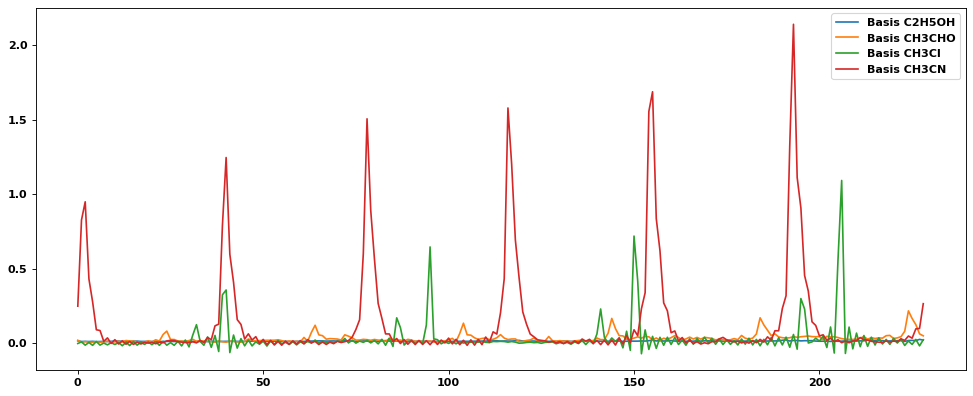

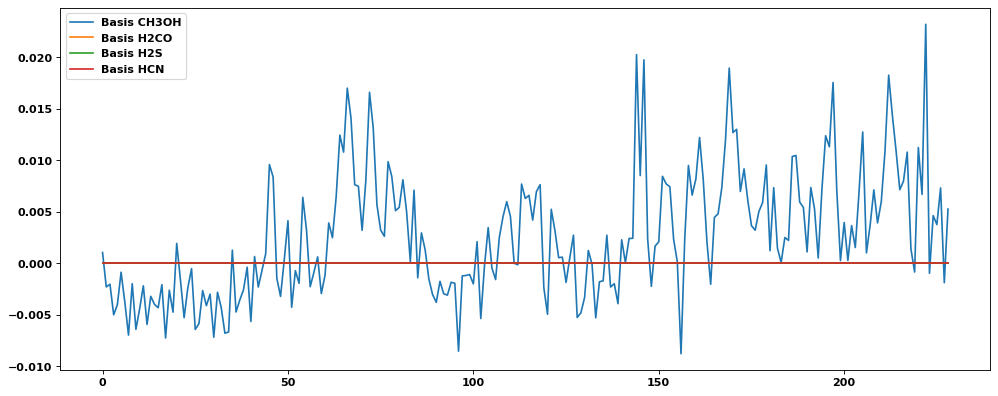

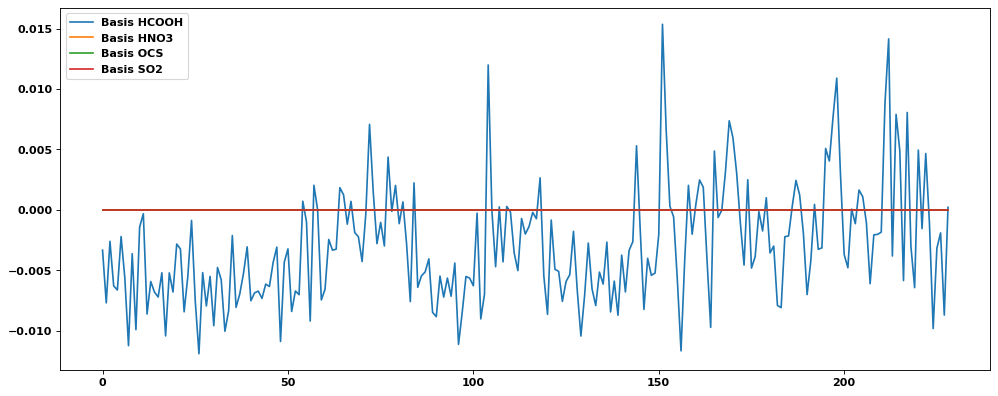

In [43]:
#Some experimental basis are not available so make them zero explicitly (fix it when more data is available)
df_exp_H2CO= 0*df_exp_C2H5OH
df_exp_H2S = 0*df_exp_C2H5OH
df_exp_HCN = 0*df_exp_C2H5OH
df_exp_HNO3 = 0*df_exp_C2H5OH
df_exp_OCS =0*df_exp_C2H5OH
df_exp_SO2 =0*df_exp_C2H5OH

#Create basis vector
exp_Basis = np.array([[df_exp_C2H5OH], 
                  [df_exp_CH3CHO],
                  [df_exp_CH3Cl],
                  [df_exp_CH3CN],
                  [df_exp_CH3OH],
                  [df_exp_H2CO],
                  [df_exp_H2S],
                  [df_exp_HCN],
                  [df_exp_HCOOH],
                  [df_exp_HNO3],
                  [df_exp_OCS],
                  [df_exp_SO2]                  
                 ])

# Visualize experimental basis spectra
figure(num=None, figsize=(15, 6), dpi=80, facecolor='w', edgecolor='k')

plt.plot(df_exp_C2H5OH,label="Basis C2H5OH");
plt.plot(df_exp_CH3CHO,label="Basis CH3CHO");
plt.plot(df_exp_CH3Cl,label="Basis CH3Cl");
plt.plot(df_exp_CH3CN,label="Basis CH3CN");
plt.legend();

figure(num=None, figsize=(15, 6), dpi=80, facecolor='w', edgecolor='k')
plt.plot(df_exp_CH3OH,label="Basis CH3OH");
plt.plot(df_exp_H2CO,label="Basis H2CO");
plt.plot(df_exp_H2S,label="Basis H2S");
plt.plot(df_exp_HCN,label="Basis HCN");
plt.legend();

figure(num=None, figsize=(15, 6), dpi=80, facecolor='w', edgecolor='k')
plt.plot(df_exp_HCOOH,label="Basis HCOOH");
plt.plot(df_exp_HNO3,label="Basis HNO3");
plt.plot(df_exp_OCS,label="Basis OCS");
plt.plot(df_exp_SO2,label="Basis SO2");
plt.legend();

x_volts.shape (229, 1)
x_volts.shape (229,)
noise_volts.shape (229,)
noise_volts.shape (229,)
y_volts.shape (229,)
val_mixture2.shape (229,)
Test concentrations: [0.19 0.   0.   0.19 0.   0.   0.   0.   0.   0.   0.   0.  ]
Predicted concentrations: [[ 2.4434822   0.11620693  0.09874737  0.47897875  0.9436145   0.14769748
   0.02994131 -0.00256329  0.17034811 -0.00651717  0.03757681  0.32160687]]
Predicted concentrations sum : 4.7791204


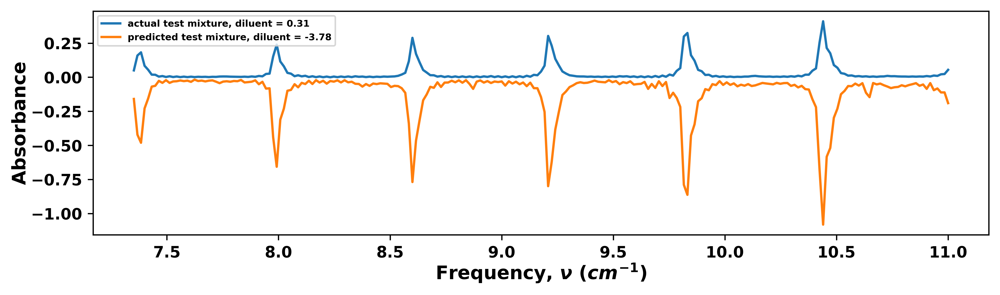

Noise added mixture (validation) concentrations: [0.19 0.   0.   0.19 0.   0.   0.   0.   0.   0.   0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 2.3827612   0.12015107  0.10204427  0.48045623  0.9280758   0.14863408
   0.03606824  0.00249469  0.15308334 -0.00710848 -0.03903648  0.31596836]]
Predicted Noise added mixture (validation) concentrations sum : 4.6235924


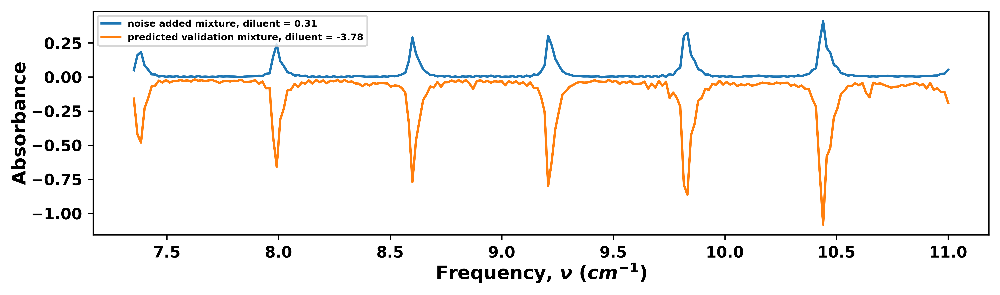

Noise added mixture (validation) concentrations: [0.19 0.   0.   0.19 0.   0.   0.   0.   0.   0.   0.   0.  ]
Predicted Noise added mixture (validation) concentrations: [[ 2.3827612   0.12015107  0.10204427  0.48045623  0.9280758   0.14863408
   0.03606824  0.00249469  0.15308334 -0.00710848 -0.03903648  0.31596836]]
Predicted Noise added mixture (validation) concentrations sum : 4.6235924


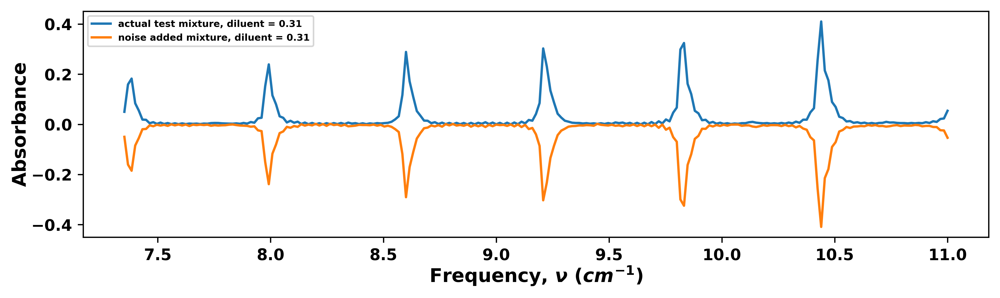

<ipython-input-36-bc06147c79d5>:178: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_xticklabels(np.delete(labels,0));


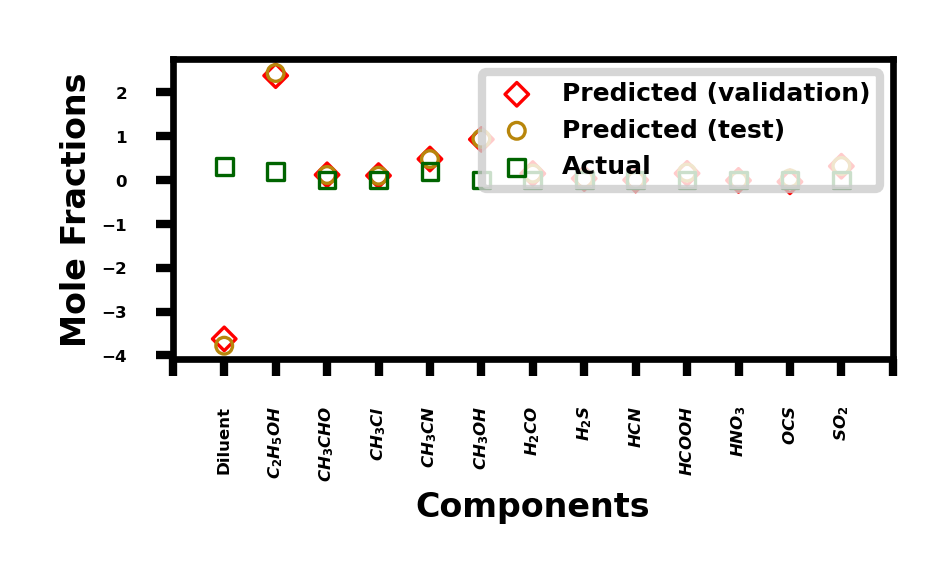

<ipython-input-36-bc06147c79d5>:231: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


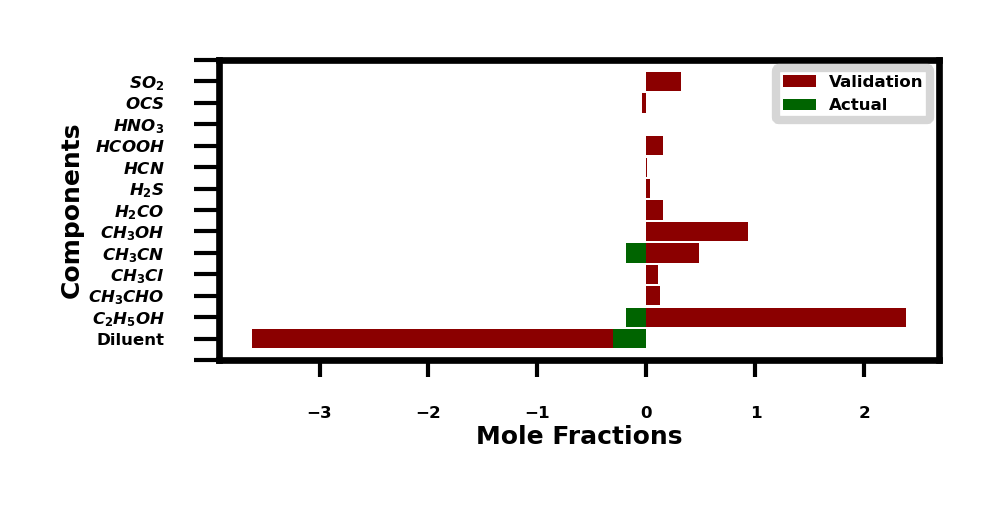

<ipython-input-36-bc06147c79d5>:281: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax_comparison.set_yticklabels(labels);


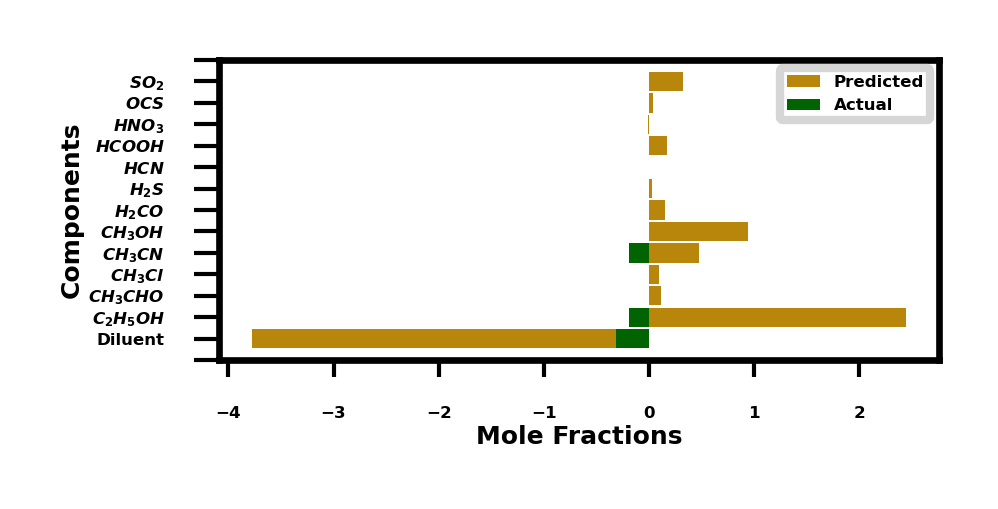

0.5661617
test_mixture2.shape (229, 1)
val_mixture2.shape (229,)
predicted_mixture2_val.shape (229, 1)
     test_mixture2  val_mixture2  predicted_mixture2  predicted_mixture2_val
0         0.050086      0.049656            0.159212                0.158745
1         0.159274      0.160413            0.421216                0.421986
2         0.182535      0.184802            0.480444                0.481216
3         0.084003      0.084316            0.228390                0.228596
4         0.054850      0.054507            0.156324                0.156153
..             ...           ...                 ...                     ...
224       0.012414      0.010390            0.094940                0.094949
225       0.009829      0.010747            0.082438                0.081987
226       0.021469      0.023315            0.111374                0.110964
227       0.023588      0.024299            0.111336                0.110310
228       0.054238      0.053446            0.1899

In [49]:
bench_noise_add(np.array([0.19,0,0,0.19,0,0,0,0,0,0,0,0]),0.31,"exp_CH3Cl_C2H5OH", exp_Basis, wavenumbers, 100, linux)